In [36]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import Voronoi, voronoi_plot_2d

En primera instancia se genera el código con el que se simulará la ciudad multinúcleo. Para ello, se utilizará una región determinada por el cuadrado: $[-100,100]^2$. En dicha zona se tendrán "comunas" centradas en las esquinas del cuadrado $[-40,40]^2$, en las que cada punto representa una casa, además habrá una distribución uniforme de casas esparcida en el cuadrado inicial, de forma de tener una especie de "casas de ruido" que no tienen porque pertenecer estrictamente a las comunas. Como el modelo de ciudad ocupado es el multinúcleo, se debe tener que cada "comuna" tenga en su centro puntos de interés (servicios o trabajos) y al mismo tiempo, en el centro de todo el esquema se acumulen aún más puntos de interés.

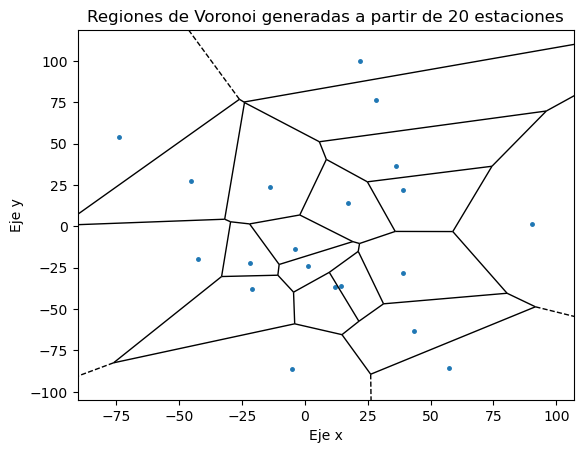

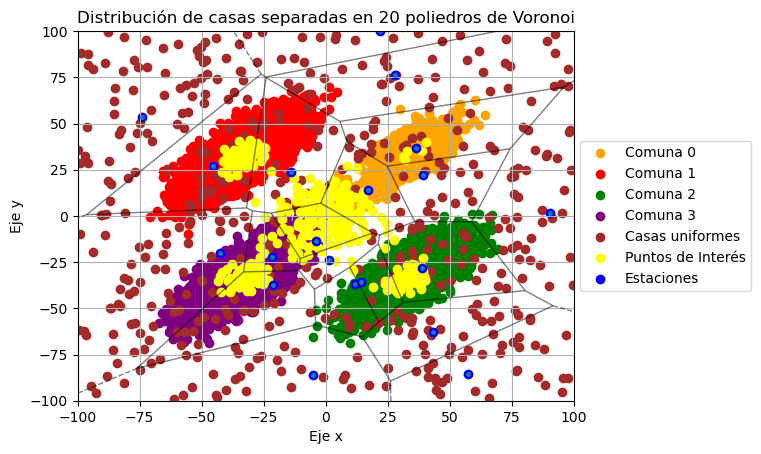

In [37]:
def inicializar_estaciones(N, xlim=100, ylim=100): #Esta función se diseña para distribuir las estaciones iniciales y
    #generar las regiones voronoi correspondientes
    angulo = 2 * np.pi / N
    coordenadas_x = [np.cos(i * angulo) for i in range(N)]
    coordenadas_y = [np.sin(i * angulo) for i in range(N)] #Se inician a partir de un polígono de N lados
    p = np.random.normal(0, 40, 2 * N) #Y luego se desplazarán siguiendo una normal(0,40).

    points = []
    
    for i in range(N):
        x_coord = coordenadas_x[i] + p[i] #Desplazamos la primera coordenada según dicha normal,
        y_coord = coordenadas_y[i] + p[N + i] #Y la segunda.

        # Ajustamos las coordenadas para que estén dentro del cuadrado:
        x_coord = max(min(x_coord, xlim), -xlim)
        y_coord = max(min(y_coord, ylim), -ylim)

        points.append([x_coord, y_coord]) #Se agregan los puntos.

    points = np.array(points)
    return points



N = 20

def inicializar_personas(mu,sig,n): #Cada comuna (conjunto de casas) se genera mediante una normal
  ciud = np.random.multivariate_normal(mu,sig,n) #multivariada.
  return ciud

def generar_comunas(xlim = 100,ylim = 100): #Esta función generará las comunas y sus respectivos puntos de interes.
    
  ciud_tot = []
  mus = [[xlim/3,ylim/3],[-xlim/3,ylim/3],[xlim/3,-ylim/3],[-xlim/3,-ylim/3]] #Los mus son de forma que las ciudades
  sig = [[xlim,3/4 * xlim],[3/4 * ylim, ylim]] #estén centradas en las esquinas de un cuadrado contenido en el inicial.
  sig_interes = [[xlim*0.2,xlim*0.1],[ylim*0.1,ylim*0.2]] #Parámetros para los puntos de interés.
  puntos_de_interes = []

  for j in range(4):
    numero = np.random.randint(100,10000) #El número de casas que tendrá cada comuna es aleatorio.
    numero = int(numero)
    numerointeres = int(np.floor(numero/100)) #El número de puntos de interés fue creado de forma de ser menor a las casas.
    ciud = inicializar_personas(mus[j],sig,numero)
    ciud_tot.append(ciud)
    interes = inicializar_personas(mus[j],sig_interes,numerointeres)
    puntos_de_interes.append(interes)
    
  interes = inicializar_personas([0,0],[[xlim,xlim*0.1],[ylim*0.1,ylim]],200) #Los puntos de interés centrales.
  puntos_de_interes.append(interes)
  x_5 = np.random.uniform(-100,100,500)
  y_5 = np.random.uniform(-100,100,500)
  ciud_5_ruido = np.array([[x_5[i],y_5[i]] for i in range(len(x_5))]) #Las casas distribuidas uniformemente.
  ciud_tot.append(ciud_5_ruido)
    
  return ciud_tot,puntos_de_interes


ciud_tot,puntos_de_interes = generar_comunas()

est = inicializar_estaciones(N)

vor = Voronoi(est) #Esto generará los diagramas de Voronoi.
fig = voronoi_plot_2d(vor,show_vertices=False,point_size=5)
plt.title(f'Regiones de Voronoi generadas a partir de {N} estaciones')
plt.xlabel('Eje x')
plt.ylabel('Eje y')

def graficar_todo(vor, ciud_tot, puntos_de_interes):
    est = vor.points
    fig, ax = plt.subplots()

    colores_ciudades = ['orange', 'red', 'green', 'purple', 'brown'] #Se busca que las comunas sean de estos colores.

    for i in range(len(ciud_tot)):
        ciud = ciud_tot[i]
        if i == len(ciud_tot) - 1:
            ax.scatter(ciud[:, 0], ciud[:, 1], color='brown', label='Casas uniformes')
        else:
            ax.scatter(ciud[:, 0], ciud[:, 1], color=colores_ciudades[i], label=f'Comuna {i}') #Se grafican las comunas.

    for j in range(len(puntos_de_interes)): #Se grafican los puntos de interés.
        interes = puntos_de_interes[j]
        if j == len(puntos_de_interes) - 1:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow', label='Puntos de Interés')
        else:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow')

    ax.scatter(est[:, 0], est[:, 1], color='blue', label='Estaciones') #Se grafican las estaciones.

    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='black', line_width=1, line_alpha=0.5, point_size=5) 
    #Se grafican las regiones de voronoi.

    plt.xlim(-100, 100)
    plt.ylim(-100, 100)
    plt.grid(True)

    lgd = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.title(f'Distribución de casas separadas en {N} poliedros de Voronoi')
    plt.xlabel('Eje x')
    plt.ylabel('Eje y')
    plt.show()

graficar_todo(vor, ciud_tot, puntos_de_interes)

Tras esto, se crea una función que calcule las áreas de las regiones de voronoi, lo que será importante para calcular la función objetivo. Aca es importante tener en cuenta que una región de voronoi debe estar determinada por al menos 3 "esquinas" para tener un área distinta de 0.

In [38]:
def areaf(vor, index): #Tomaremos el conjunto de voronois y un índice en particular que representa la región
    #a la cual le calcularemos el área.

    region_vertices = vor.regions[index]

    region_vertices = [idx for idx in region_vertices if idx >= 0 and idx < len(vor.vertices)] #Filtramos los índices
    #para que estén dentro del rango de los vértices del voronoi.
    region_vertices = list(set(region_vertices))  #eliminamos los duplicados.

    region_coordinates = vor.vertices[region_vertices] #Obtenemos las coordenadas de los vértices.

    if len(region_coordinates) < 3: #Si los vértices son menores a 3 el área es 0.
        return 0

    area = 0.5 * np.abs(np.dot(region_coordinates[:, 0], np.roll(region_coordinates[:, 1], 1)) -
                       np.dot(region_coordinates[:, 1], np.roll(region_coordinates[:, 0], 1))) #Si no, calculamos el área

    return area


Se definen las funciones anteobjetivo1 y anteobjetivo2, además de la función objetivo:


$\sum_{i=1}^{n} \frac{10 \cdot n_{\text{casas}}_i+50\cdot n_{\text{interes}}_i}{A_i}$

Donde el índice representa la región de Voronoi $i$, $n_{\text{casas}}$ y $n_{\text{interés}}$ representan el número de casas y de puntos de interés respectivamente.

In [39]:
def anteobjetivo(voronois,ciudades):
  contadores_por_region=[]

  for point_set in ciud_tot: #Exploramos todas las comunas.
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set] #Esto determina
      index=0 #qué puntos pertenecen a alguna región en particular, no se especifíca cuál es cada punto 
        #(sin embargo se hace en orden), pero cada región se repetirá por cada casa que haya en ella.
        
      for region_index in regions: #Explorando regions el region_index indica una casa en dicha región.
          index=region_index
          dato=[10,index] #Utilizamos que cada casa vale 10.
          contadores_por_region.append(dato)
            
  return contadores_por_region

def anteobjetivo2(voronois,puntos_de_interes):
  contadores_por_region=[]

  for  point_set in puntos_de_interes:
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set]
      index=0
        
      for region_index in regions:
          index=region_index
          dato=[50,index] #Es ánalogo al anterior, pero los puntos de interés valen 50.
          contadores_por_region.append(dato)
            
  return contadores_por_region


def objetivo(voronoi, ciudades, puntos_de_interes): #función objetivo.
    
    cont = anteobjetivo(voronoi, ciudades)
    cont_interes = anteobjetivo2(voronoi,puntos_de_interes) #Se obtienen los datos de las funciones anteriores.
    valores = []
    
    for i, region in enumerate(voronoi.regions):
        area = areaf(voronoi, i) #Calculamos el área de cada región

        if area > 0:  #Verificamos si el área es mayor que cero para evitar divisiones por cero
            valores_k = [dato[0] for dato in cont if i == dato[1]] #Por cada región hacemos listas con los respectivos valores
            valores_interes = [dato[0] for dato in cont_interes if i == dato[1]] #que tendrá en su interior.
            valor_final = sum(valores_k) / (area)**2 + sum(valores_interes) / (area)**2 #La fórmula de la función objetivo
            #el 10 y el 50 que multiplican fueron considerados antes.
            valores.append(valor_final)

    total = sum(valores) #Se entrega la sumatoria de los valores calculados.
    return total


Ahora, una prueba con la distribución inicial:

In [40]:
print(objetivo(vor,ciud_tot,puntos_de_interes))

4.293396564609249


Se fija la semilla:

In [41]:
#para testear
semilla = 42

Y se procede a utilizar el método de Metropolis-Hastings para obtener la mejor distribución, para ello es importante notar que debemos maximizar la función objetivo y que un nuevo estado se generará de la siguiente forma: consideraremos un punto aleatorio de los que determinan las regiones de Voronoi, luego perturbaremos dicho punto mediante una variable normal de media 0 y varianza 10, teniendo cuidado con que el punto se salga del cuadrado $[-100,100]^2$ o con que dos estaciones queden muy cerca, en ambos casos se deja el punto original sin modificar.

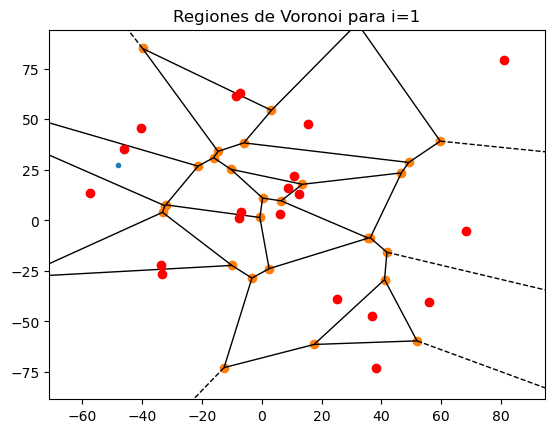

1 0
303.94965602303495 0


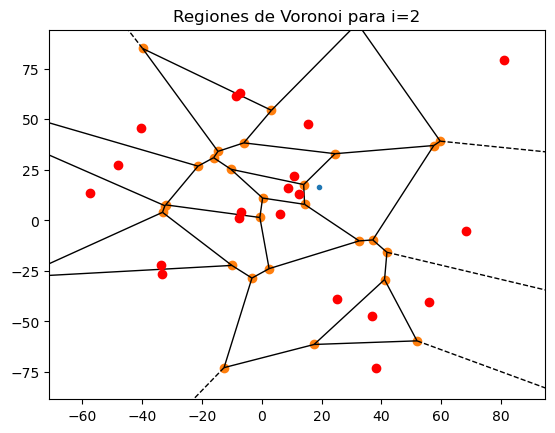

1 1
308.87696239436985 1


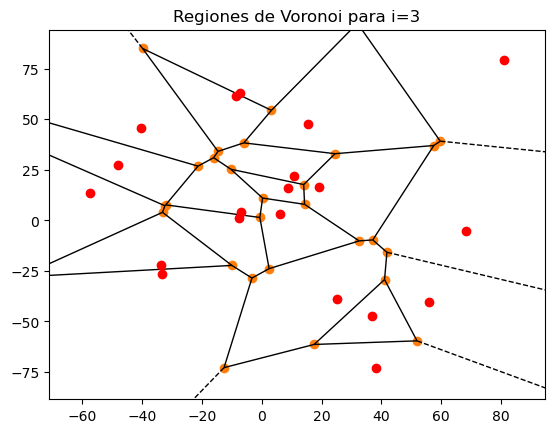

1 2
3585.115639996175 2


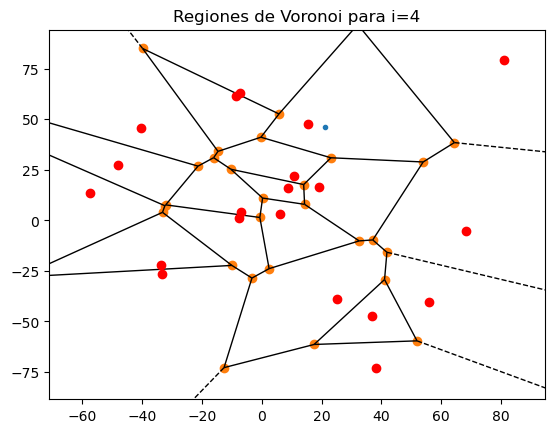

0.1899369541020603 3


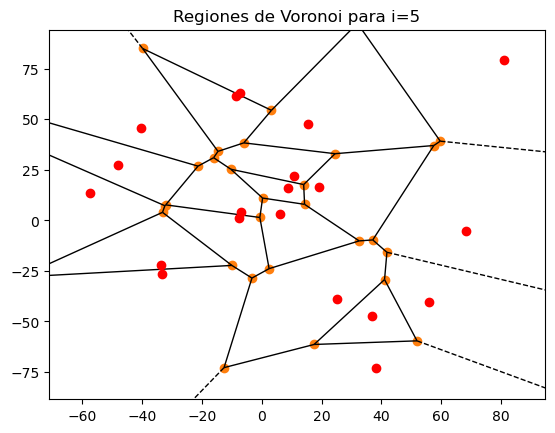

1 4
3585.115639996175 3


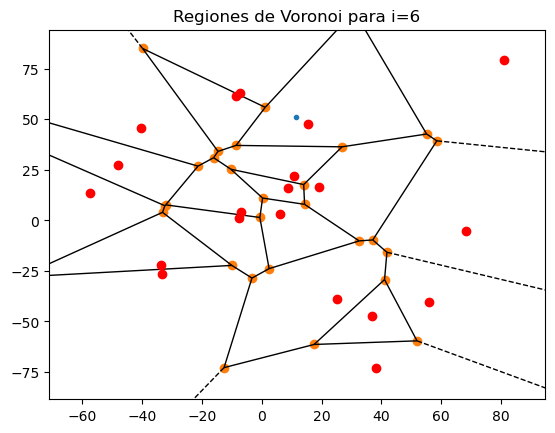

1 5
3585.209197510041 4


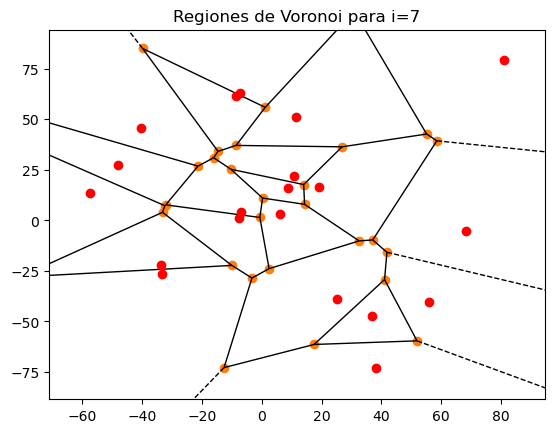

1 6
3585.243248705182 5


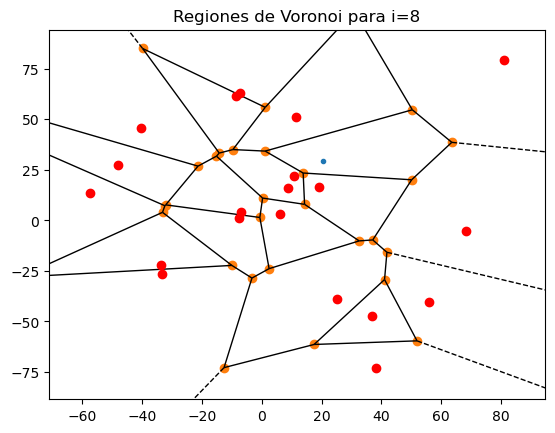

0.01267803665137256 7


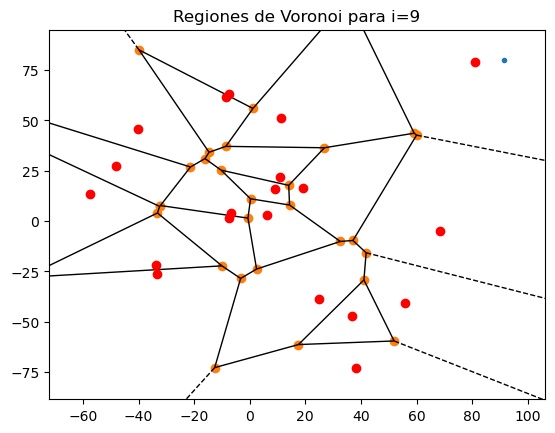

1 8
3586.853727249375 6


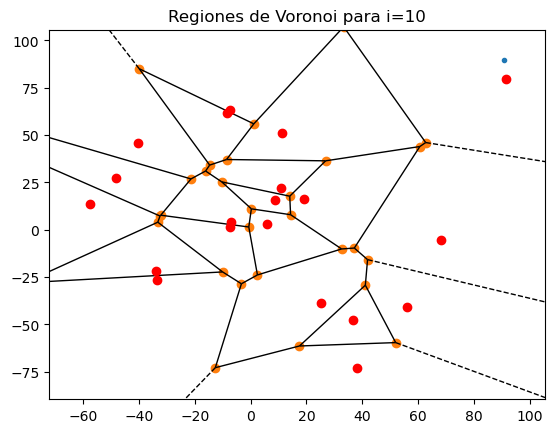

0.18989960792164326 9


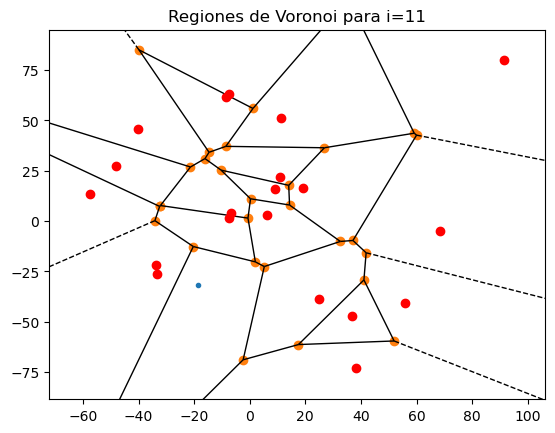

0.01580472396524379 10


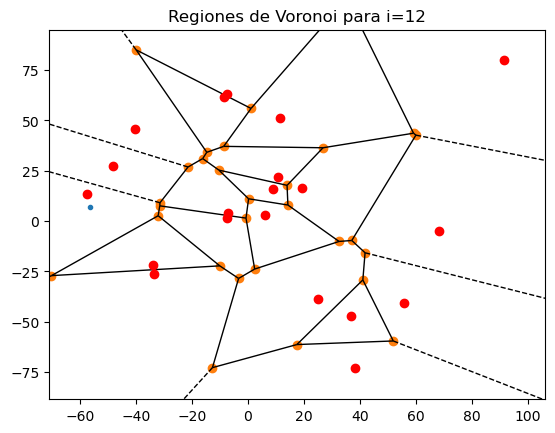

1 11
3603.868239030467 7


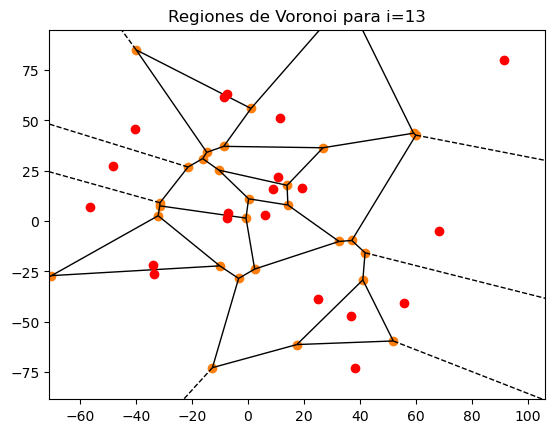

0.9986666644380612 12
3599.063073346826 8


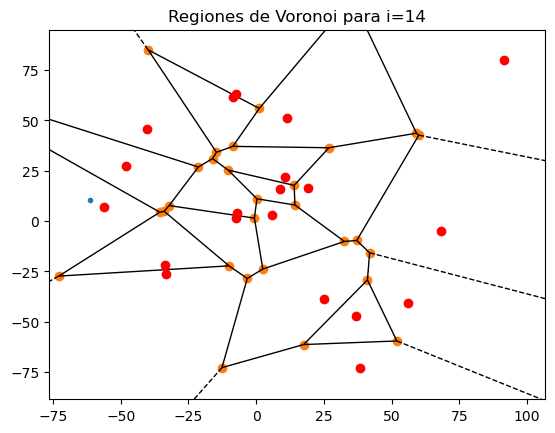

0.9967437725900554 13
3587.343705517275 9


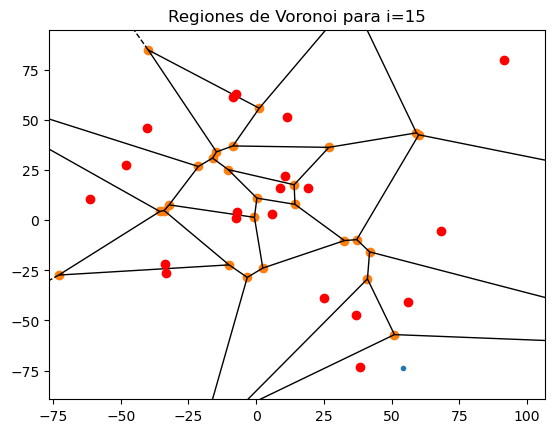

0.0015958900157999943 14


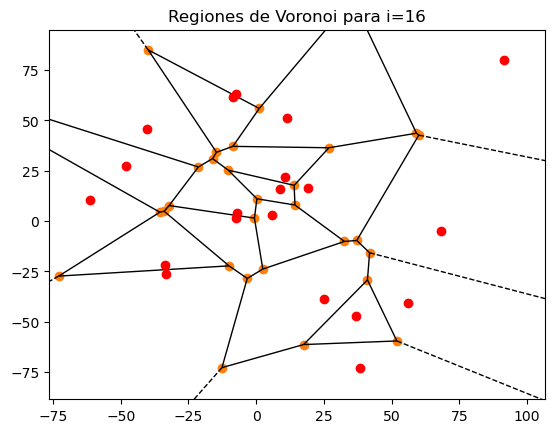

0.9998322481298666 15
3586.741921901863 10


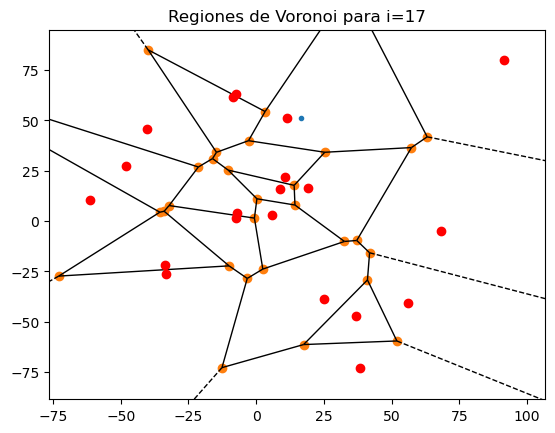

0.18730870475555633 16


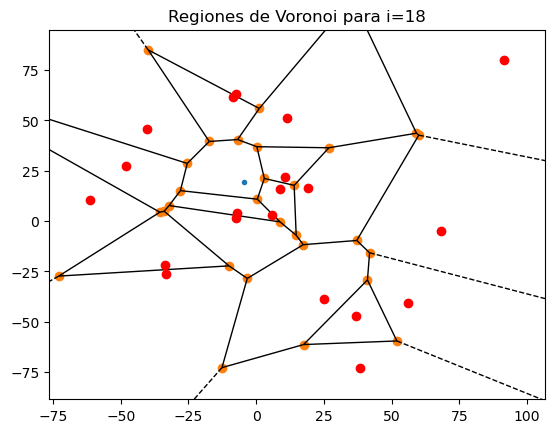

0.07038977719722218 17


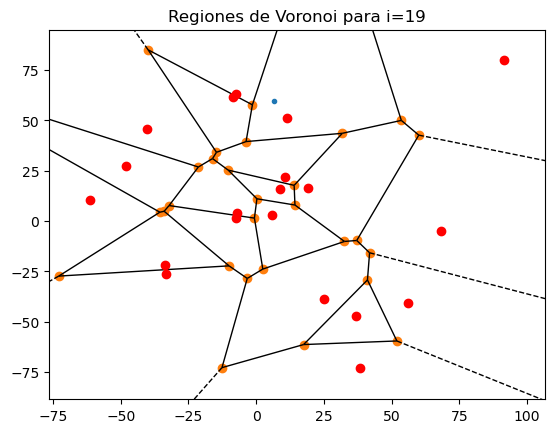

0.1878859192927176 18


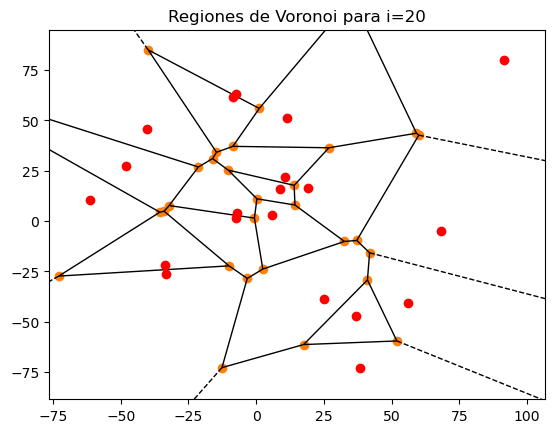

1 19
3586.741921901863 11


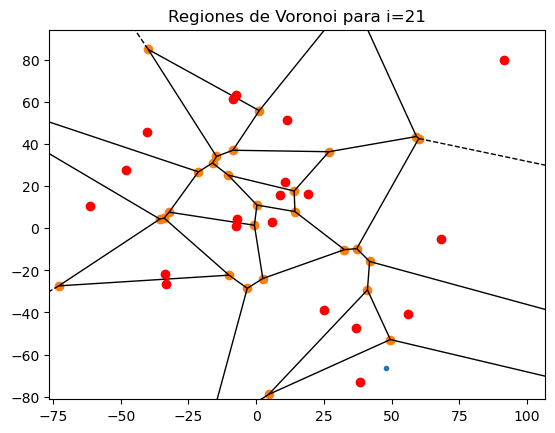

0.025201878834762135 20


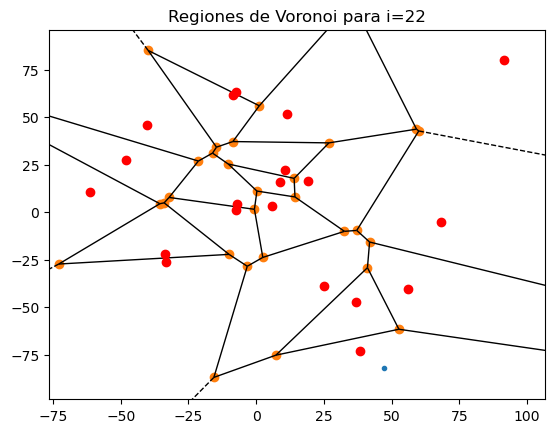

0.0048807514599747935 21


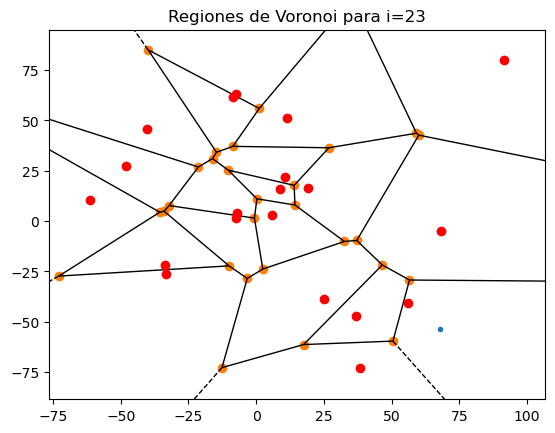

0.001716684105815215 22


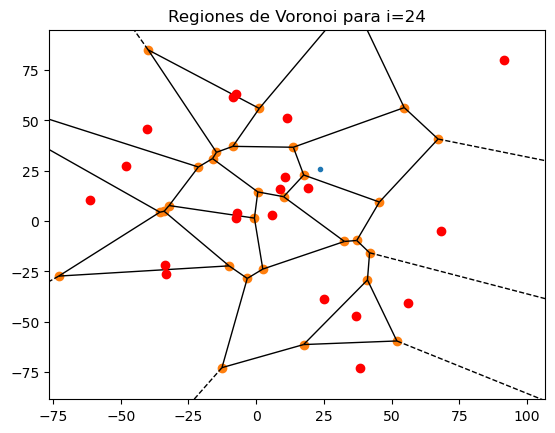

1 23
3719.6851433635998 12


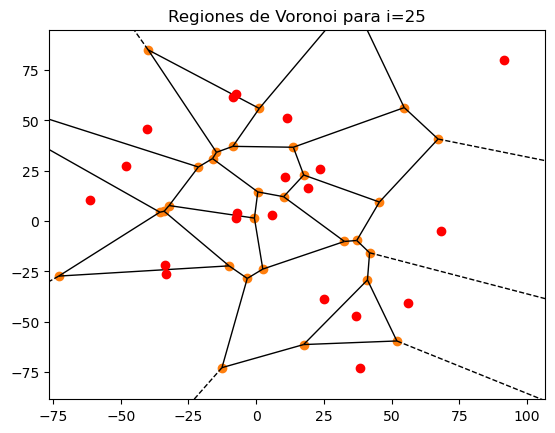

1 24
3719.7071253203167 13


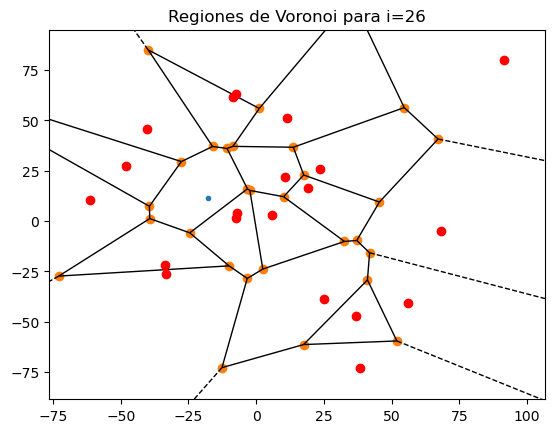

0.8778290127856638 25
3265.266833671733 14


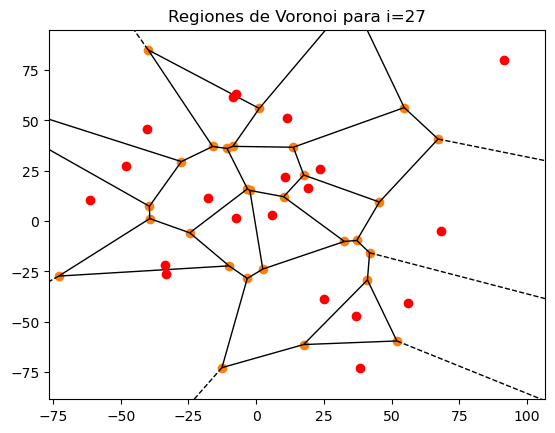

1 26
3590.2636219116894 15


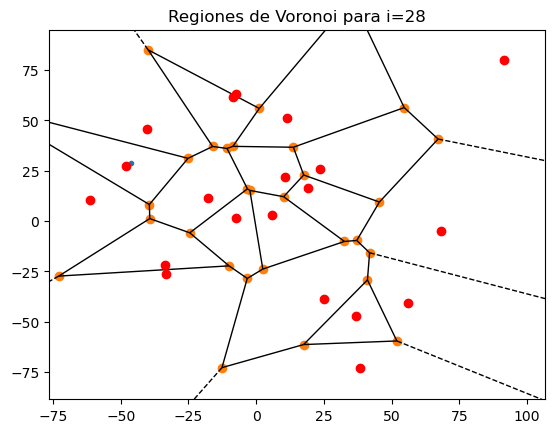

1 27
3604.767703748406 16


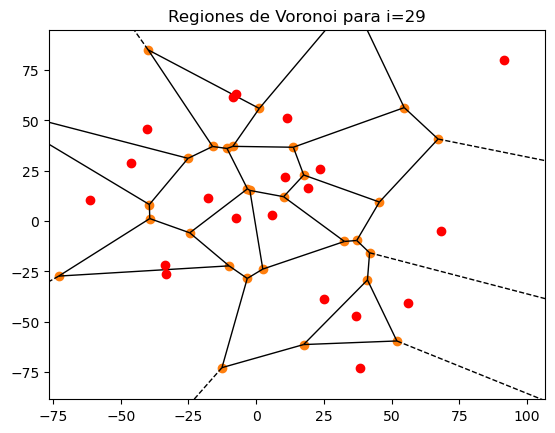

0.999488878378338 28
3602.9252290339514 17


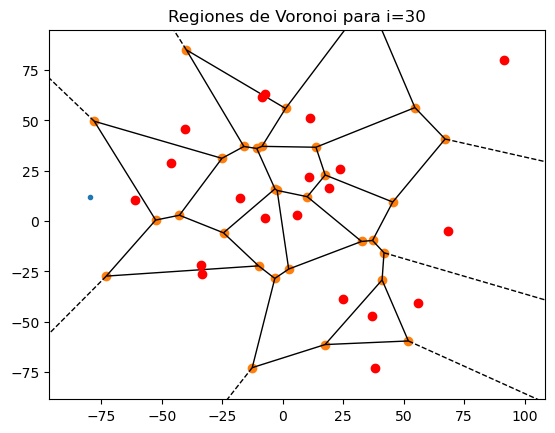

0.007924403286689365 29


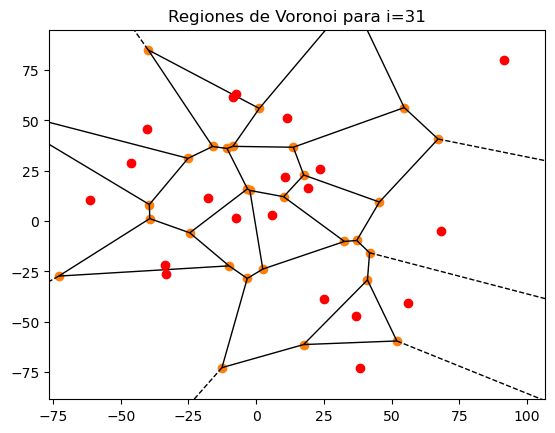

1 30
3602.9252290339514 18


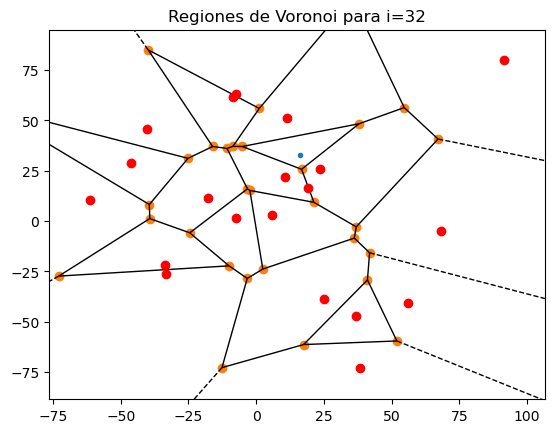

0.002460496644221679 31


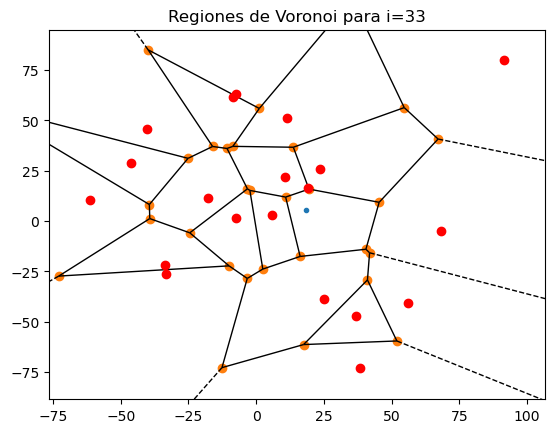

0.009168146395468587 32


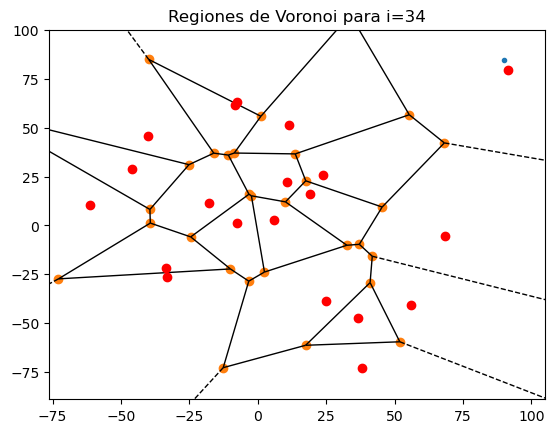

1 33
3649.0337870780645 19


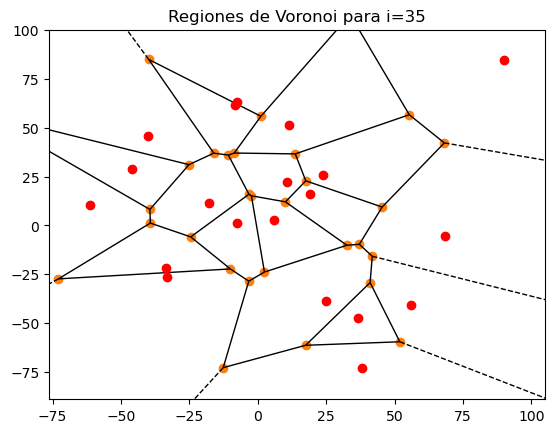

0.9999998217532075 34
3649.033136649496 20


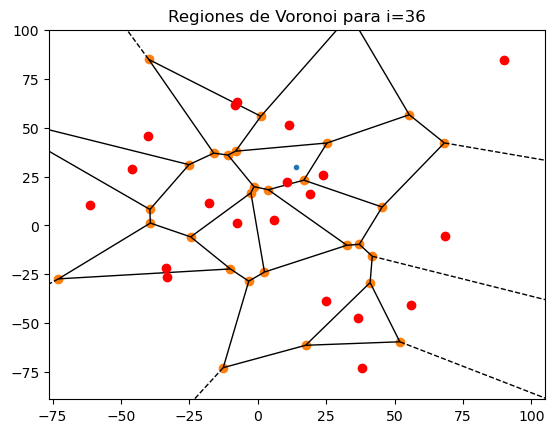

0.9860942732333755 35
3598.2906788888895 21


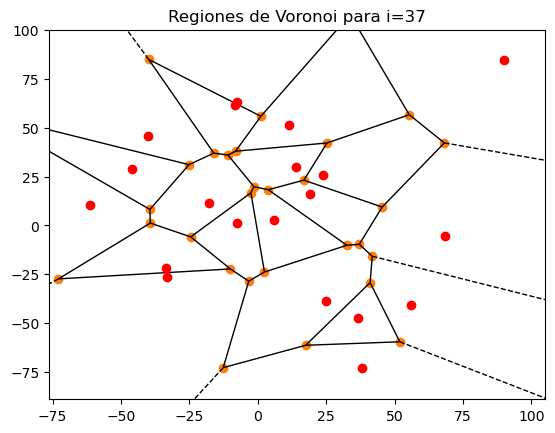

0.9979345937933707 36
3590.858746987456 22


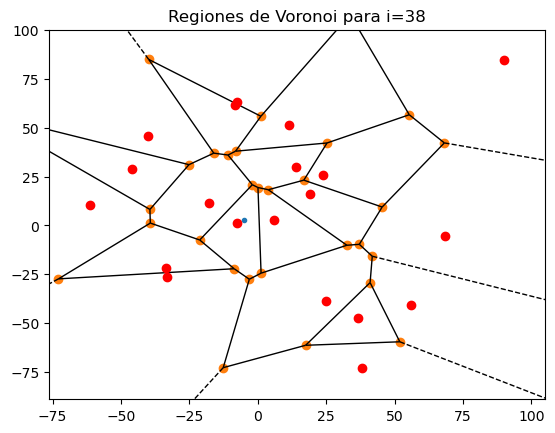

0.049679370906421334 37


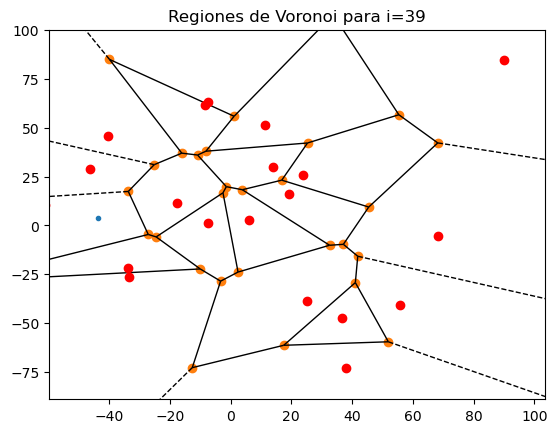

0.1271583286350946 38


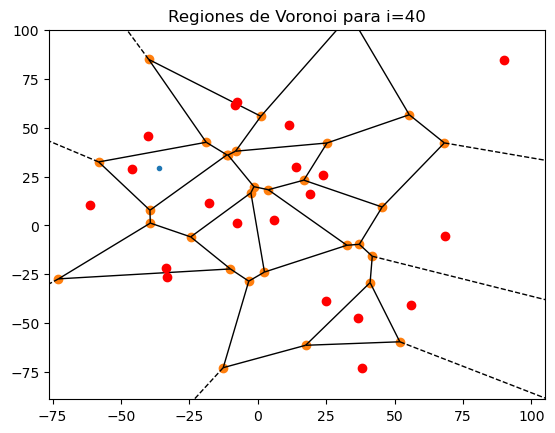

1 39
3594.9855944481296 23


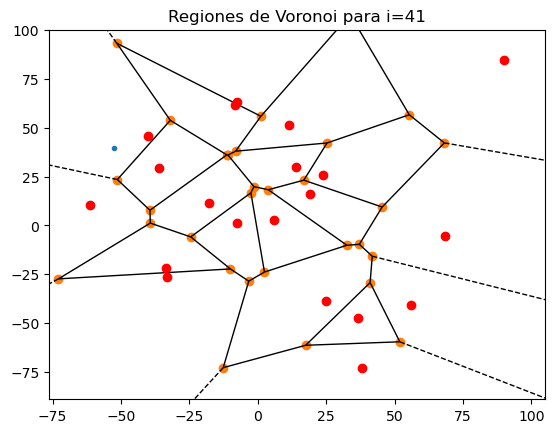

0.9977338269471487 40
3586.8387349686027 24


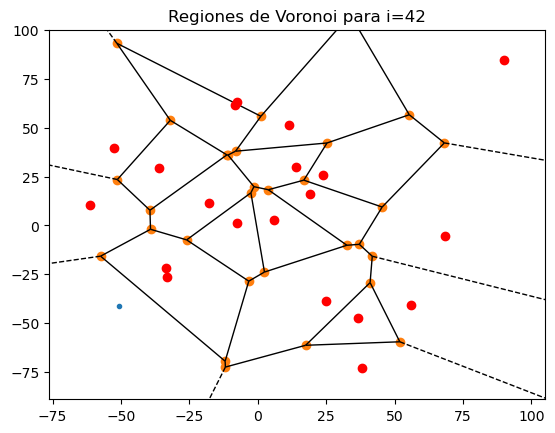

0.0005906296217971353 41


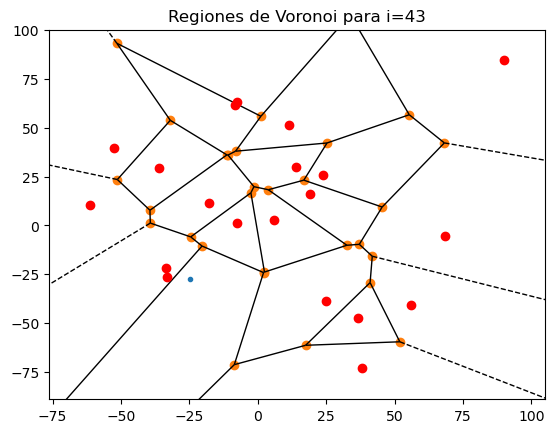

0.002581102333163667 42


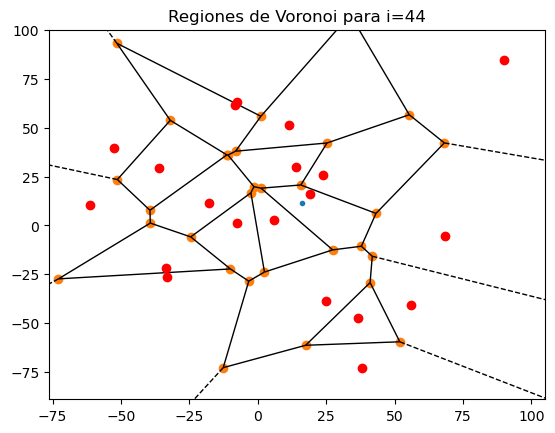

0.04348020504721283 43


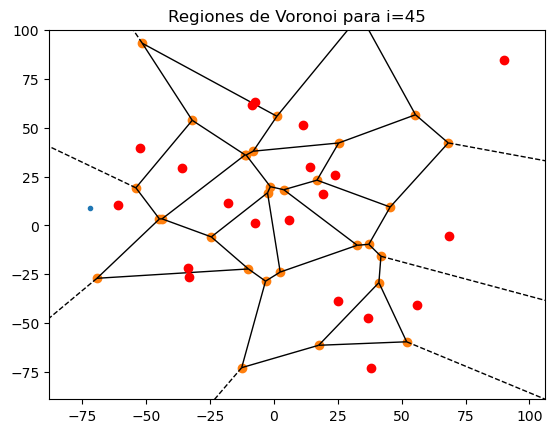

0.0016490092500620647 44


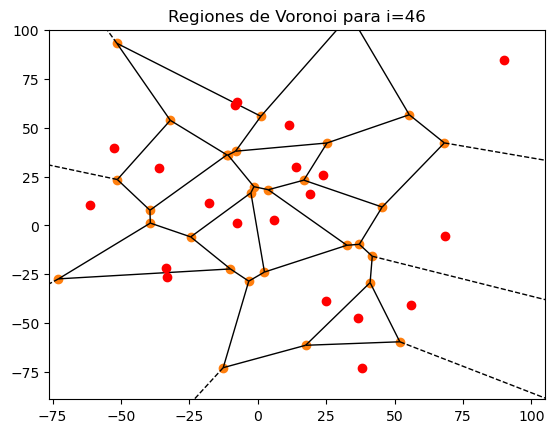

0.9999917453273932 45
3586.8091267891523 25


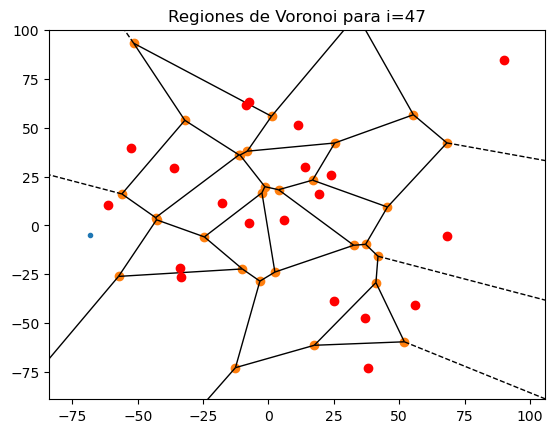

0.11673174237498334 46


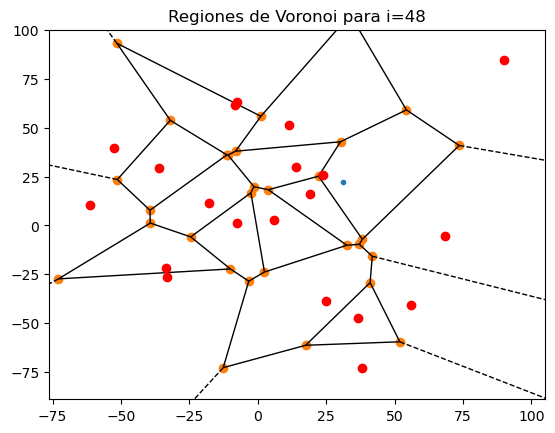

0.0010435319894344325 47


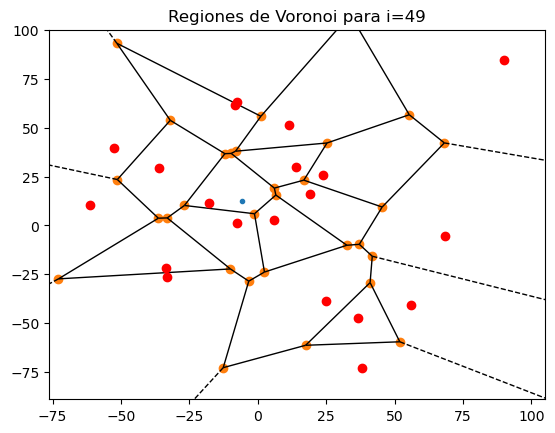

1 48
3637.3783045982736 26


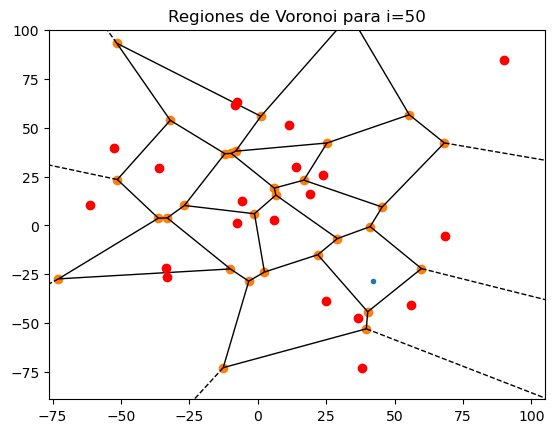

0.001852922564374948 49


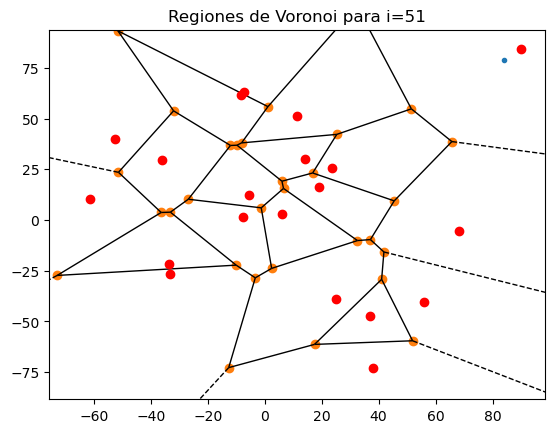

0.008741544935819105 50


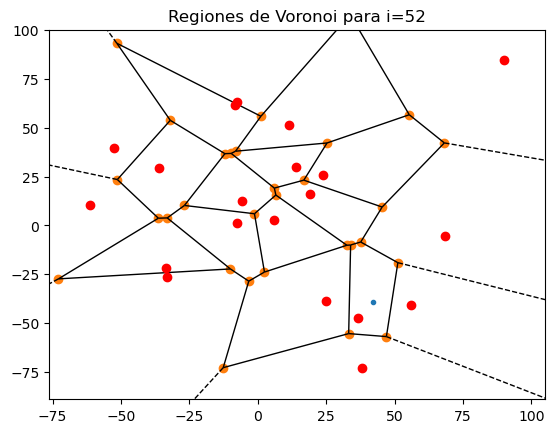

0.0013473346472898775 51


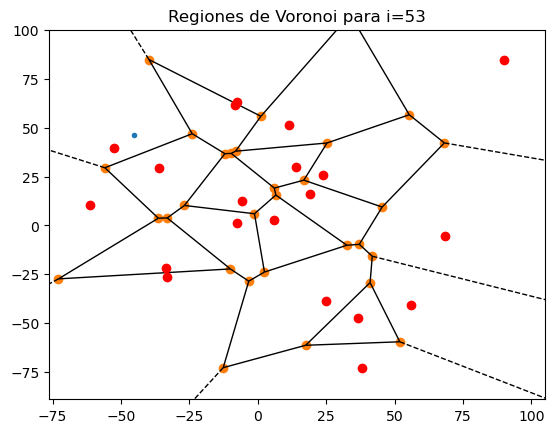

1 52
3687.916691279913 27


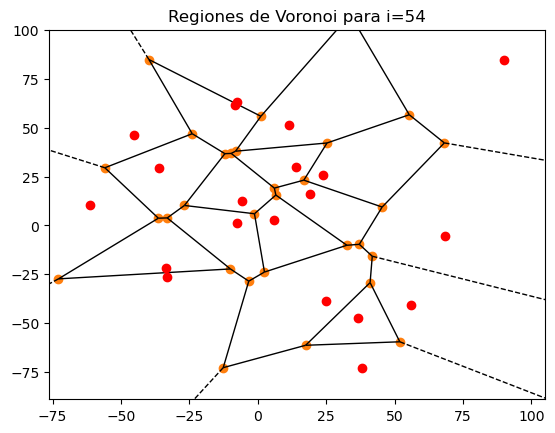

0.9999538112363358 53
3687.746350967446 28


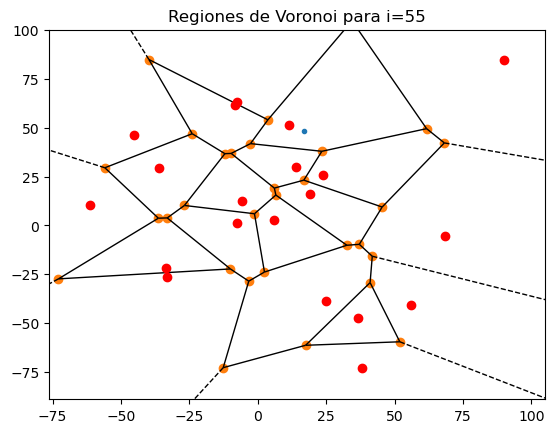

0.9727020098986106 54
3587.0782875823015 29


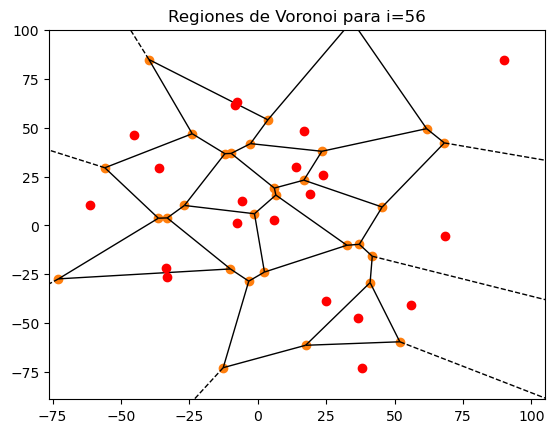

0.9999951517795257 55
3587.0608966359046 30


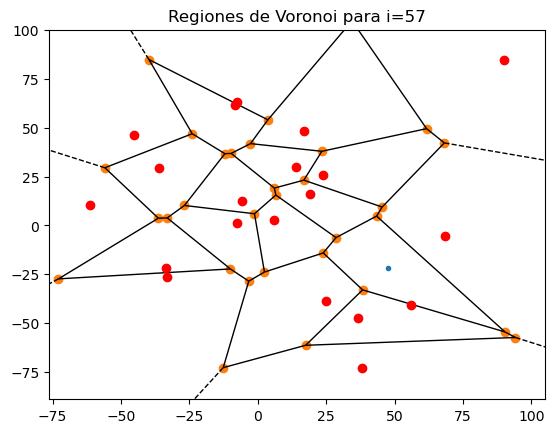

0.12861048517071644 56


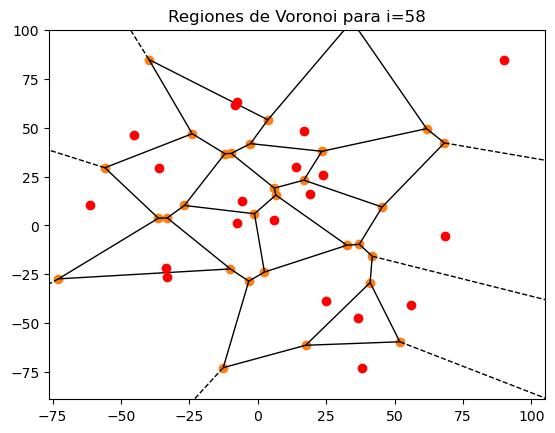

1 57
3587.0608966359046 31


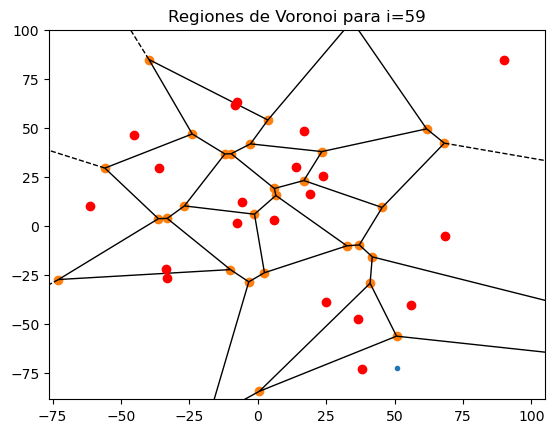

0.000958210430353523 58


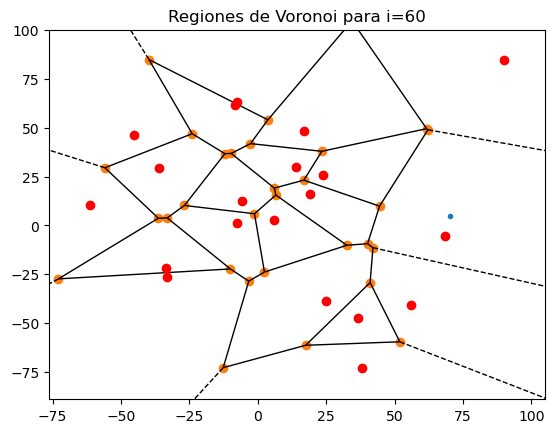

0.3253248099181839 59


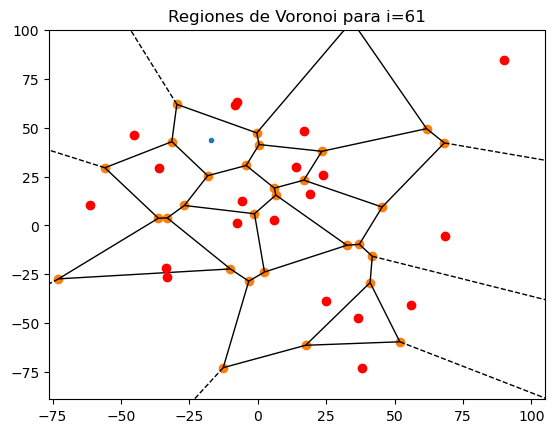

0.9998685734302507 60
3586.589461526778 32


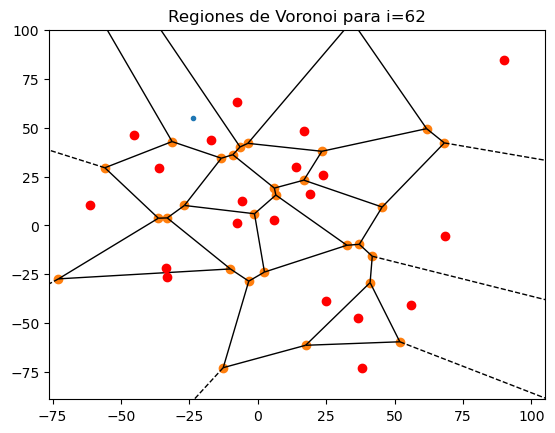

1 61
3637.85347559759 33


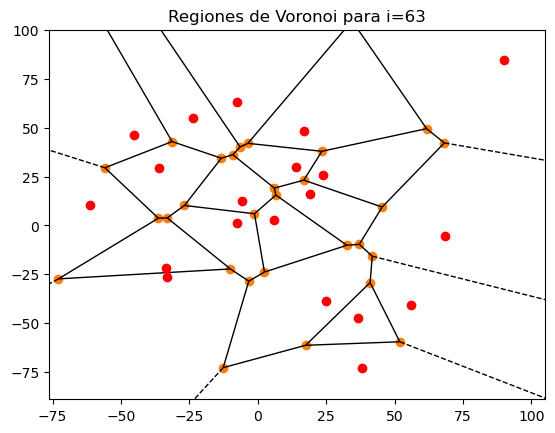

1 62
3638.1312535341012 34


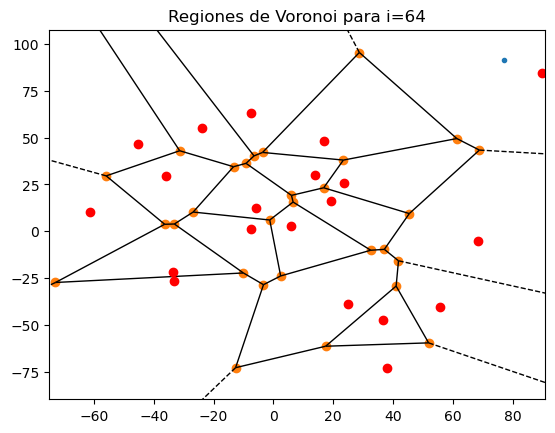

0.08857597216545288 63


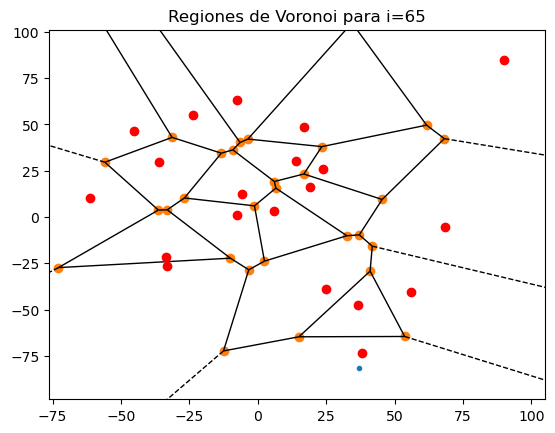

0.024333700986811226 64


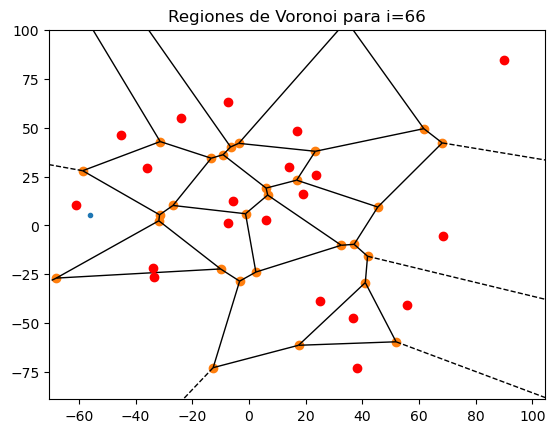

0.009558181180081636 65


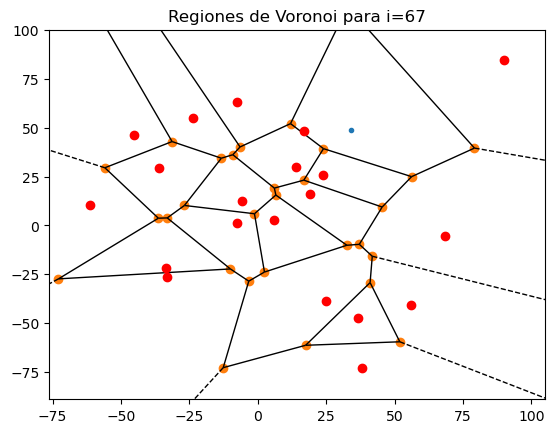

1 66
3643.9734700685776 35


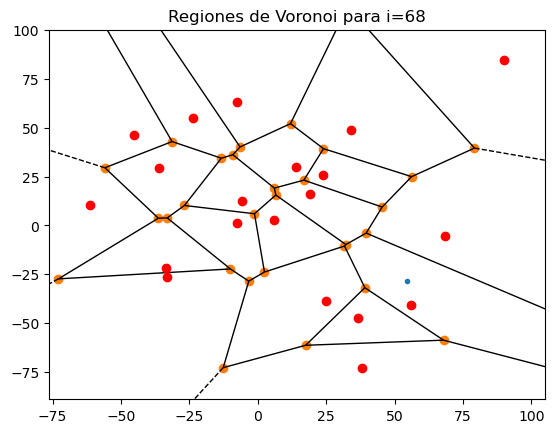

0.029054055337872045 67


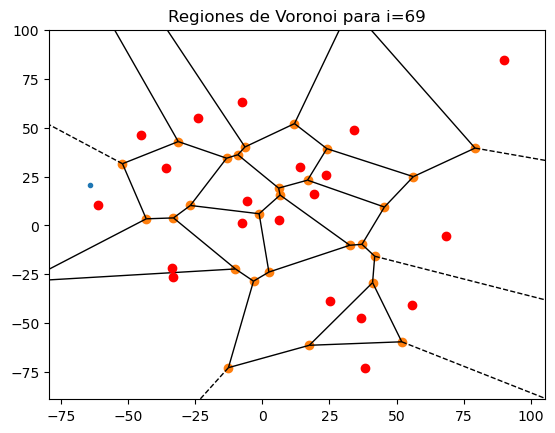

0.09149655307241694 68


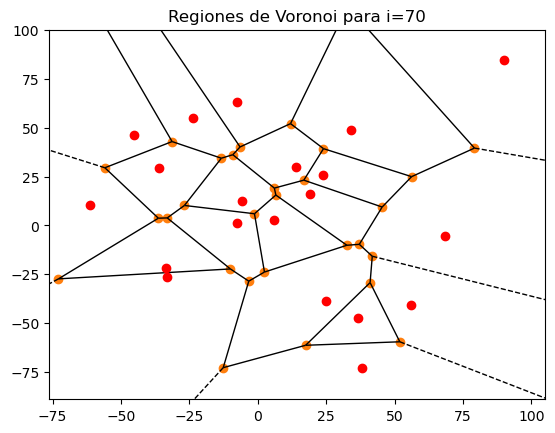

0.9902705630342746 69
3608.5196598867697 36


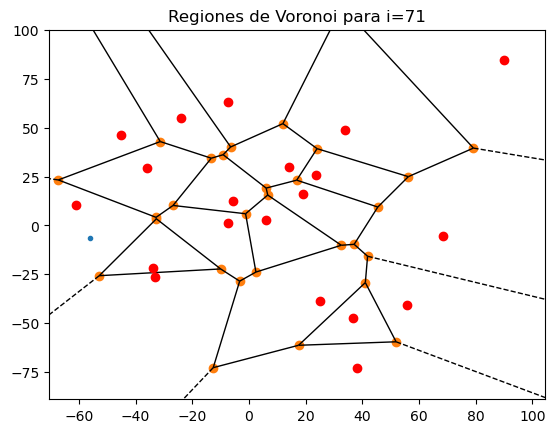

0.030440935652731645 70


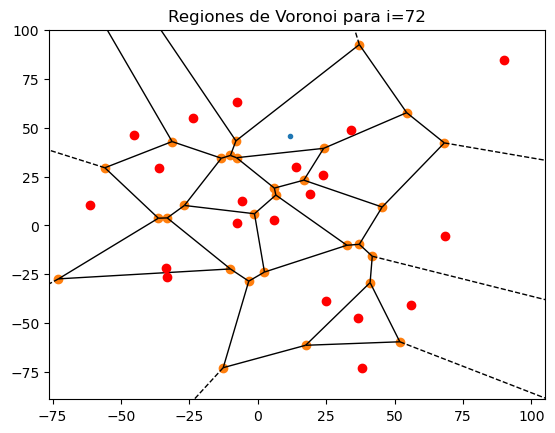

0.05777244077304534 71


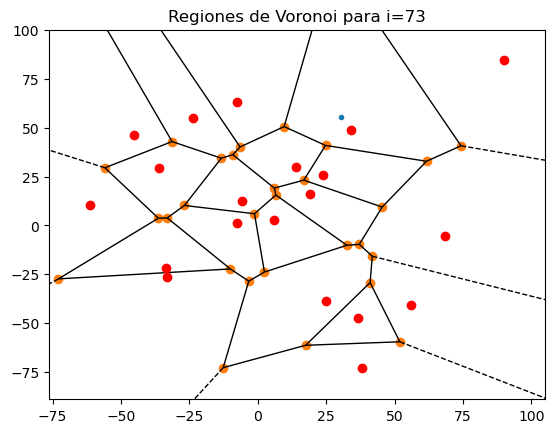

0.9972230841036478 72
3598.4991042809306 37


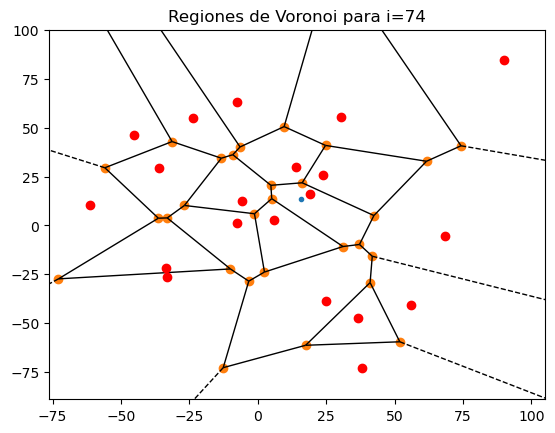

0.0028346079384600777 73


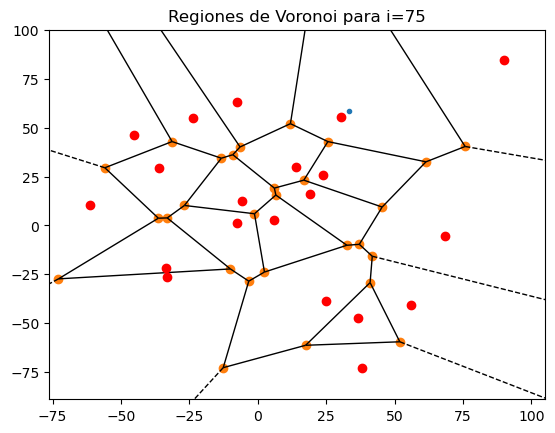

1 74
3598.721794445193 38


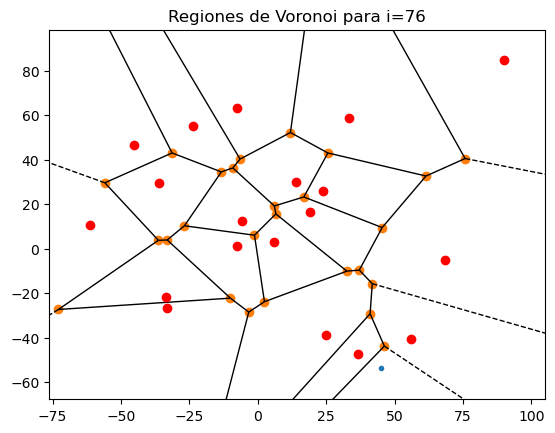

0.0005212015525811475 75


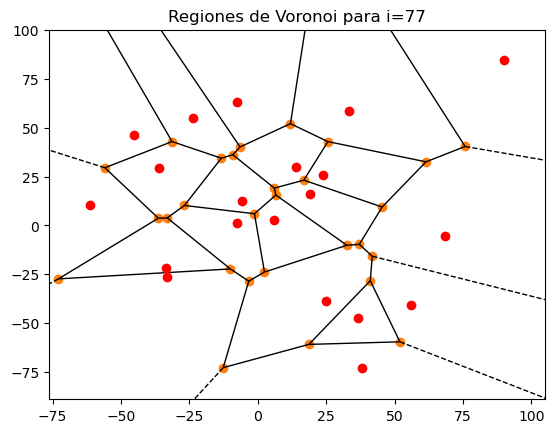

0.0046316270693138265 76


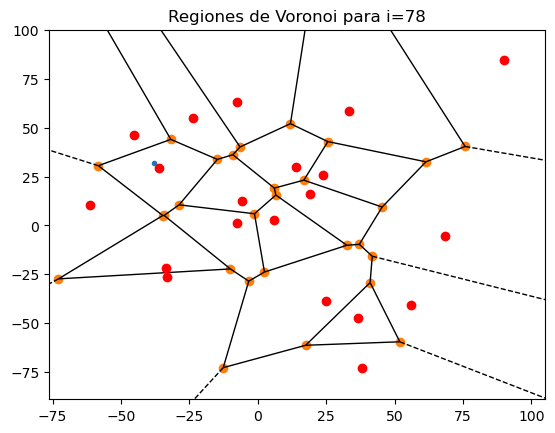

0.9964027334138675 77
3585.776232781249 39


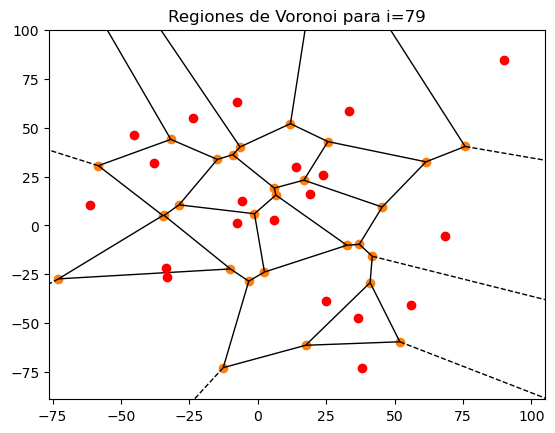

1 78
3585.7850559245294 40


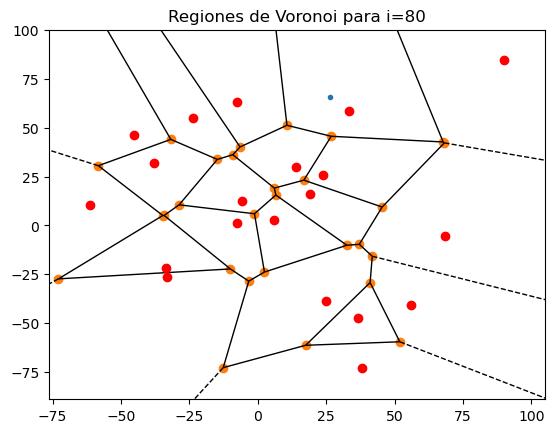

0.9999594549805533 79
3585.639670199705 41


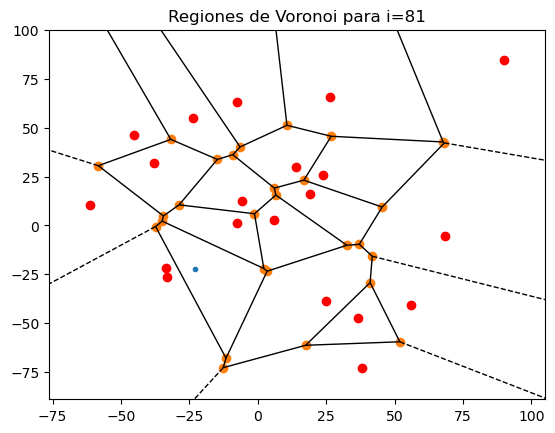

0.018134607264109148 80


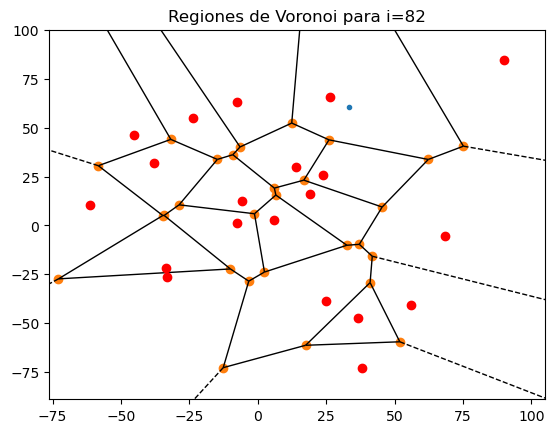

1 81
3585.8160863176913 42


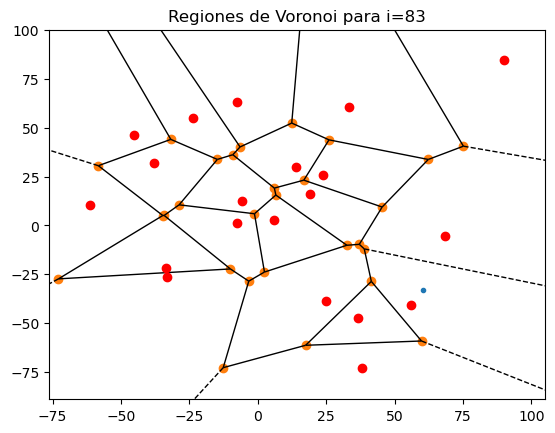

0.004098636000320356 82


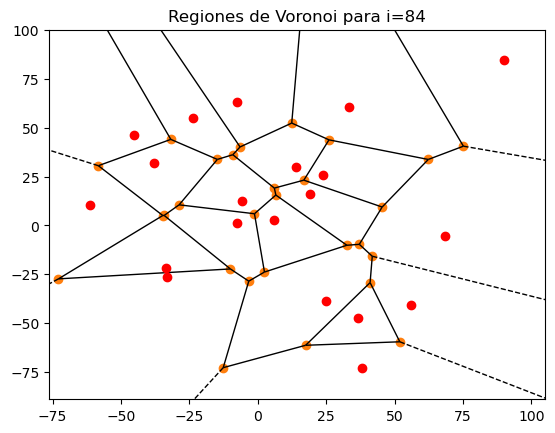

0.9999826060569835 83
3585.7537148370184 43


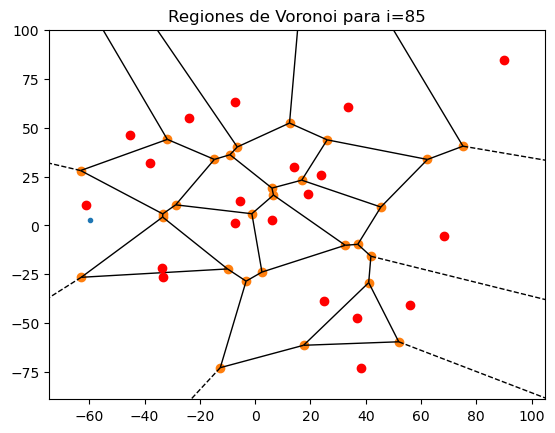

0.09089197389407294 84


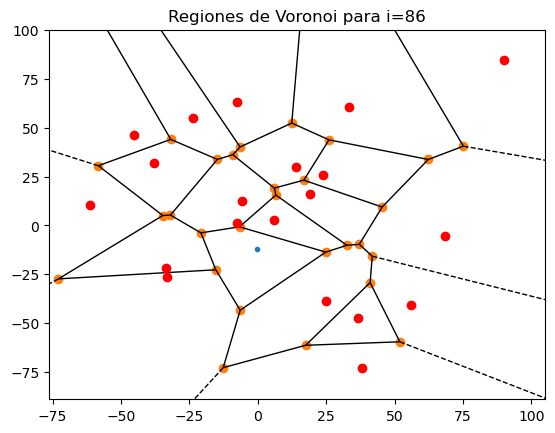

0.003120970892366829 85


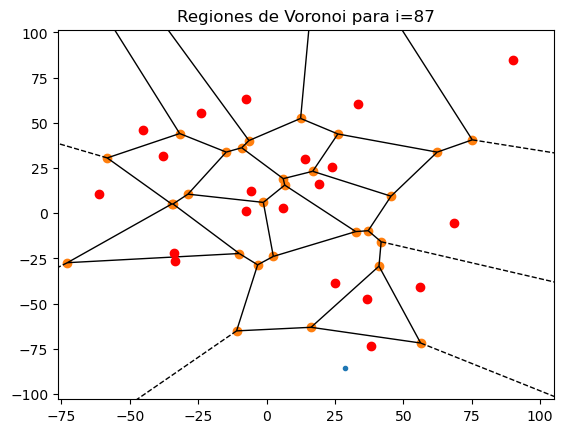

0.8683865008308413 86
3113.820121268509 44


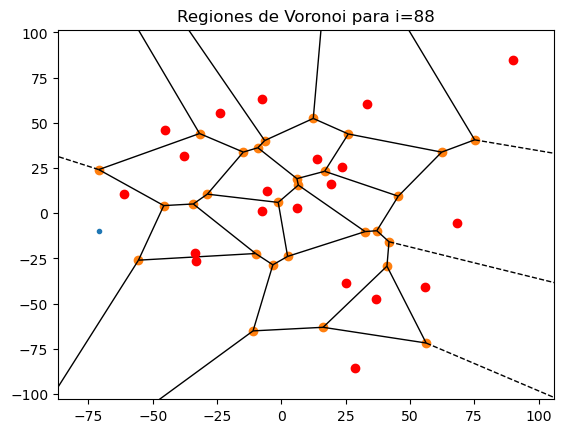

0.024578009142240818 87


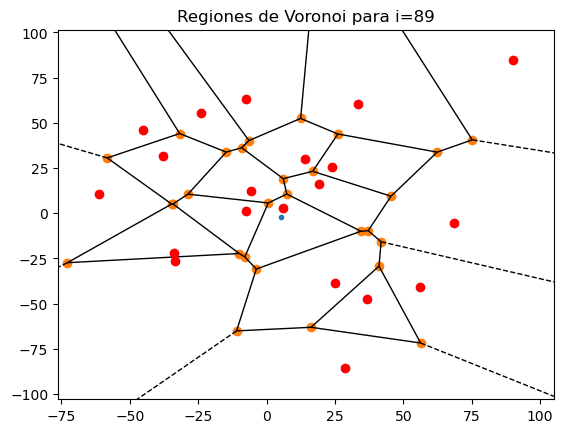

0.003422884961185164 88


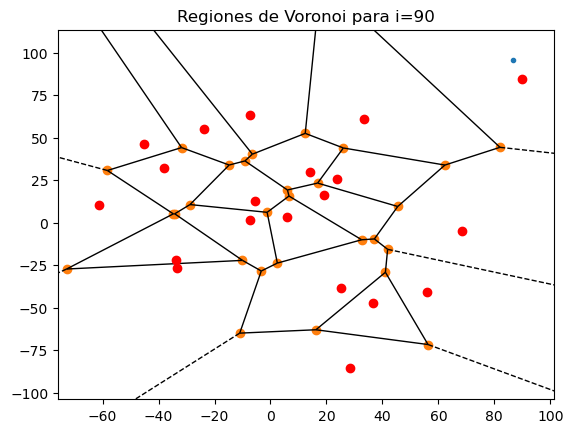

0.9993206851582489 89
3111.704857045588 45


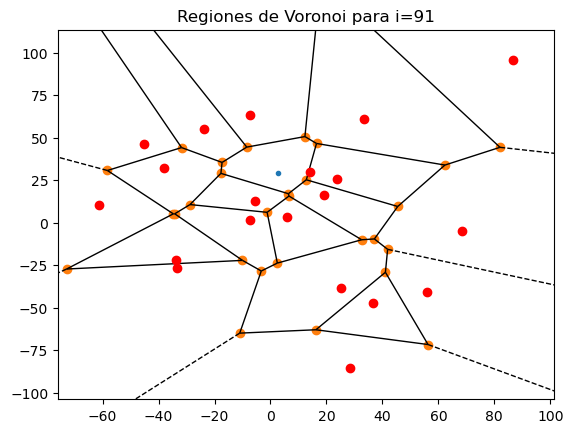

0.02874764837335624 90


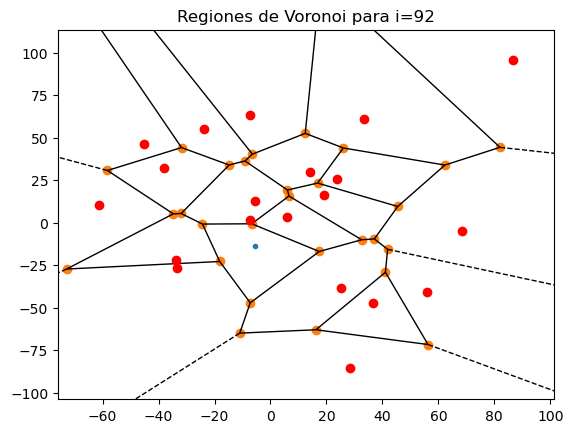

0.0033172639034787454 91


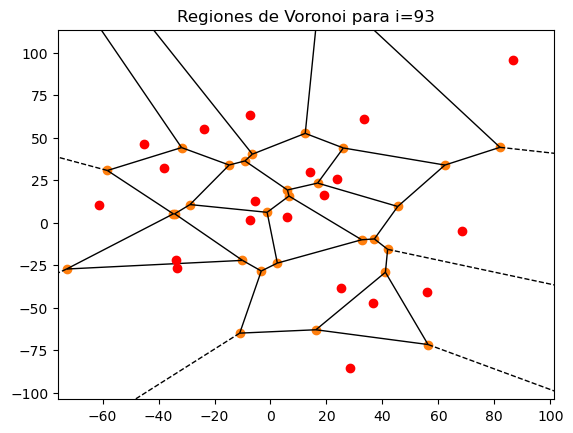

1 92
3111.704858521325 46


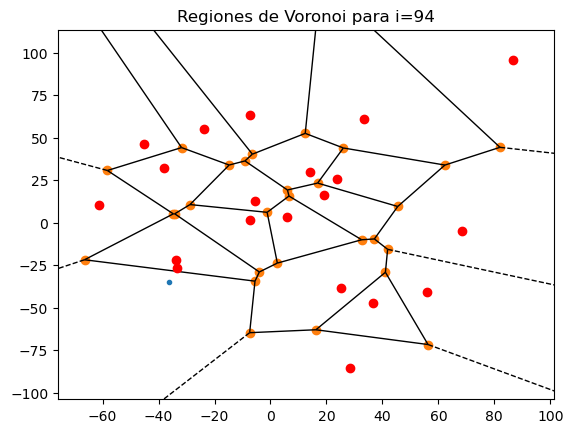

0.0009915694735907951 93


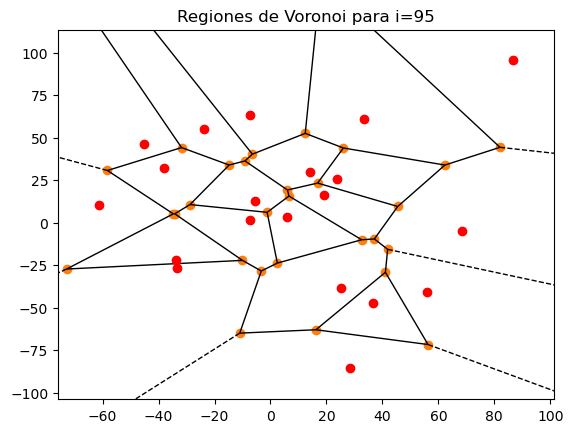

1 94
3111.704858521325 47


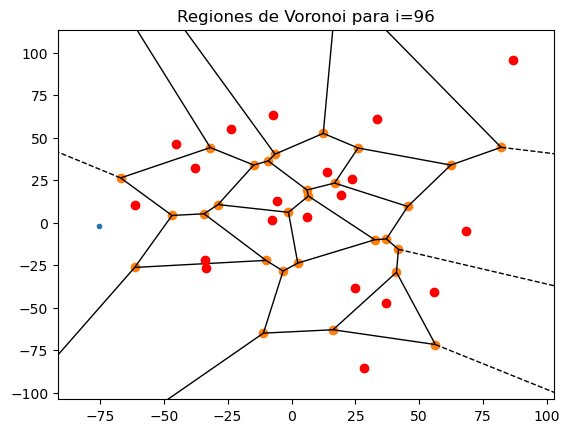

0.001723676626602426 95


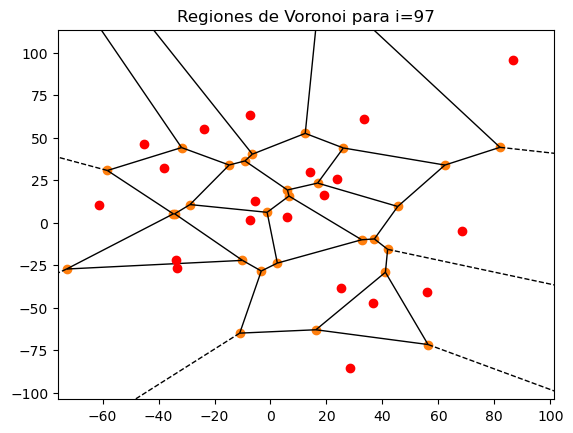

1 96
3111.704858521325 48


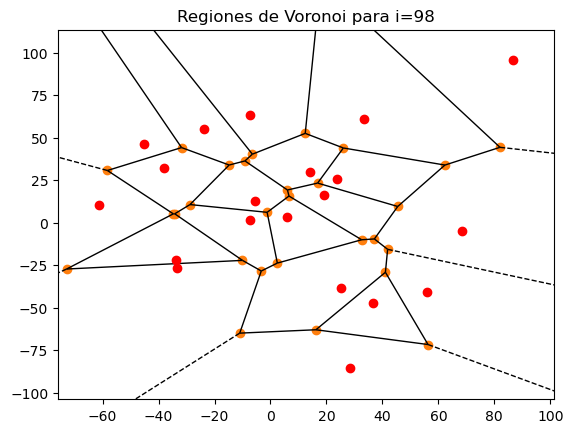

1 97
3111.704858521325 49


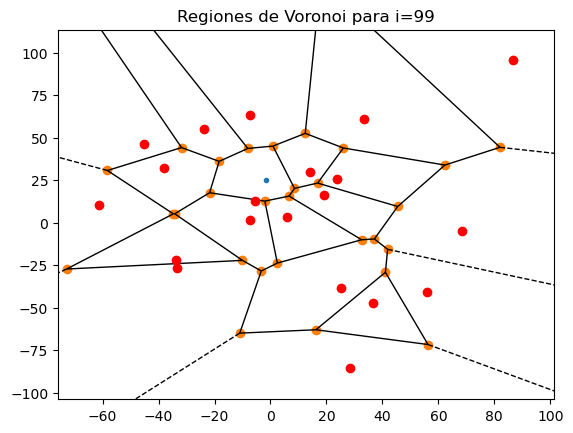

1 98
3126.0387766746894 50


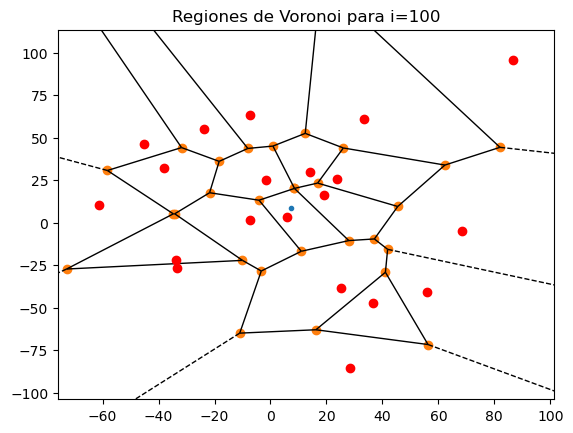

0.0027233566425677886 99


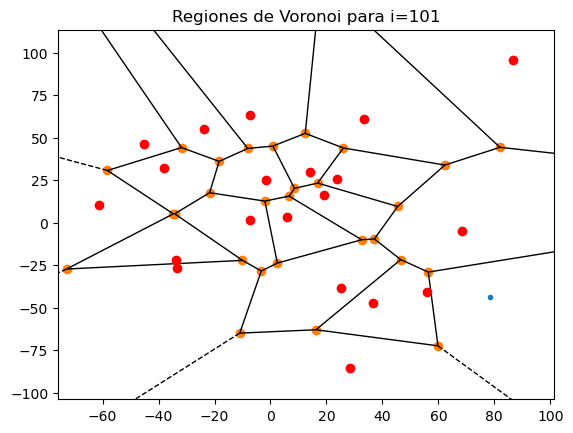

0.011619822415609986 100


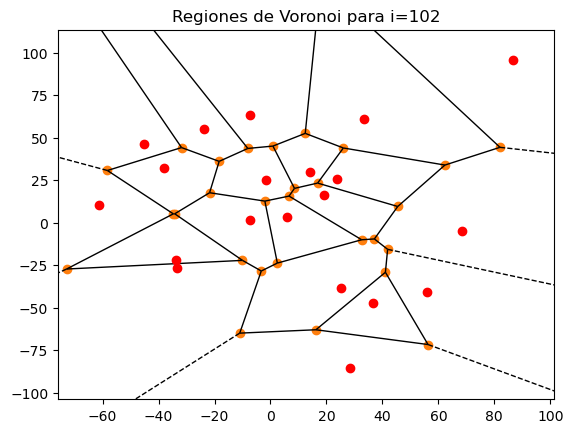

1 101
3126.2031978537616 51


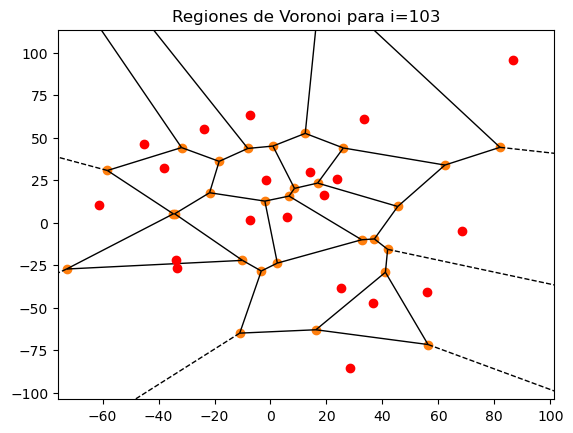

1 102
3126.2031978537616 52


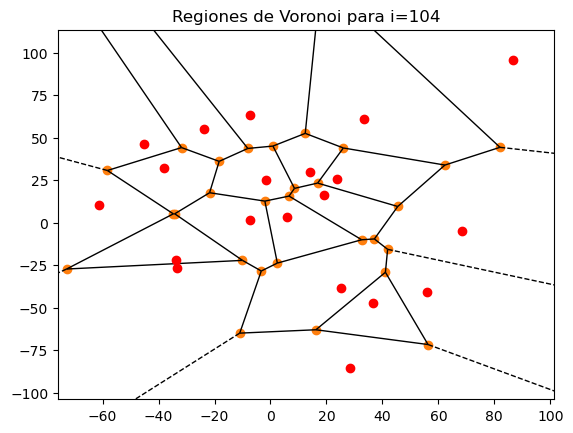

1 103
3126.2031978537616 53


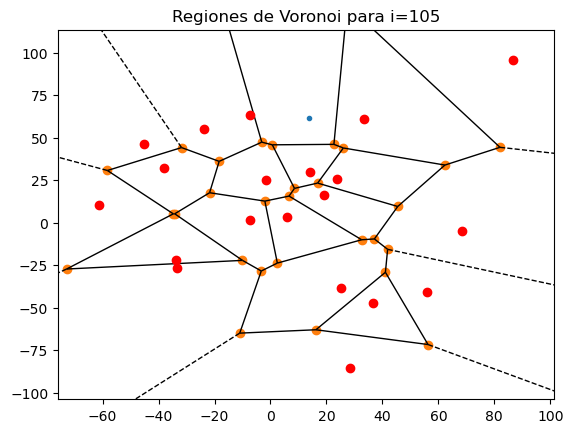

0.9949607357935498 104
3110.449433976727 54


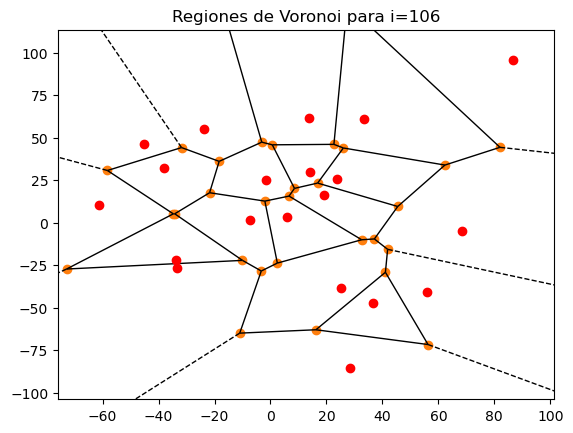

0.999998803659518 105
3110.445712820152 55


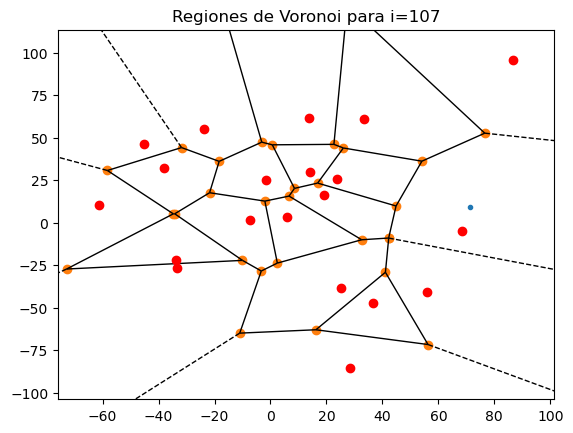

0.008159623040380677 106


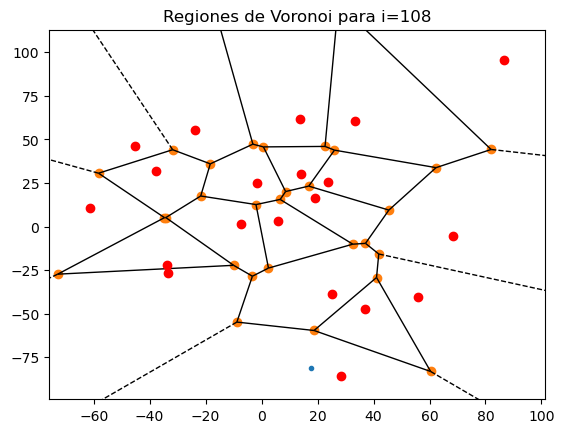

0.005243611232139547 107


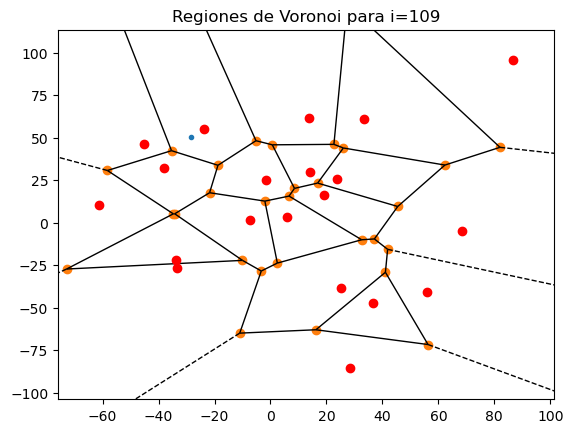

0.09985306567713154 108


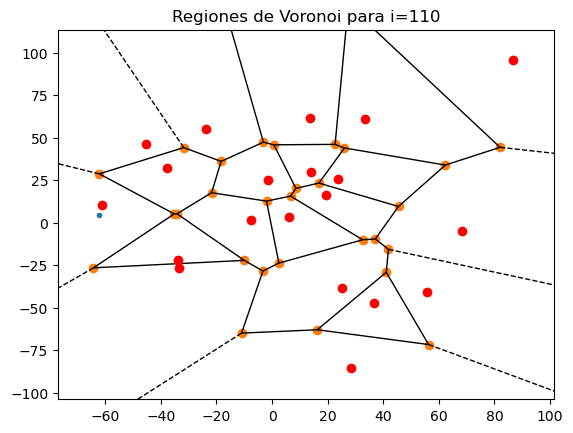

0.9999971535780451 109
3110.4368591791854 56


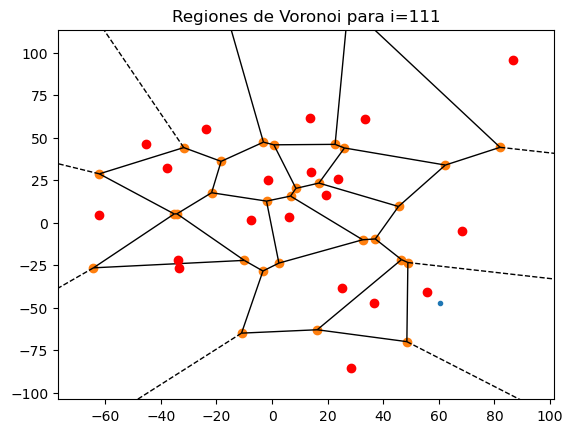

0.00029871373359501626 110


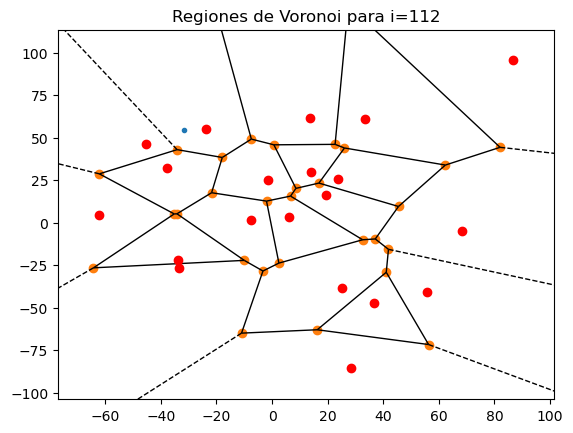

0.034413909120610424 111


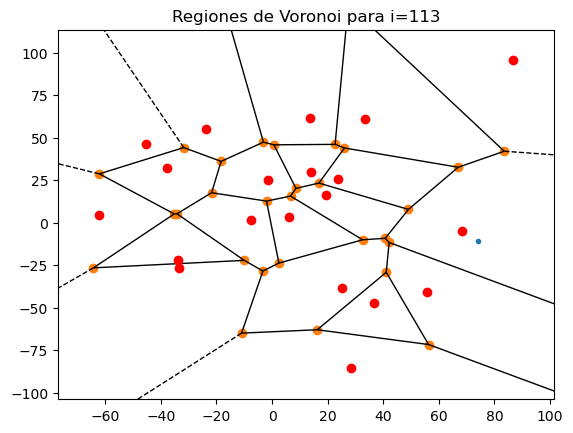

0.002835348406620637 112


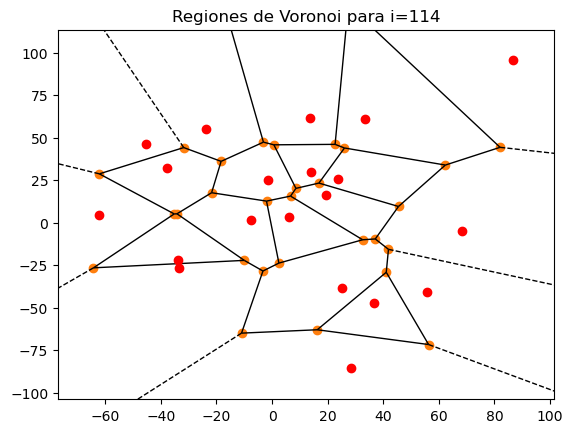

1 113
3110.439372616551 57


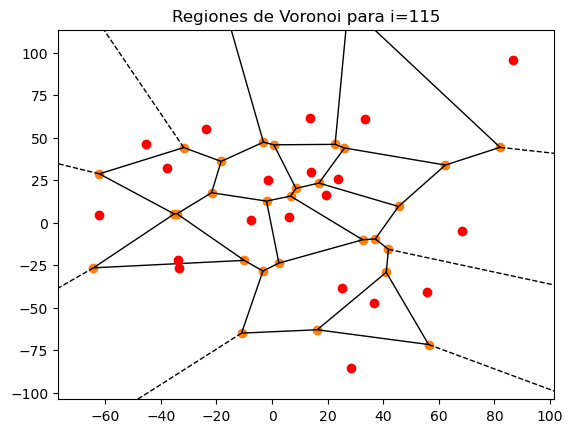

1 114
3110.439372616551 58


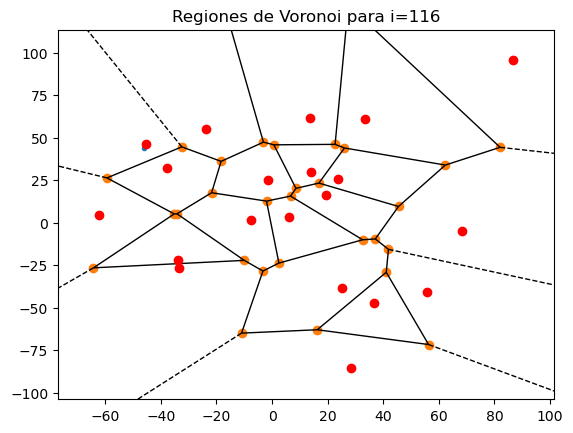

1 115
3110.5033628983697 59


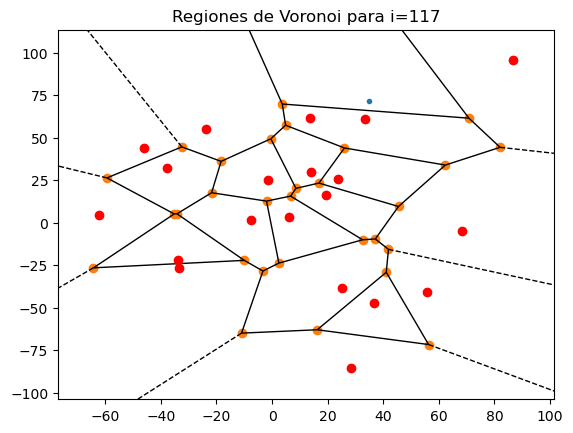

0.009894078816820286 116


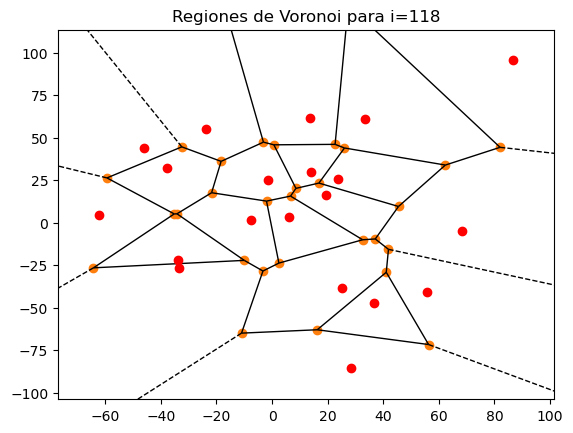

0.9999996290016556 117
3110.502208906772 60


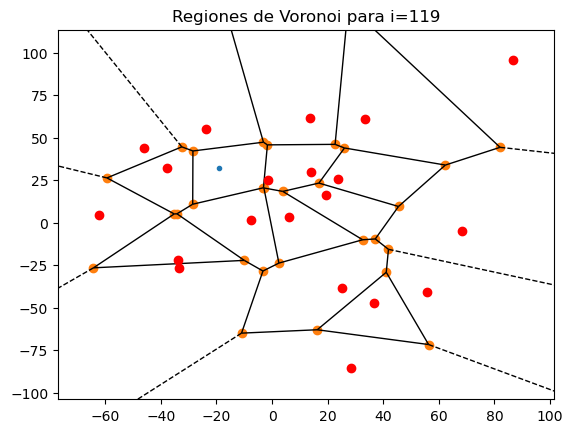

1 118
3515.2049963407485 61


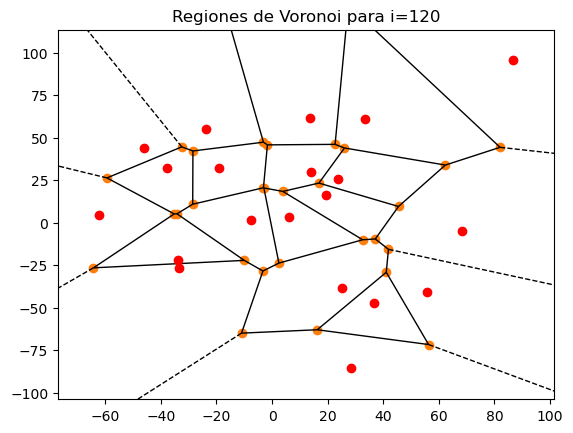

0.8953757617234575 119
3147.429351212701 62


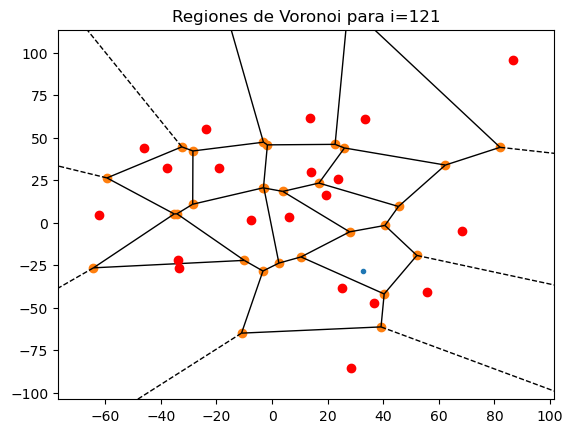

0.049439646192042754 120


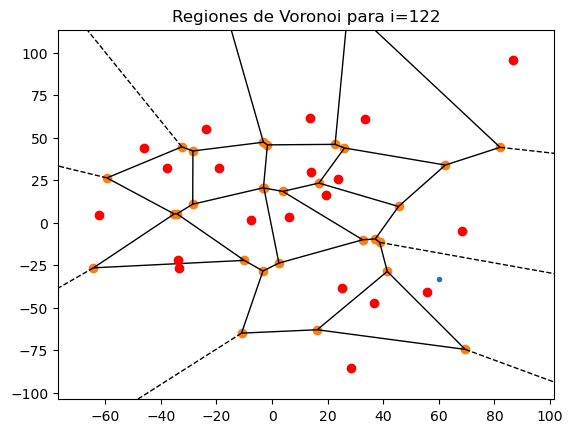

0.01526715152534536 121


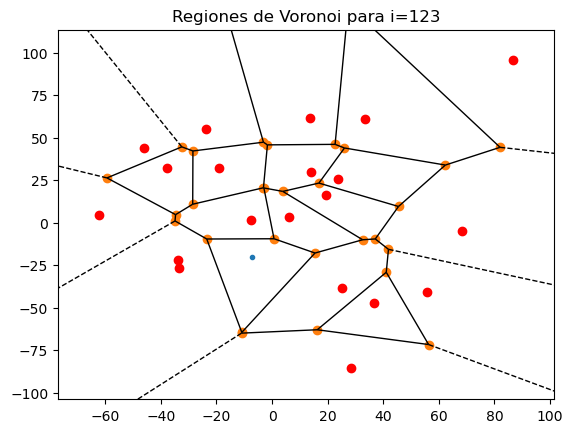

0.001091688483988007 122


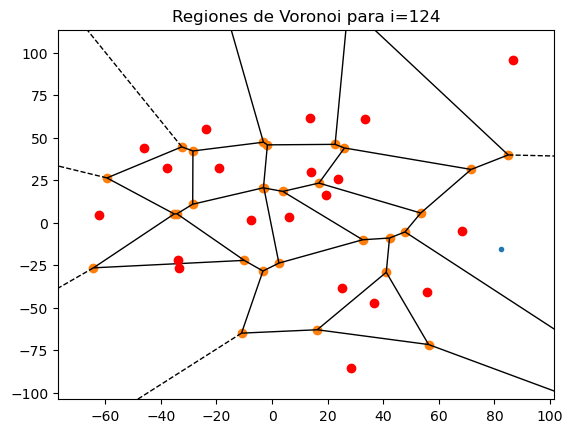

0.03776422278397715 123


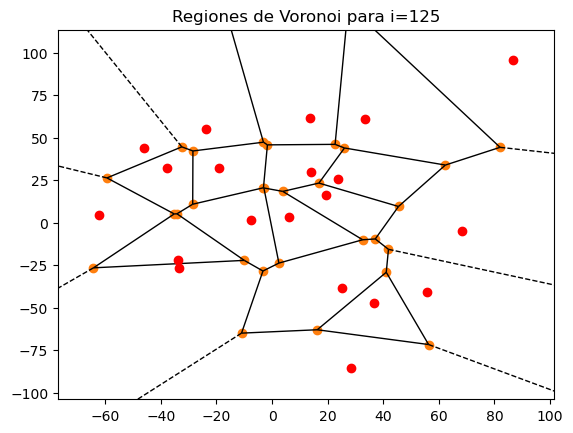

1 124
3147.429351212701 63


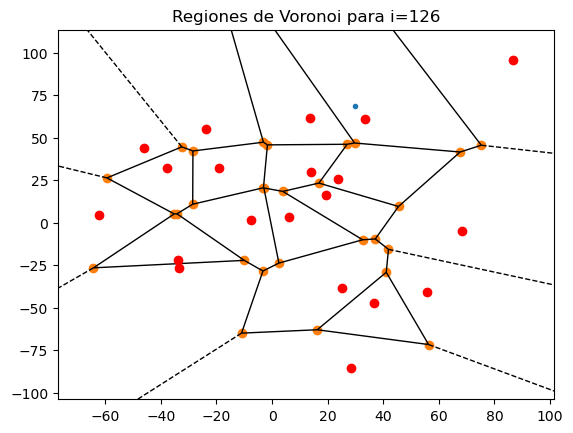

0.03892746276990337 125


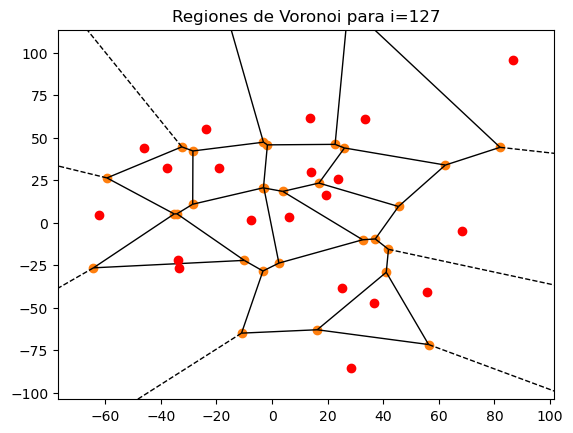

1 126
3147.429351212701 64


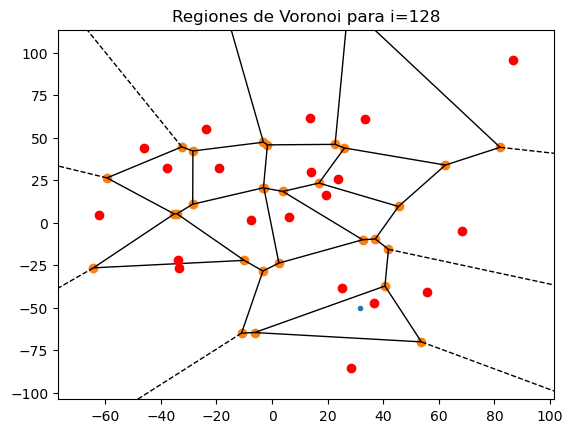

0.012310642035546647 127


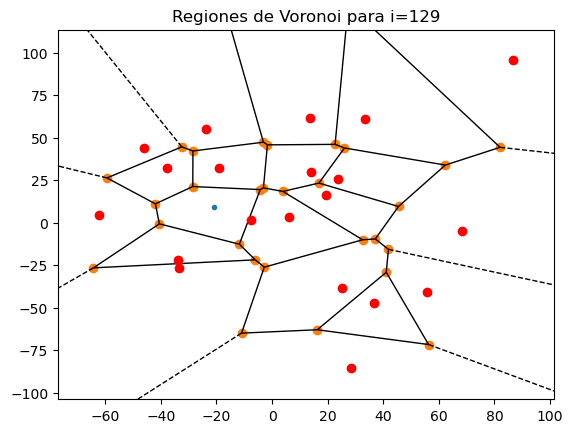

0.0017295839745689314 128


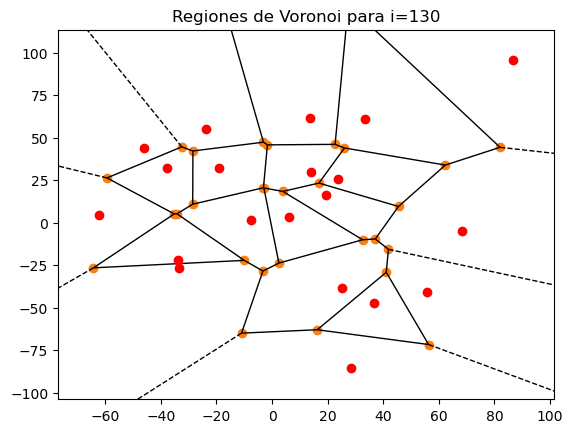

1 129
3147.429351212701 65


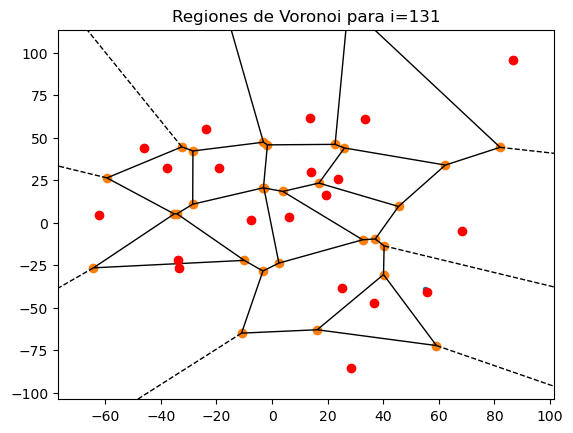

0.023515697061002 130


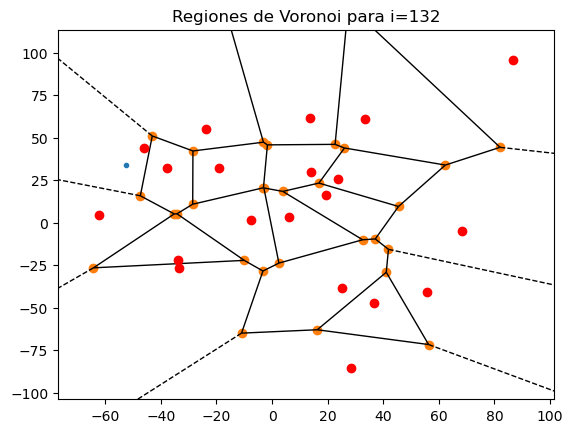

1 131
3150.6161874843497 66


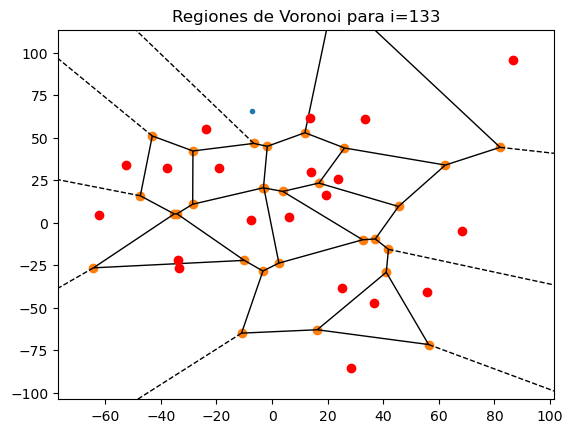

1 132
3160.229339391882 67


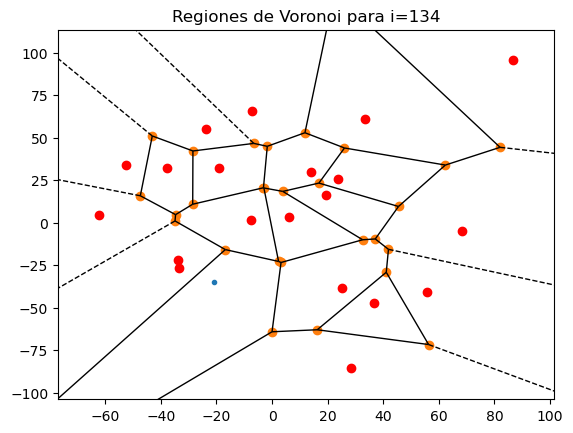

0.023756190949515383 133
75.0750116308544 68


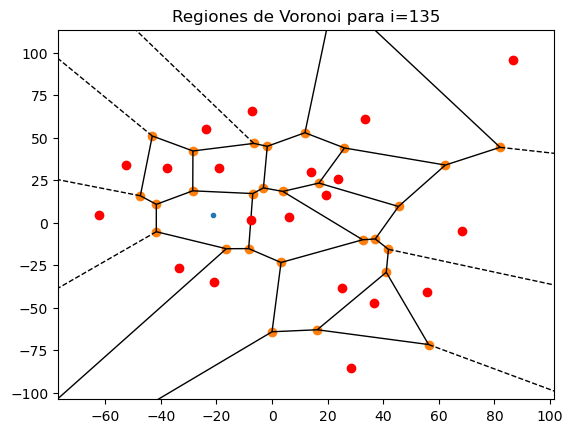

1 134
11981.536700644712 69


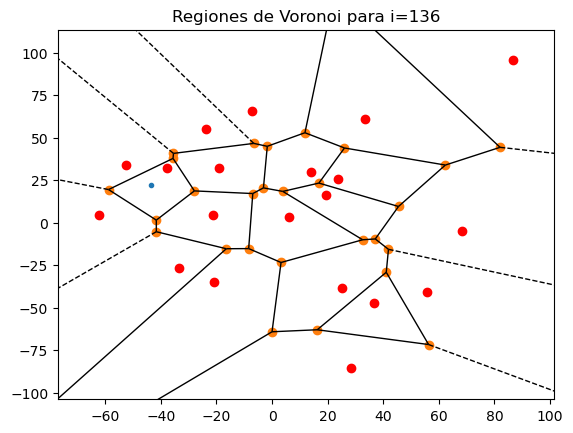

0.052580158679119804 135


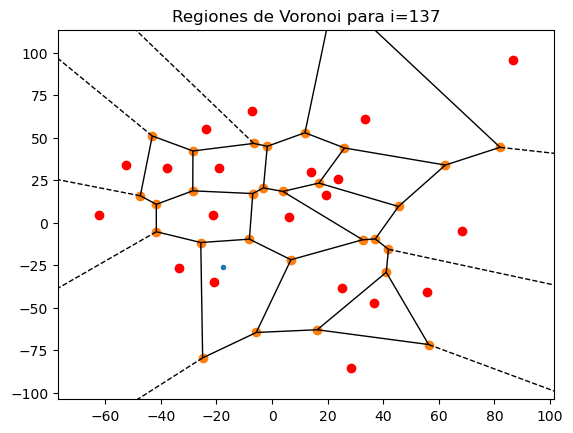

1 136
27832.320120864628 70


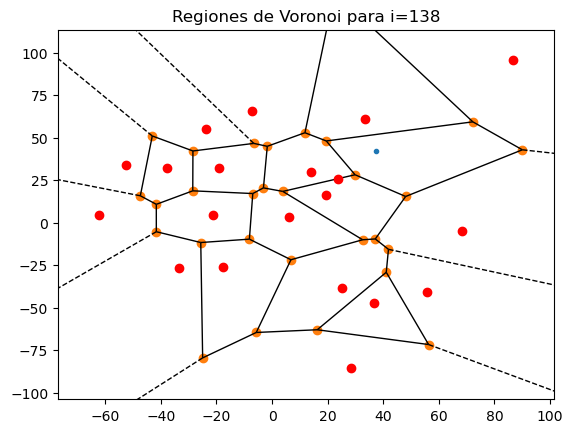

0.0005052571059195642 137


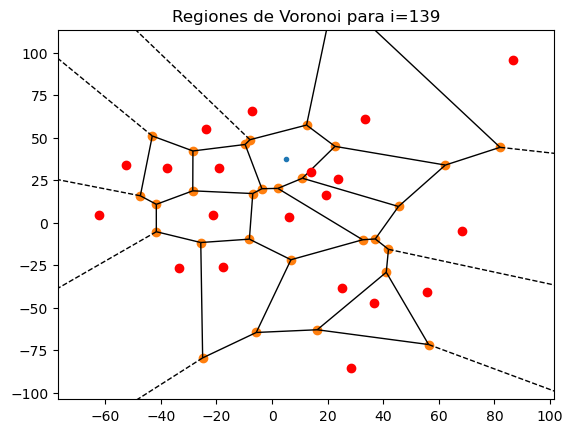

0.00039300121905483436 138


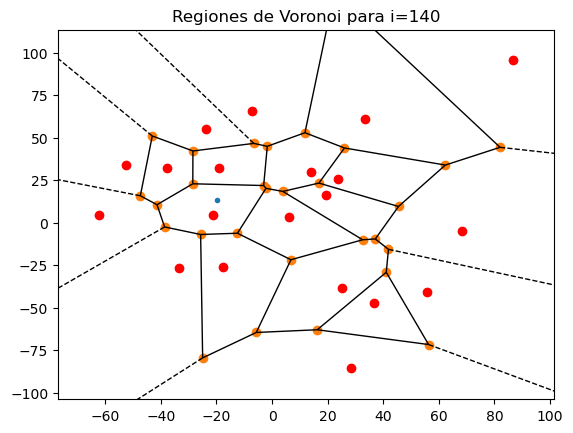

0.00025537034254079064 139


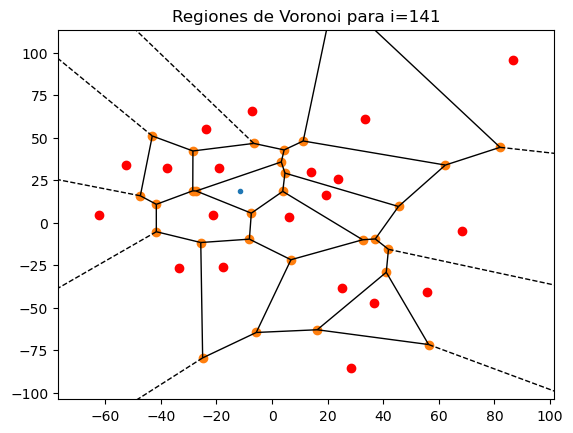

0.00013796176375097566 140


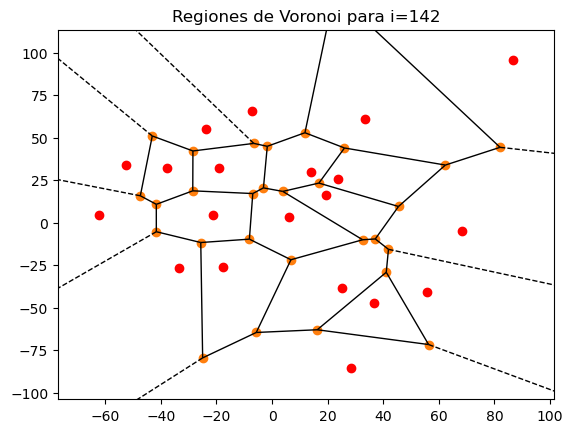

0.02271217858894343 141


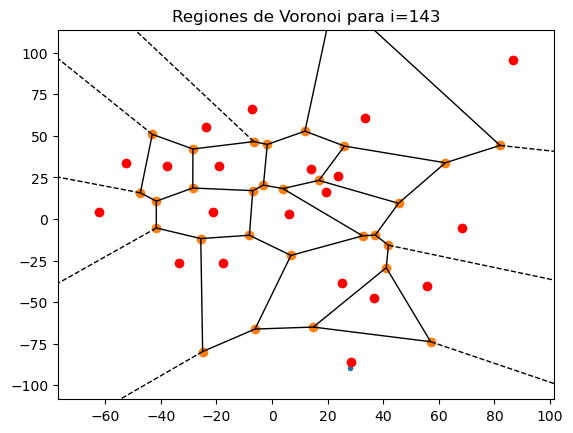

0.022659517869351598 142


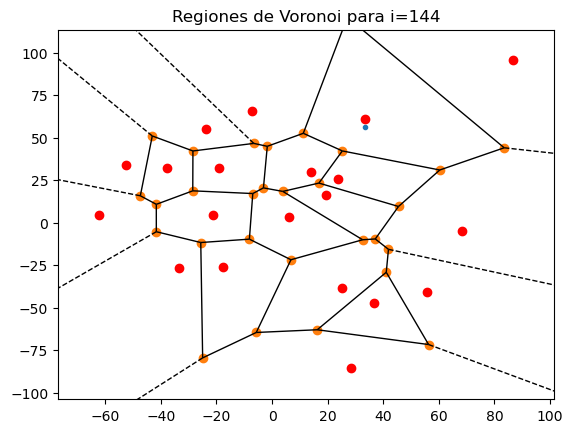

0.00043457718890794675 143


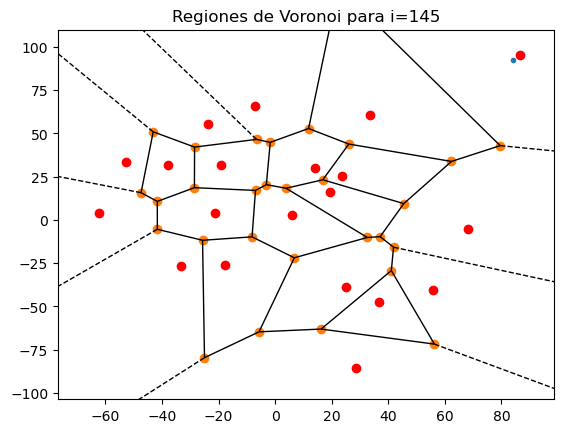

0.022712326060899193 144


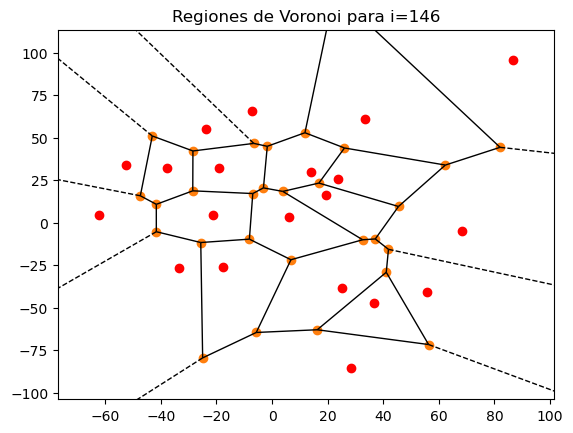

0.02271217858894343 145


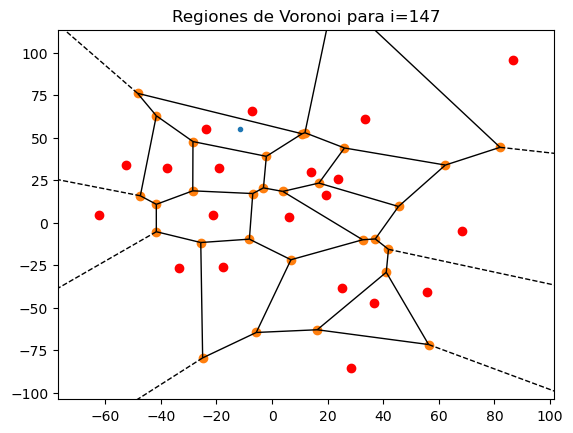

0.000719864041290486 146


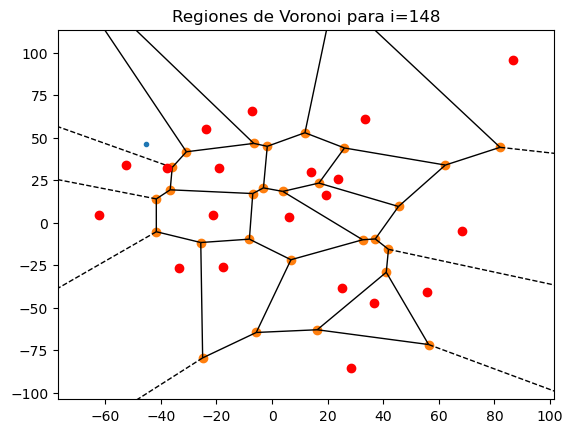

0.02284765784601611 147


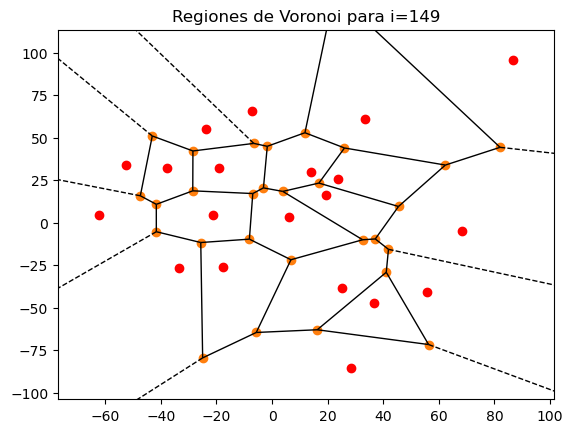

0.02271217858894343 148


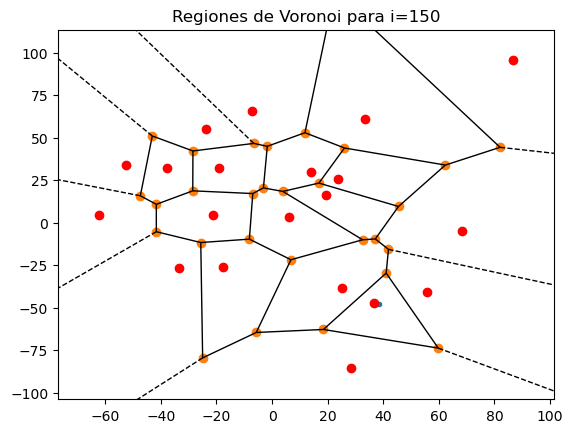

0.023356455470133326 149


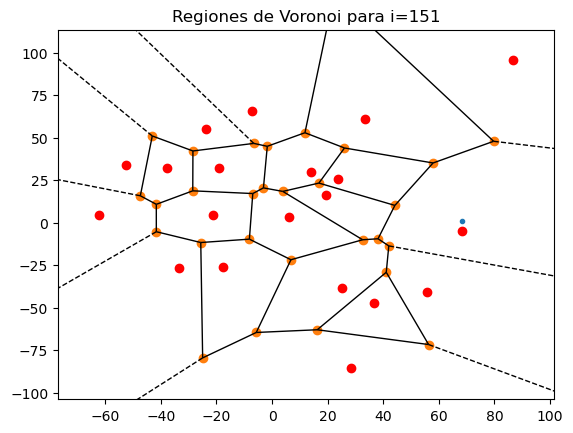

0.022699155553786033 150


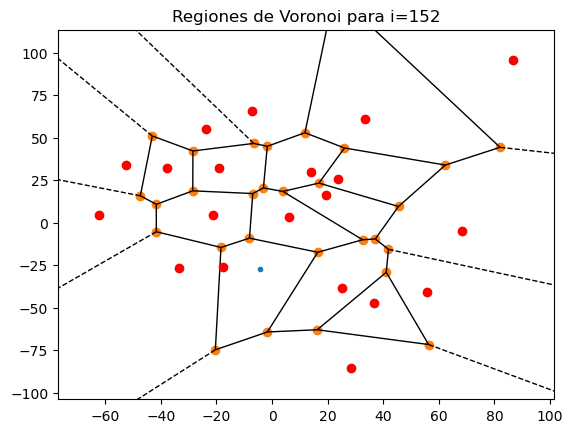

0.011576855439674292 151


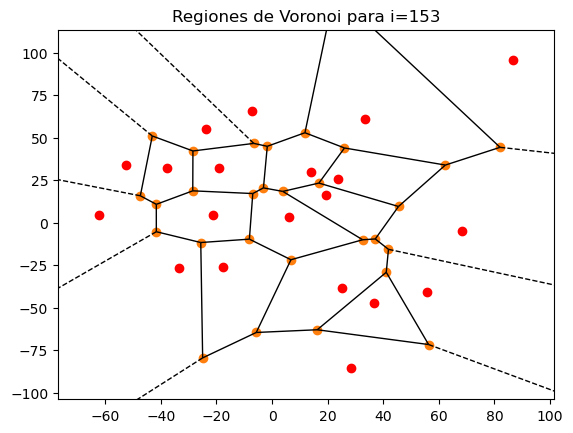

0.02271217858894343 152


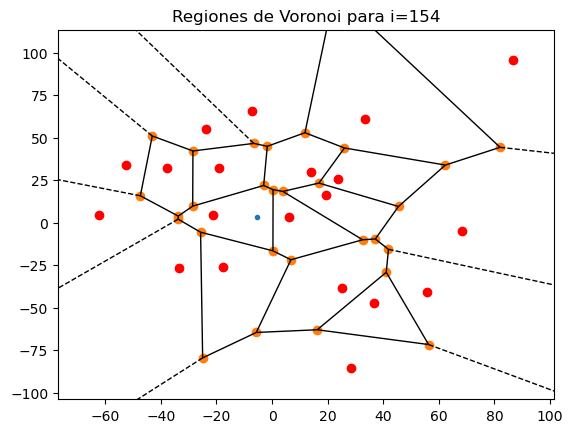

0.0020132208799605476 153


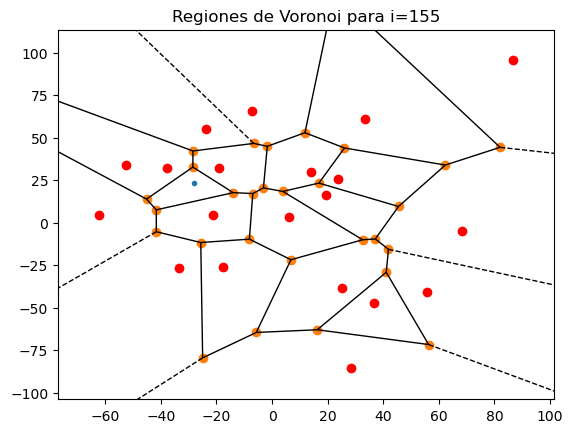

0.0003125967717538186 154


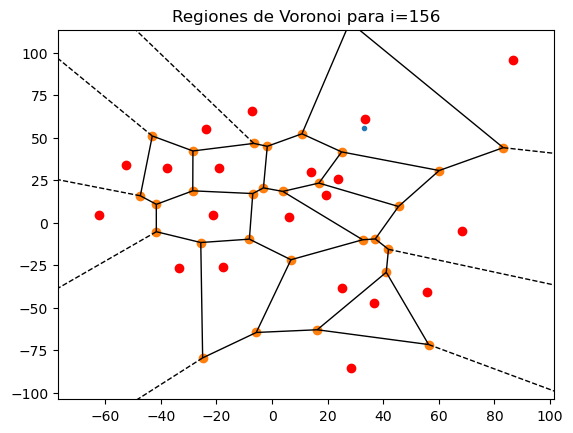

0.00040298568605779935 155


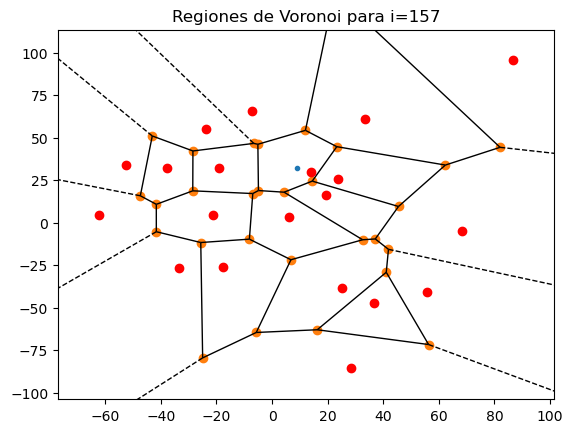

0.0006184078804425793 156


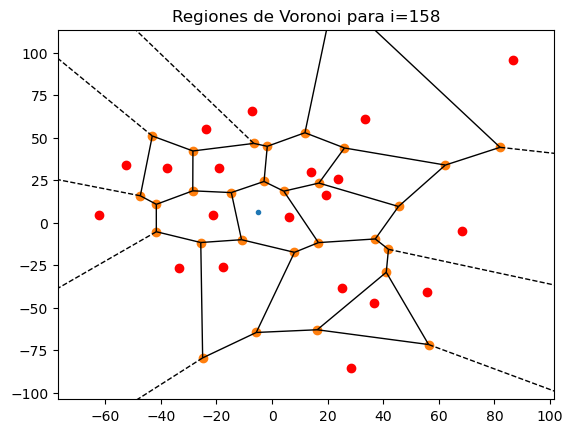

0.001055413604091047 157


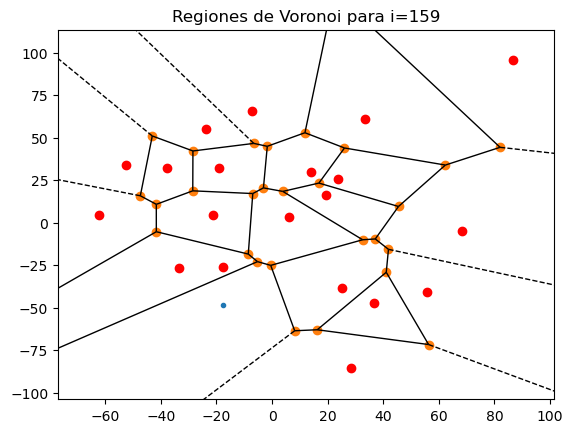

0.057149847094638065 158


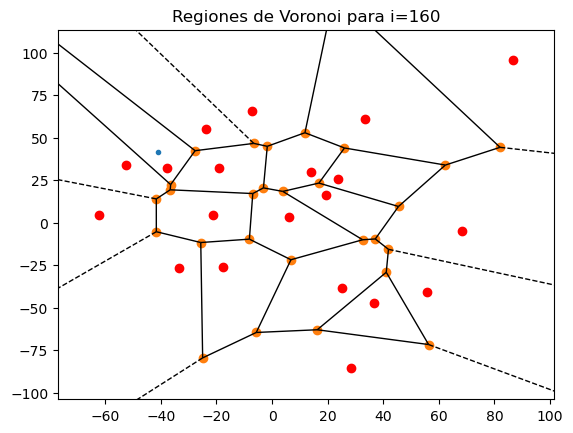

0.026889229615416857 159


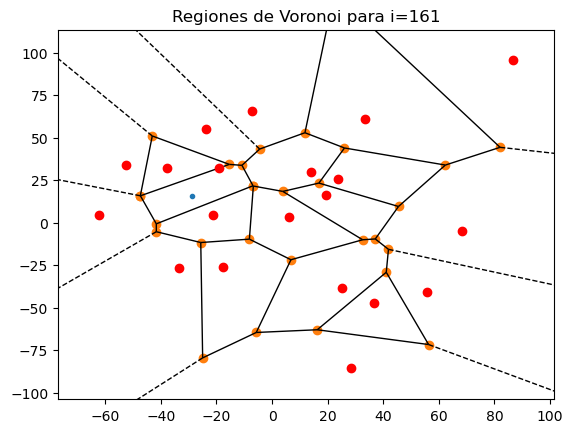

0.0015882651446014722 160


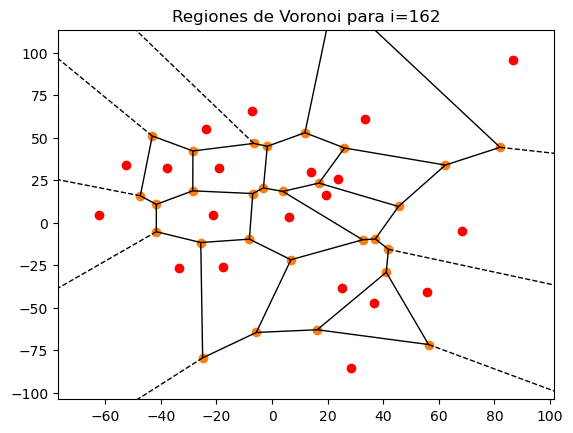

0.02271217858894343 161


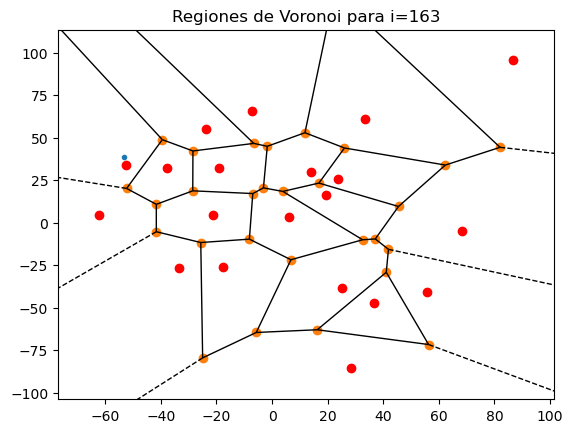

0.022638357908534575 162


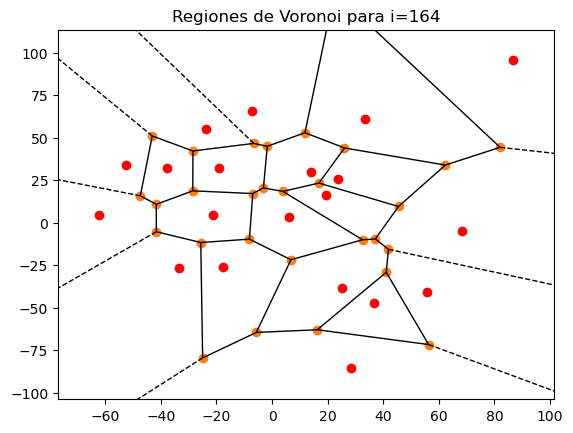

0.02271217858894343 163


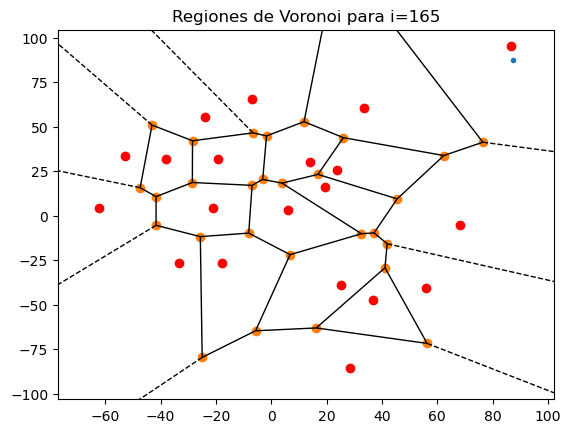

0.054336713127295946 164


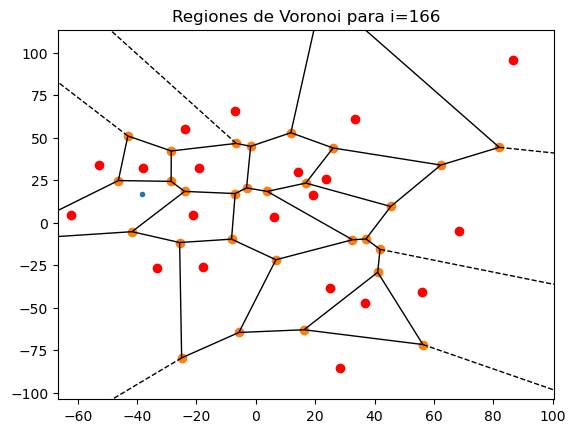

0.06104498822206457 165


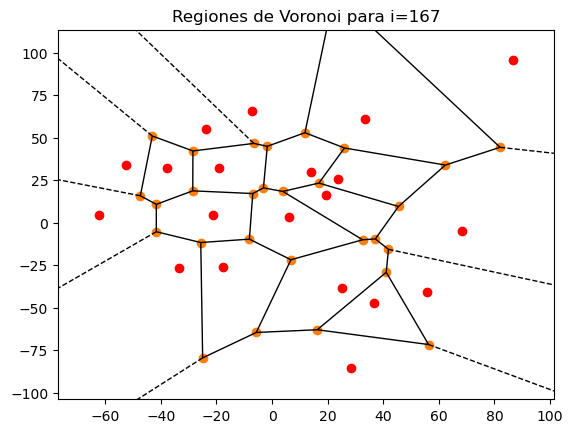

0.02271217858894343 166


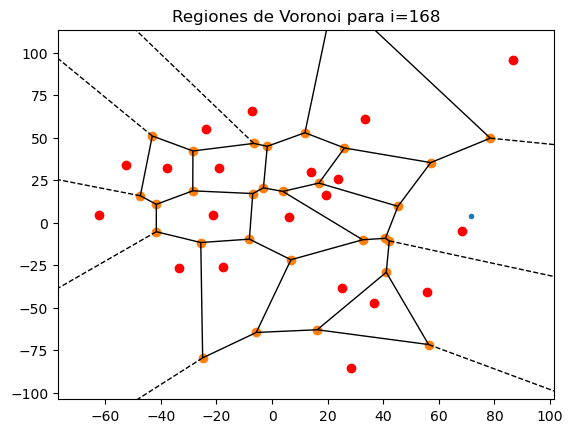

0.00052267500717716 167


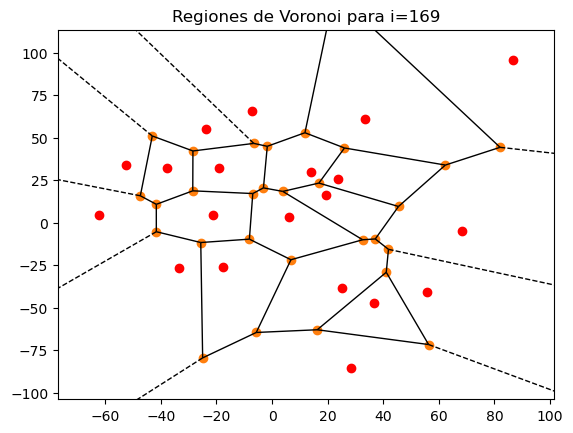

0.02271217858894343 168


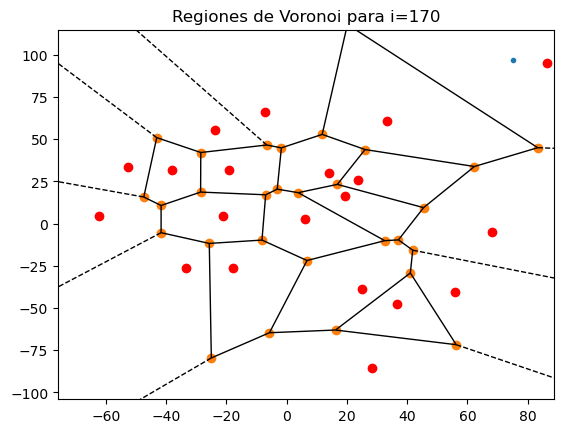

0.00030908198347287205 169


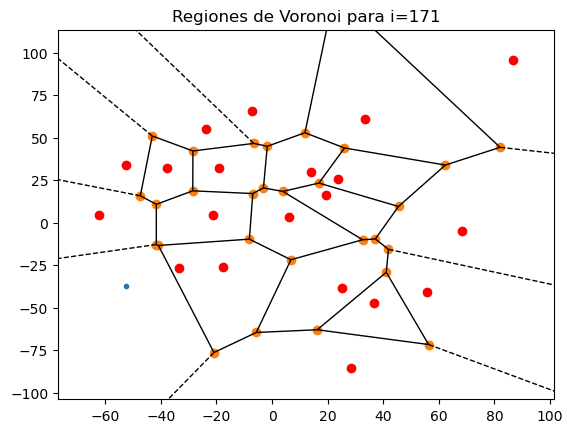

0.0005048123345799085 170


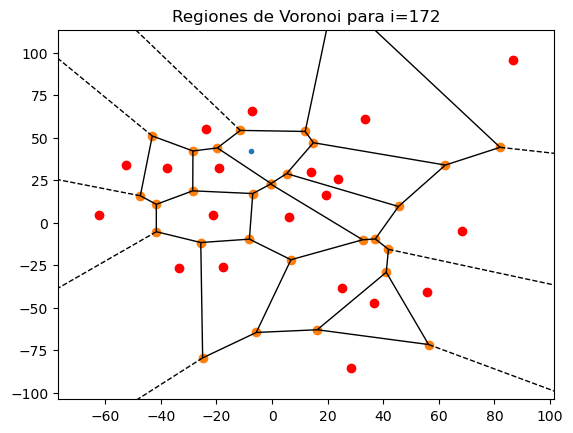

0.005448631726604943 171


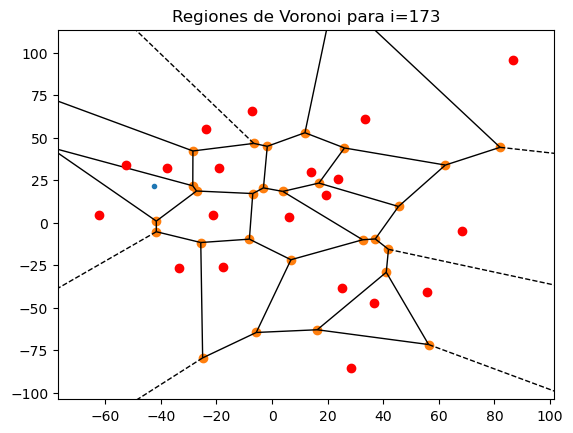

1 172
63943.93300352564 71


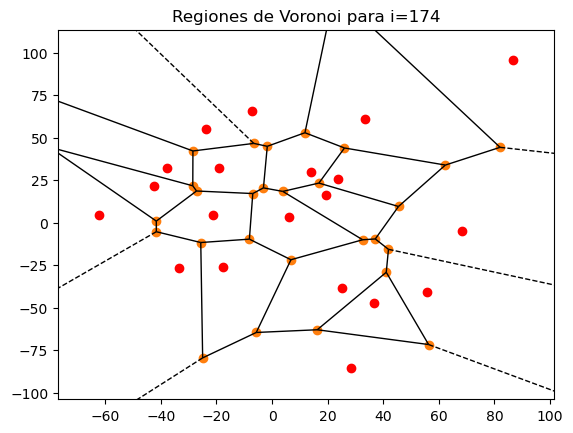

0.010190758214795552 173


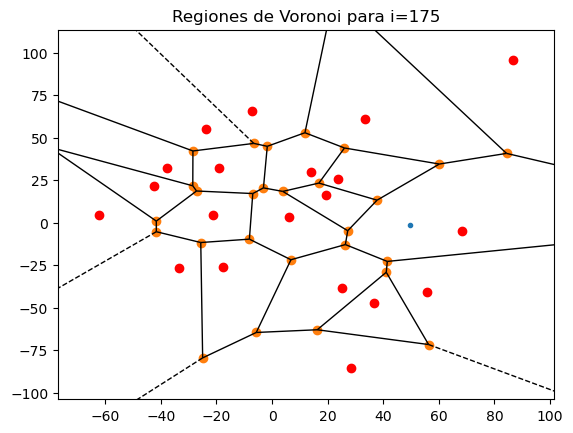

0.00016509016627306826 174


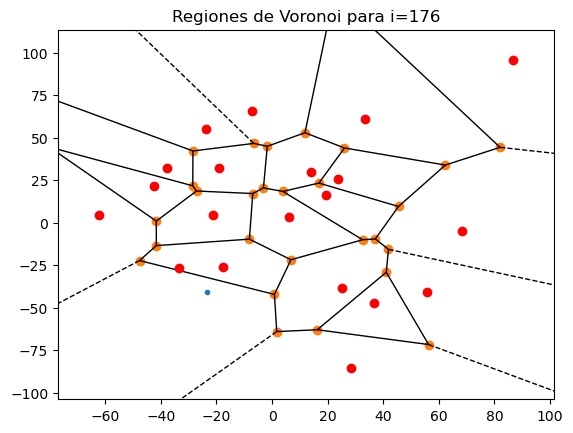

0.3736284279068353 175
23891.27116228729 72


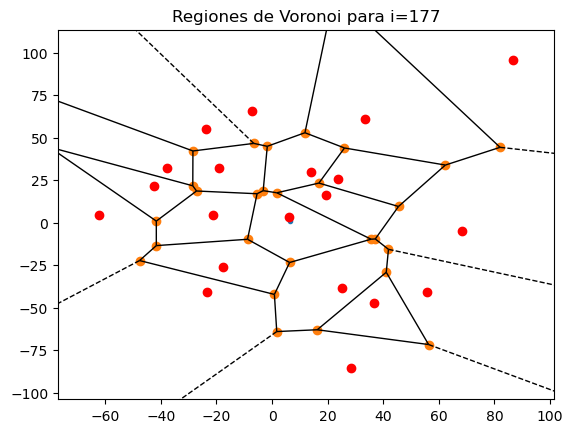

0.0001312324139198082 176


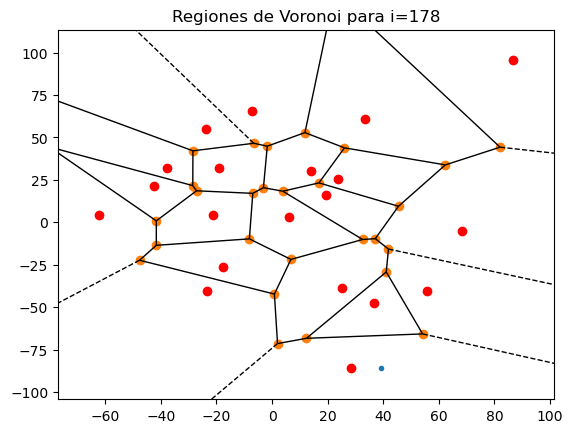

0.14382295373902595 177


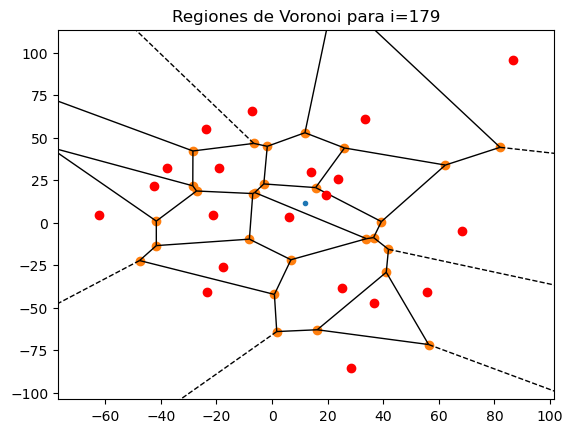

0.0026416499539480766 178


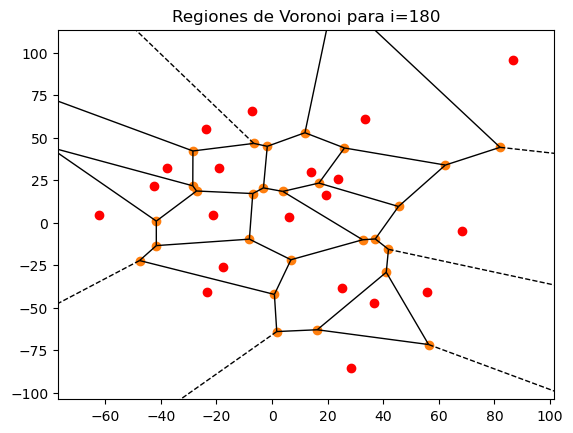

0.026116244674764037 179


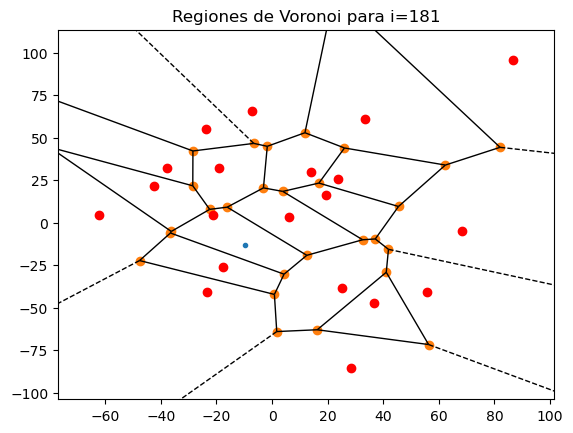

0.06672690326327145 180
1594.190539682531 73


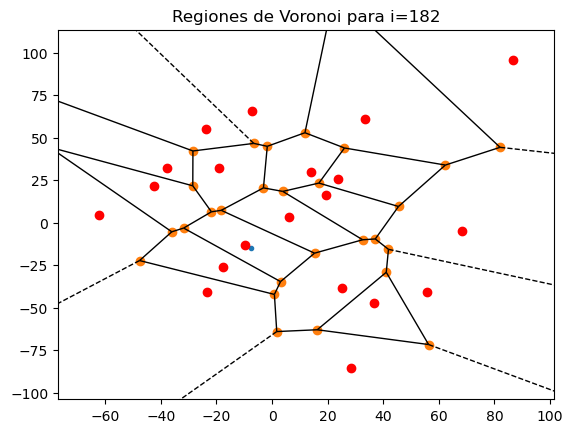

1 181
25821.471093774042 74


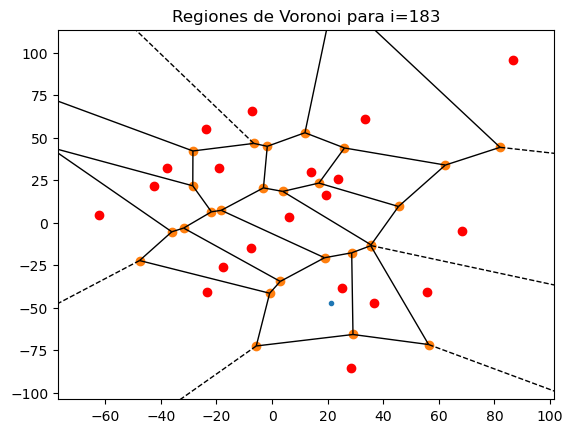

0.7264210071801022 182
18757.259038811233 75


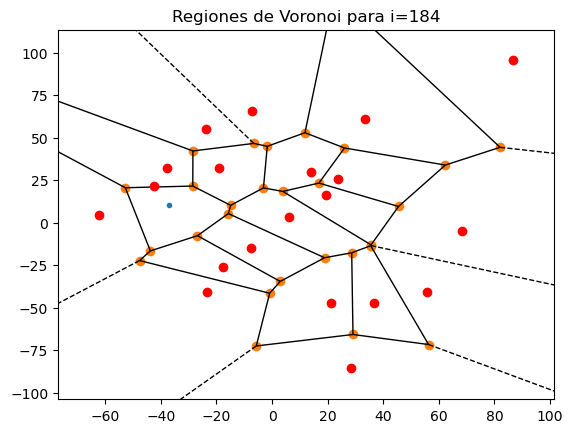

0.05774528480465691 183
1083.1432653508798 76


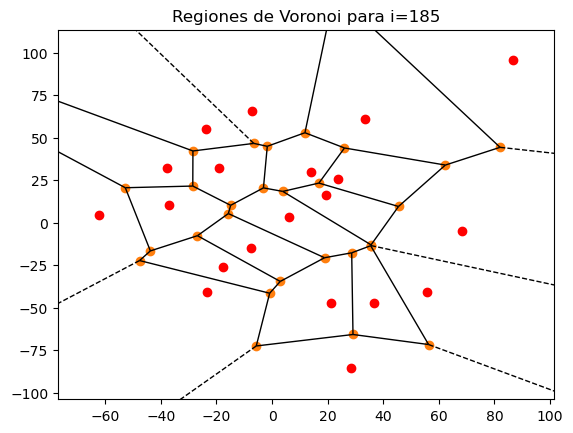

1 184
1984.7527457917427 77


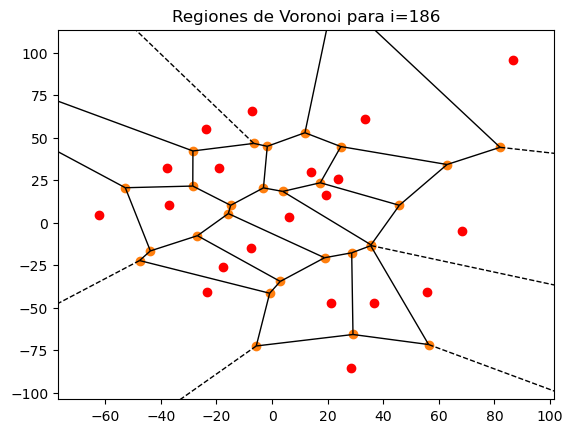

0.6948130041362353 185
1379.0320177712024 78


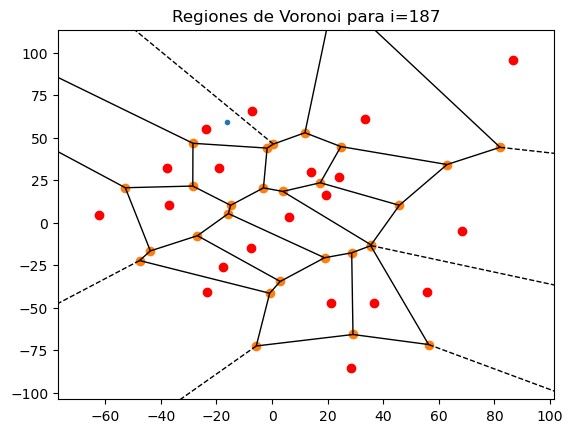

0.8010826392495615 186
1104.718608405803 79


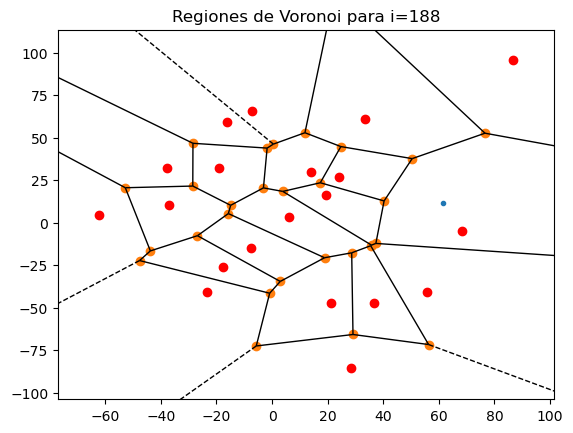

0.16510498678051228 187


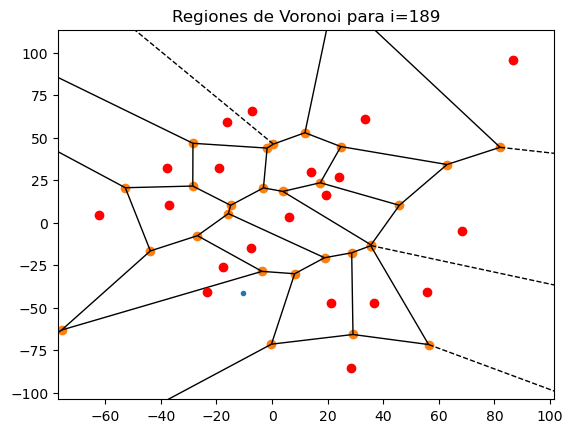

0.0022268987711427384 188


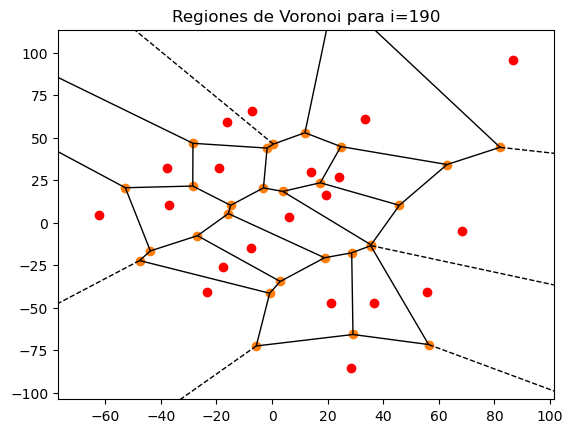

1 189
1105.989980303169 80


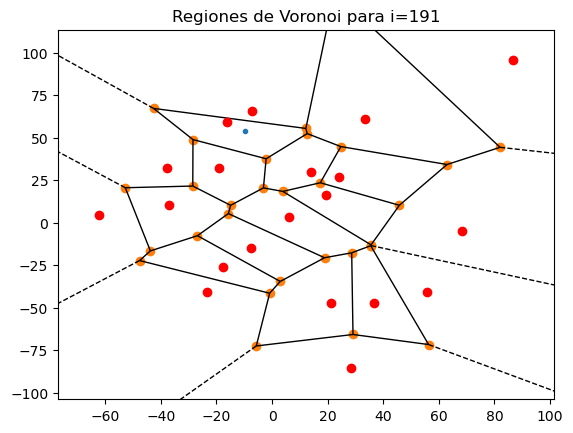

0.9991549138508196 190
1105.0553234896825 81


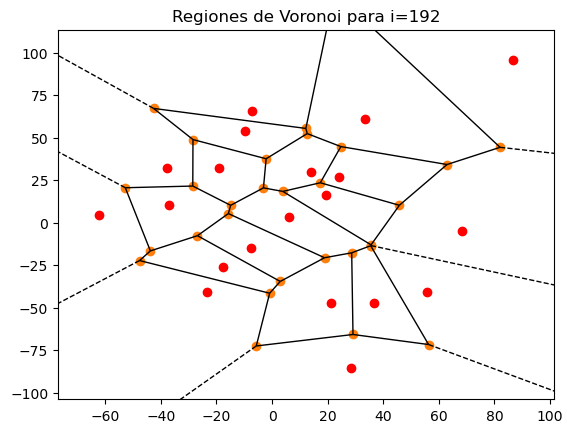

1 191
1108.0629479475688 82


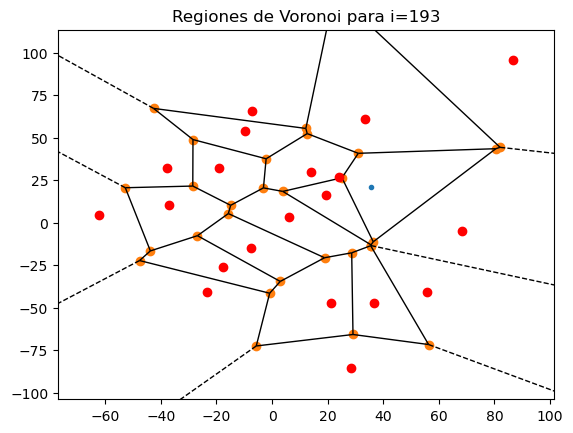

0.4043780544521492 192


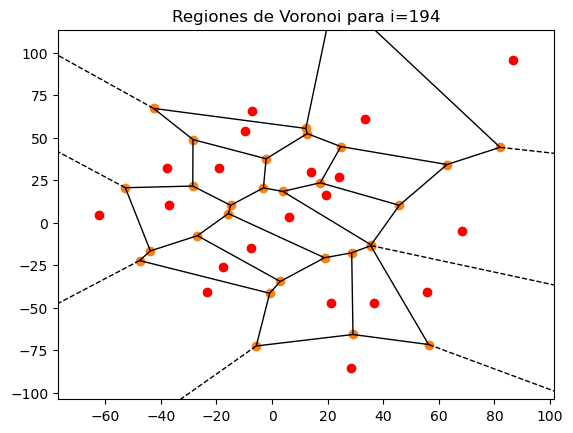

1 193
1108.0629479475688 83


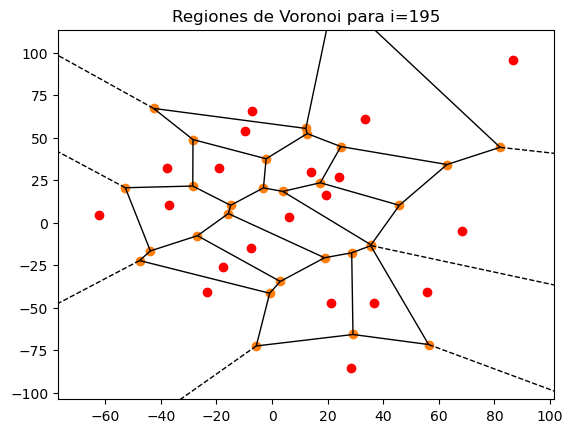

1 194
1108.0629479475688 84


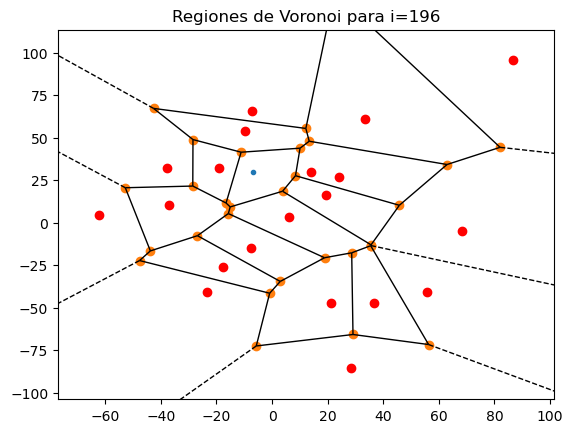

1 195
2869.523256602162 85


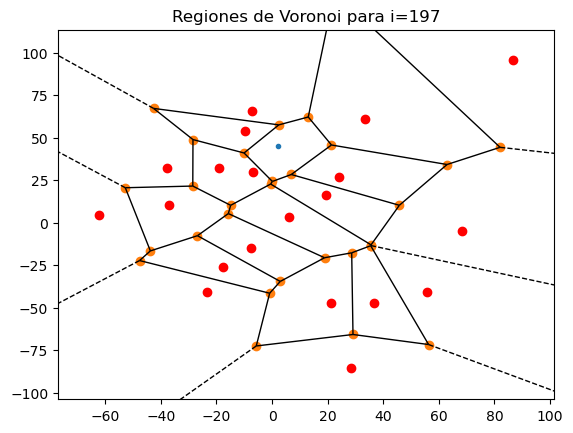

0.6610865080953356 196


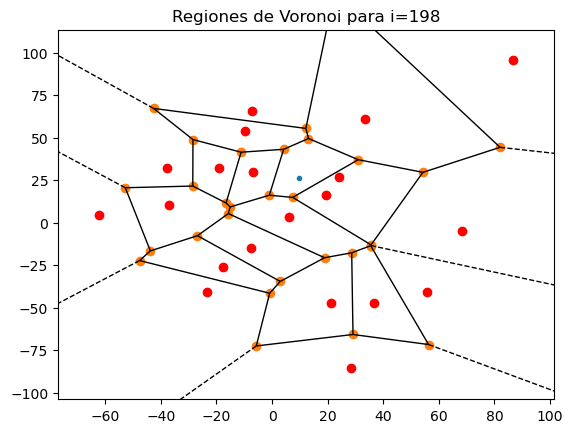

0.026453093588227616 197


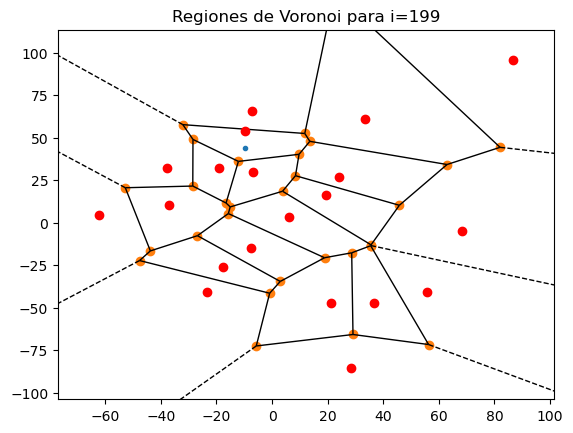

0.672708120229062 198
1930.3515959024166 86


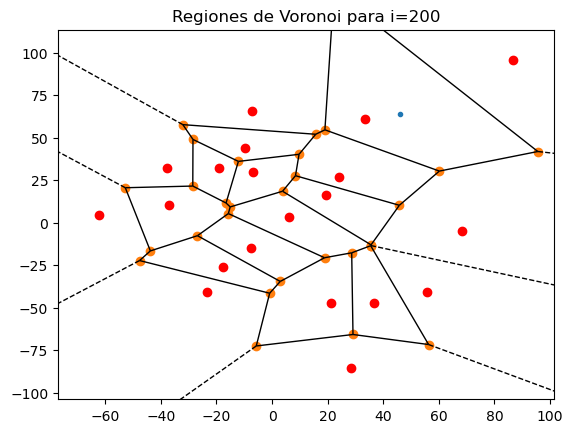

0.5979777241118631 199
1154.30725405343 87


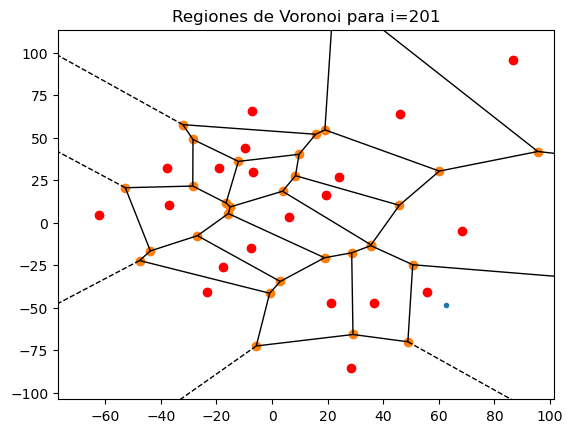

1 200
1659.1652577329994 88


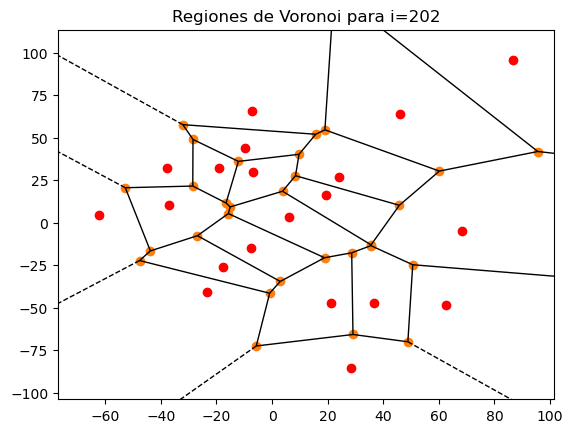

0.7069519043733955 201


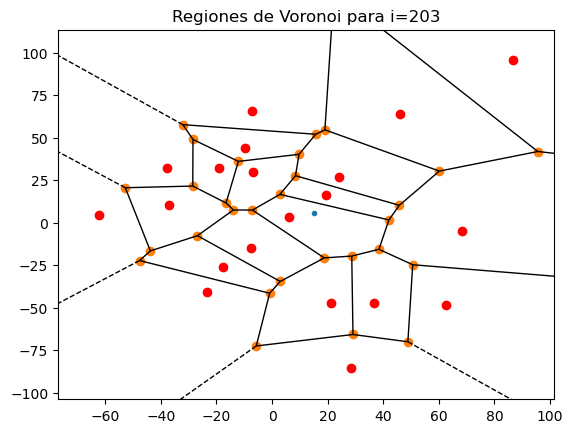

0.7655891556113481 202
1270.2389286874918 89


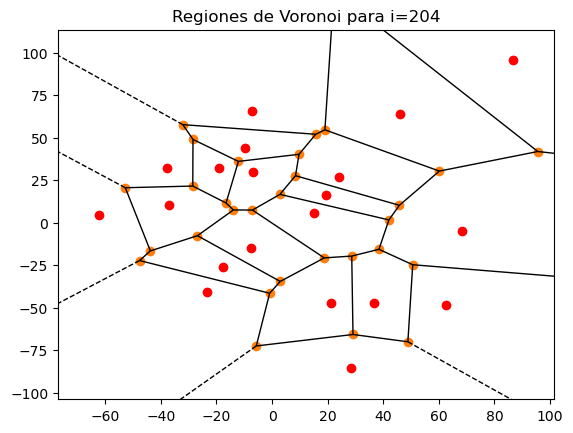

0.9633567811196743 203
1223.6932855932855 90


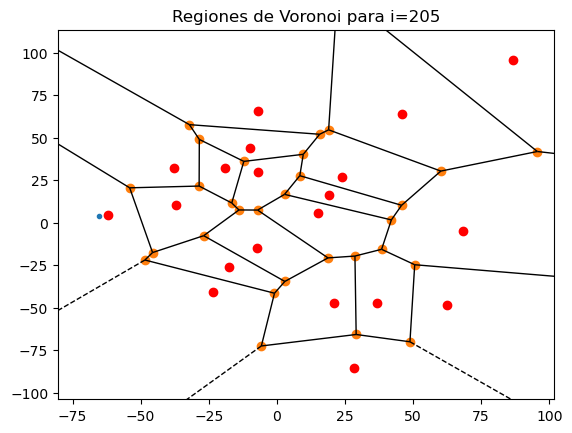

0.11032535099257791 204
135.0043912403401 91


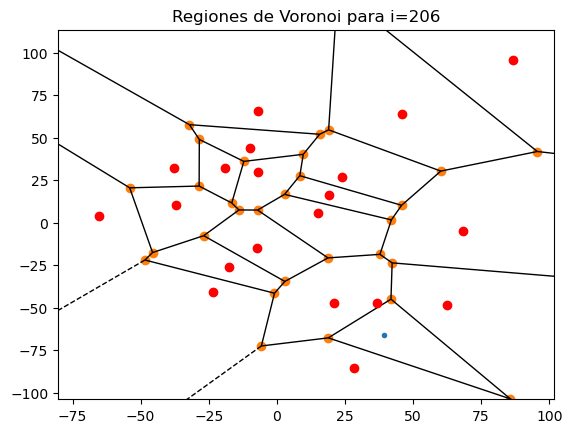

1 205
204.17712039044153 92


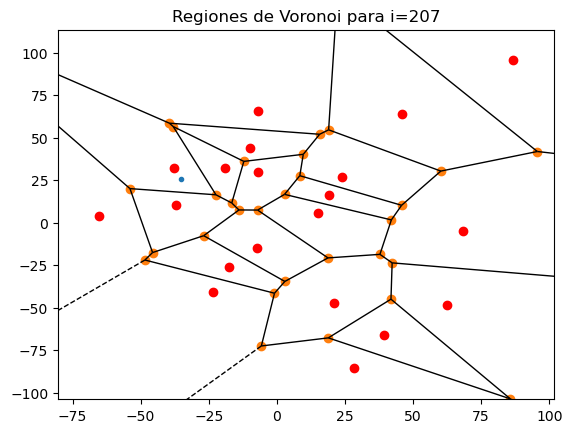

0.014833346700075889 206


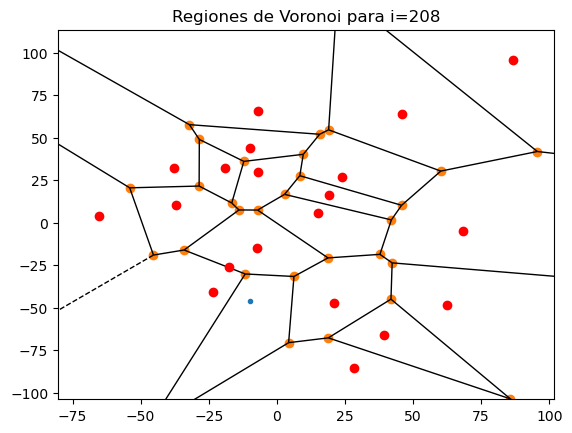

0.7632870402149795 207
155.84574990243766 93


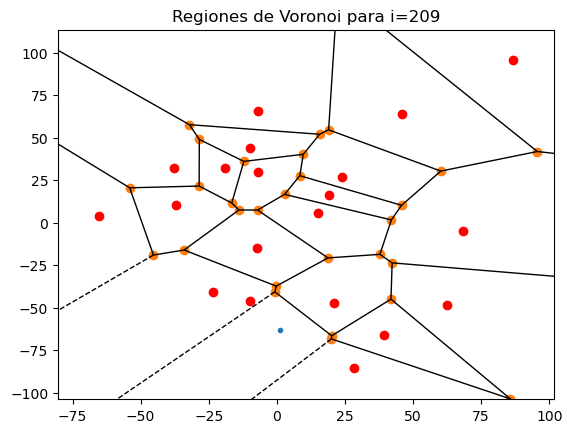

0.6045270931554408 208
94.21297816915046 94


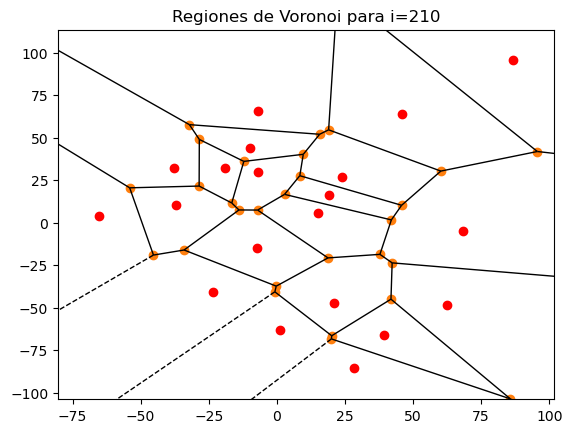

0.9424206802617898 209
88.78825897565993 95


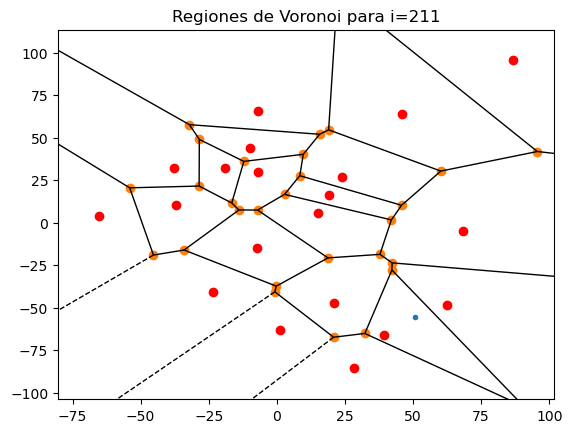

1 210
96.44114830746082 96


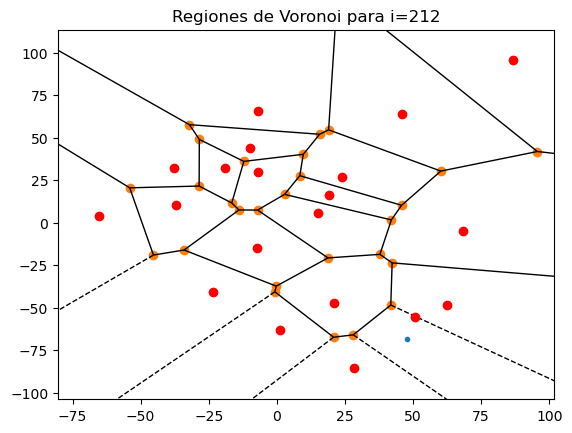

1 211
154.6104816888903 97


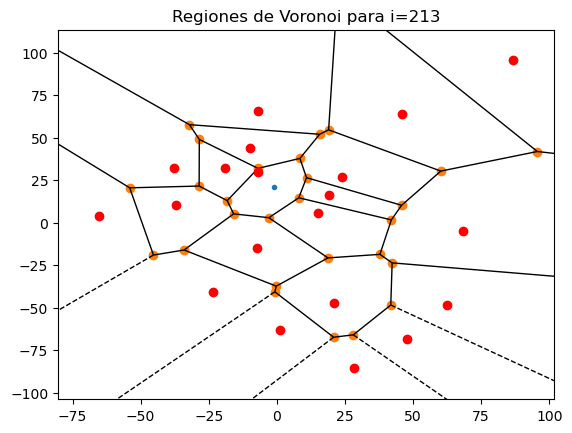

0.0428764588857568 212


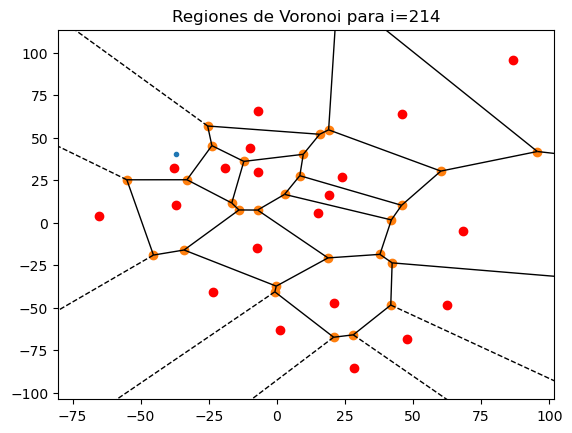

0.07669694682416041 213


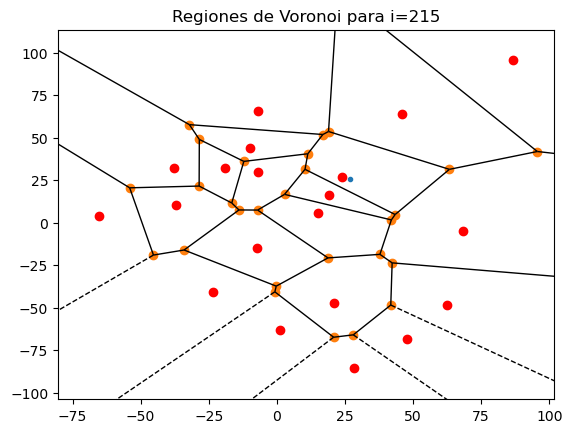

1 214
330.39630049462147 98


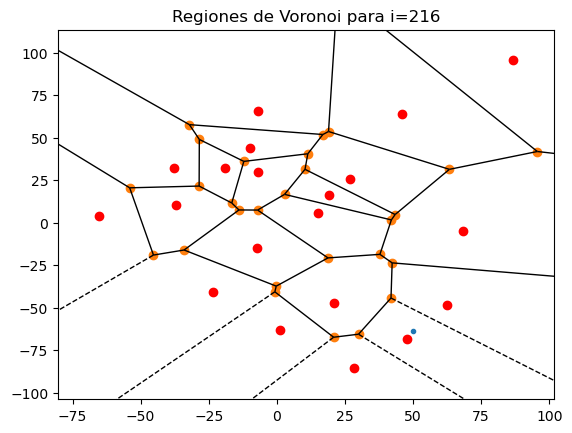

1 215
390.4132341527132 99


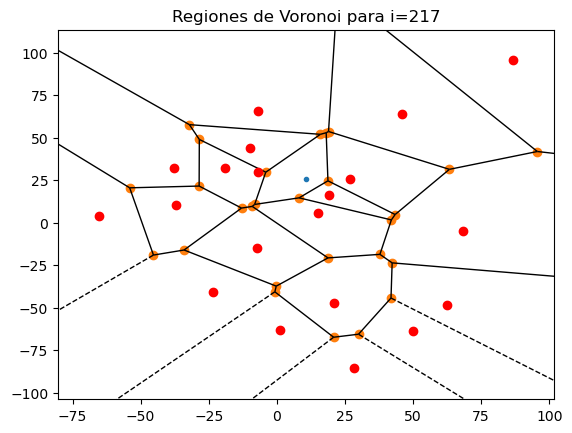

0.002558645933521559 216


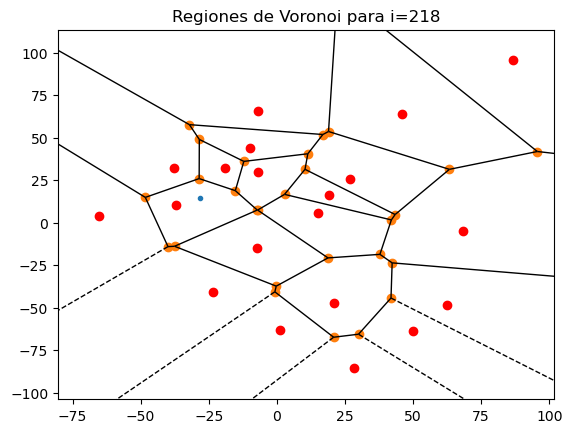

1 217
394.94487262891545 100


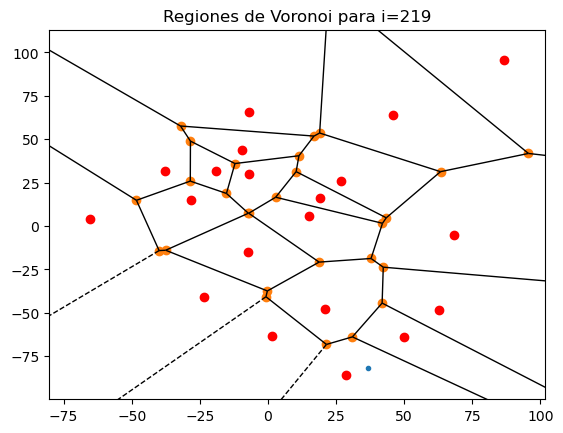

0.11923159002945587 218


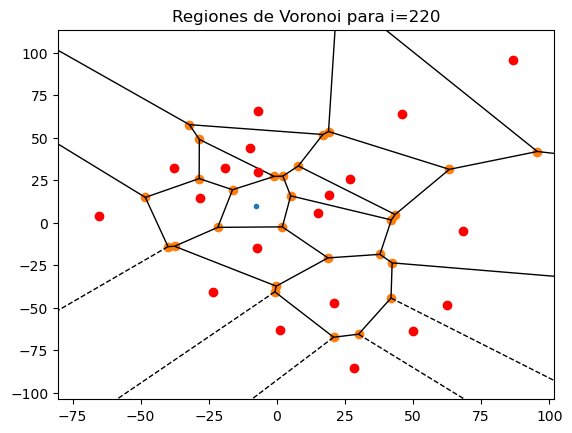

0.2380648317515547 219
94.02248465354197 101


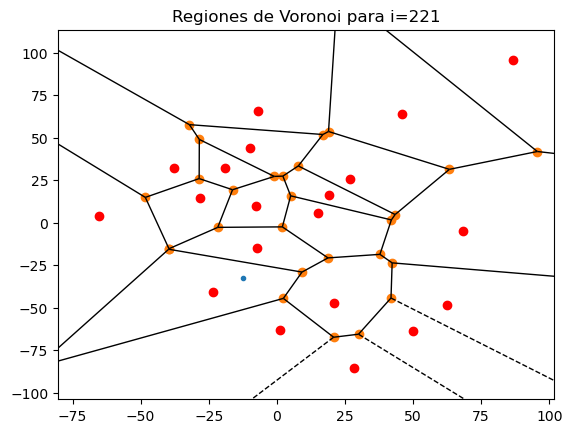

0.07143731572636294 220


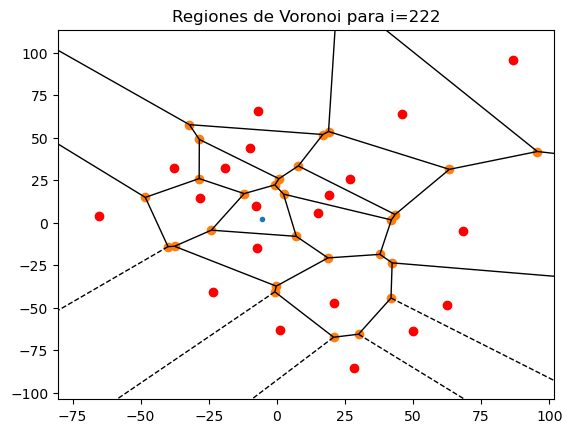

0.18995730886764986 221


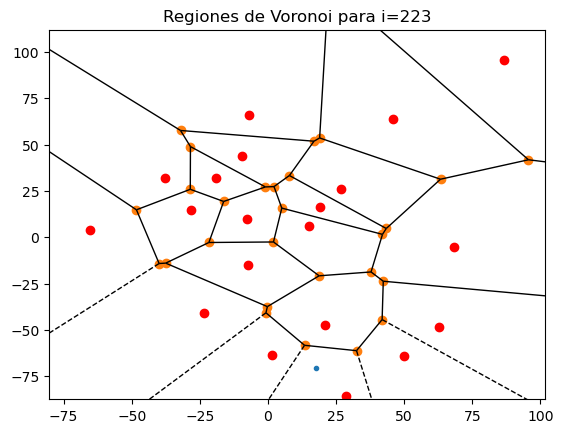

0.45934630134337723 222


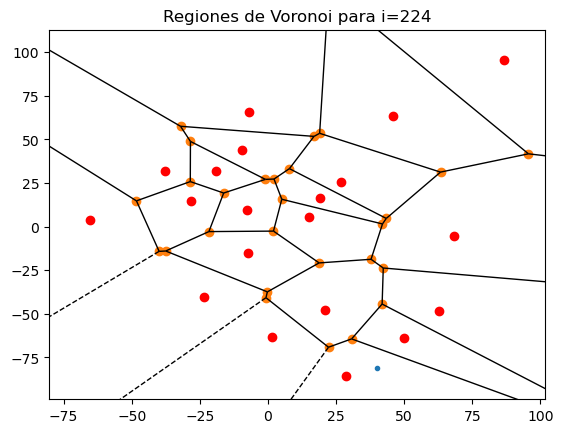

0.27948419725073126 223
26.277798646914373 102


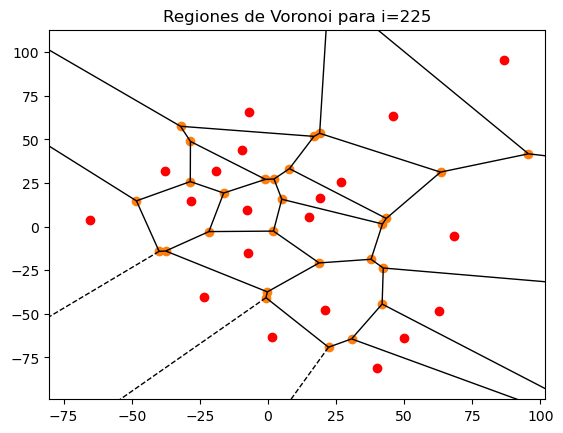

1 224
4383.5972212477 103


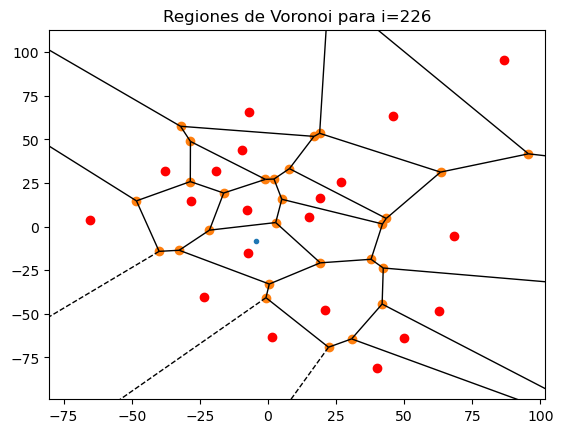

0.16340308688175176 225


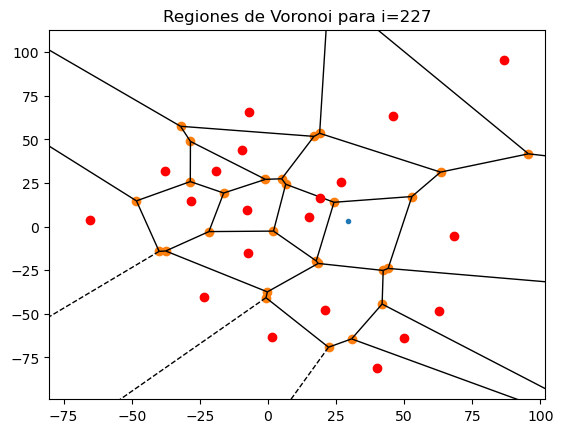

0.02340375950077996 226


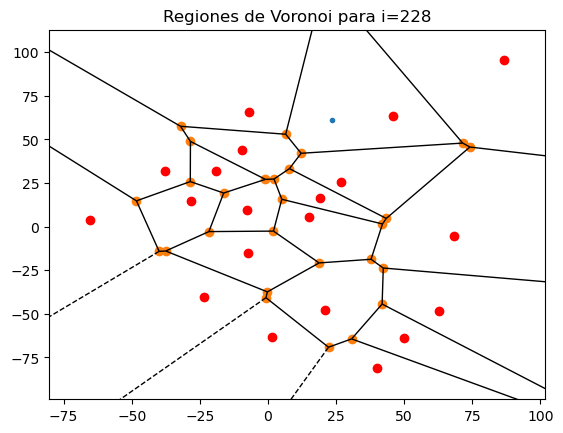

1 227
4383.889427613342 104


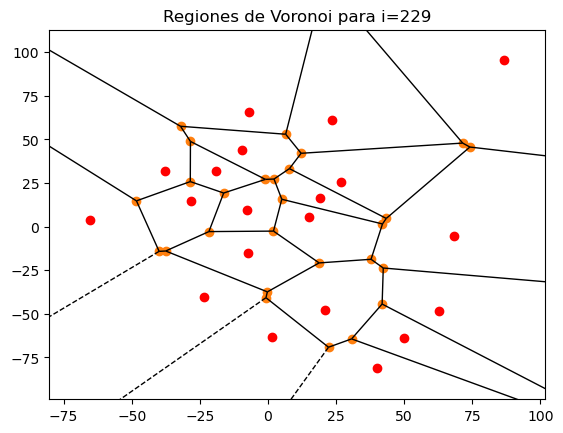

1 228
4383.909690758551 105


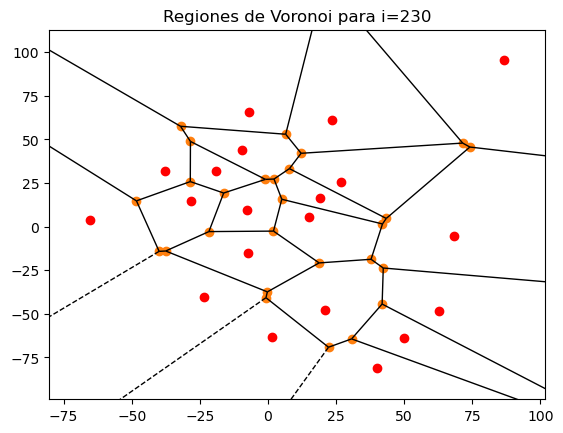

1 229
4383.909690758551 106


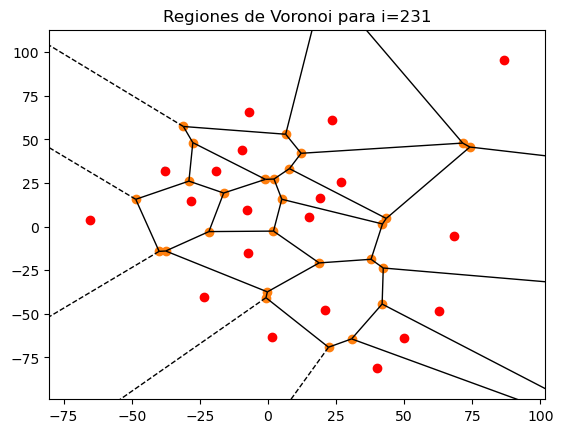

0.9979405300489151 230
4374.881160482164 107


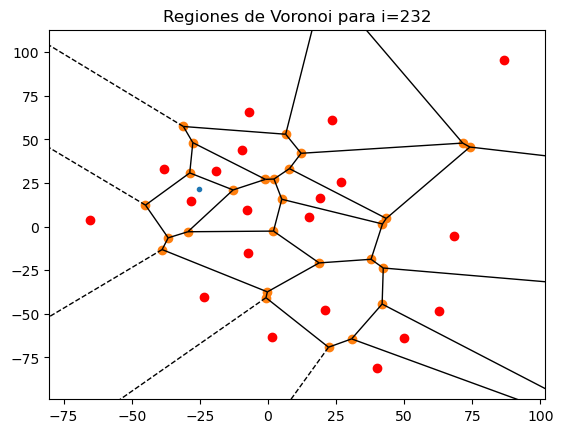

0.00956495982061715 231


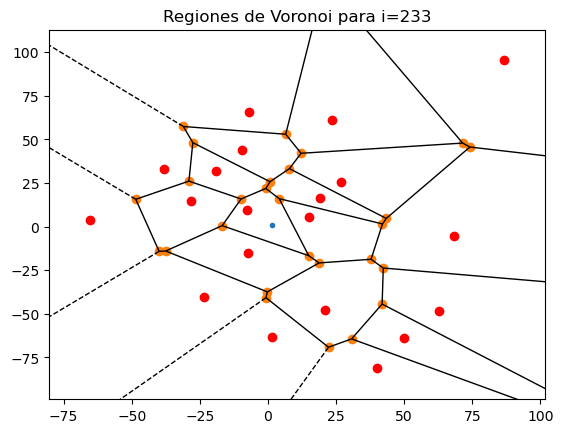

0.738978995598137 232
3232.945285834321 108


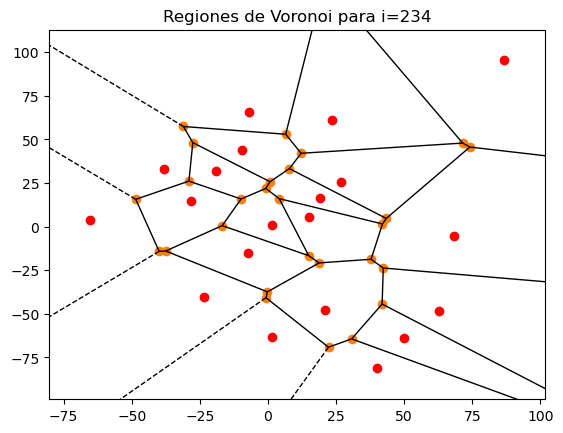

1 233
4375.137056635851 109


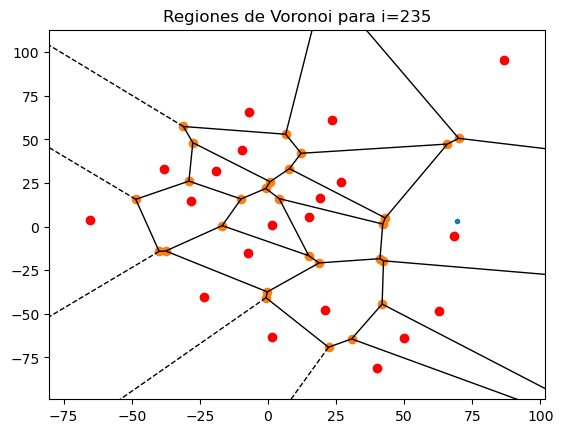

0.003089154684938213 234


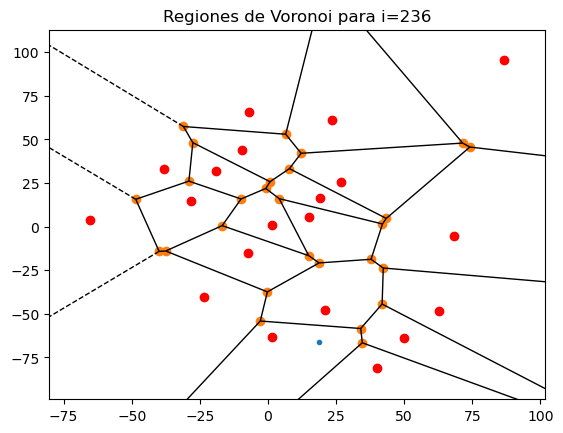

0.0002207112489157976 235


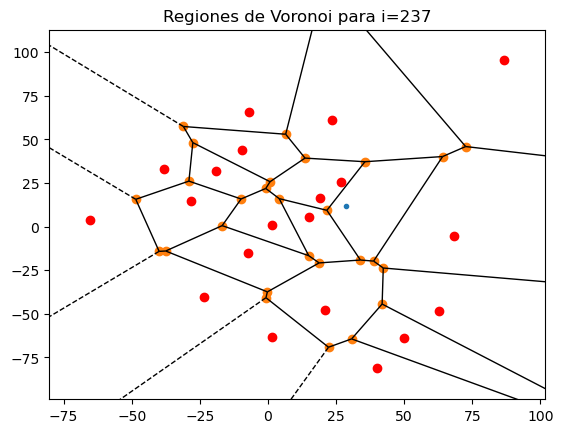

0.001022662929726572 236


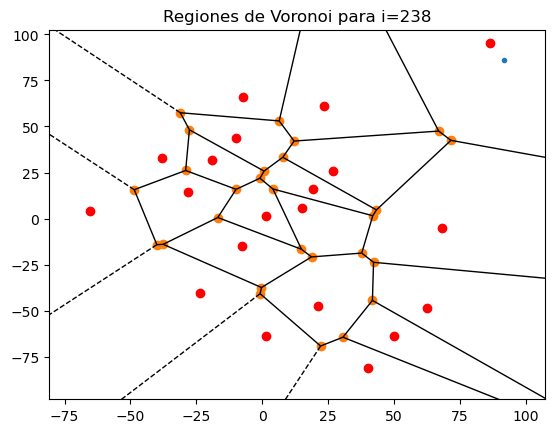

0.0004444893064092888 237


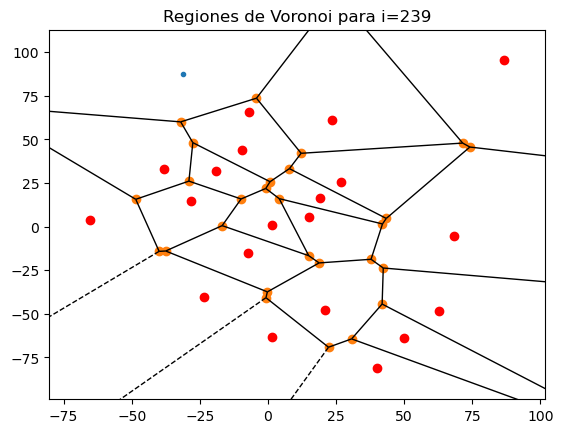

0.999945046478169 238
4374.896627446095 110


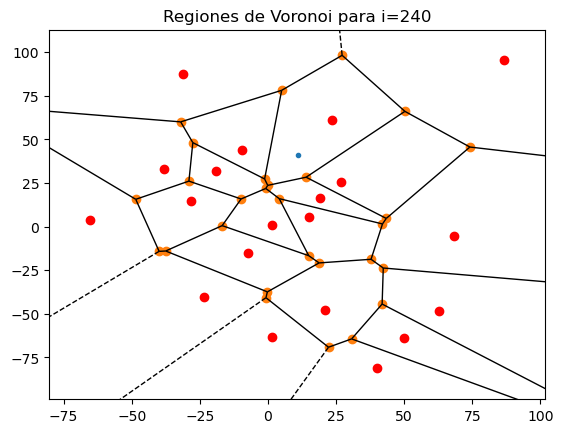

1 239
4388.122261927307 111


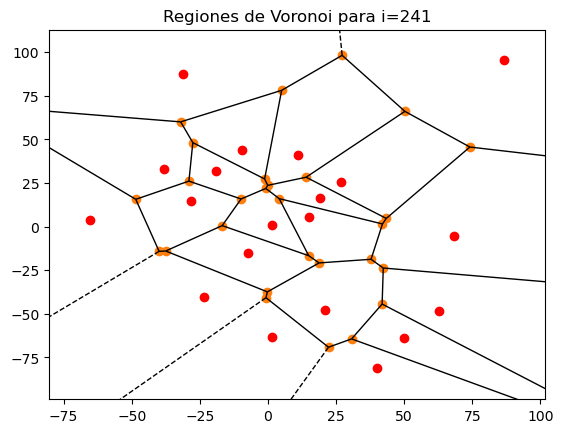

1 240
4388.169026479391 112


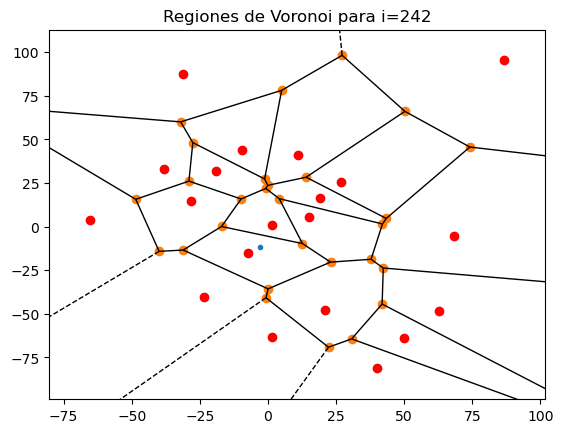

0.03748755532868275 241


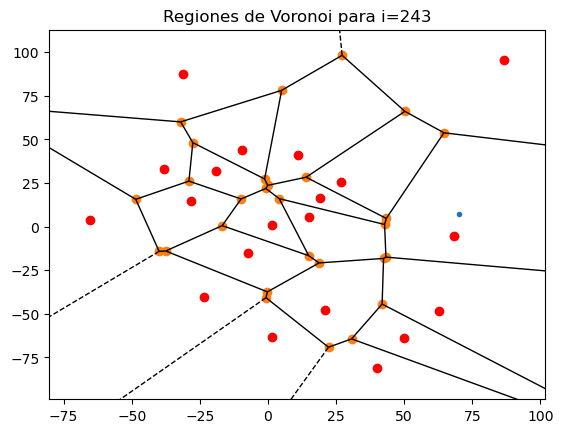

0.003451557160814343 242


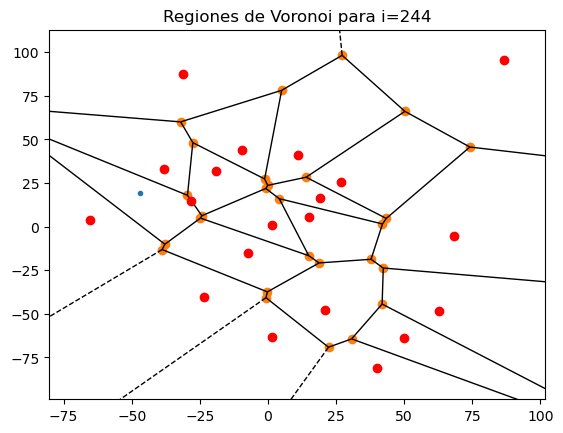

0.0073457869917325615 243


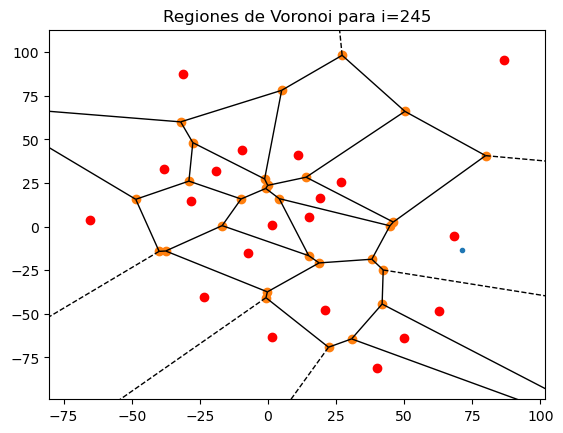

0.9996749667046462 244
4386.742725440145 113


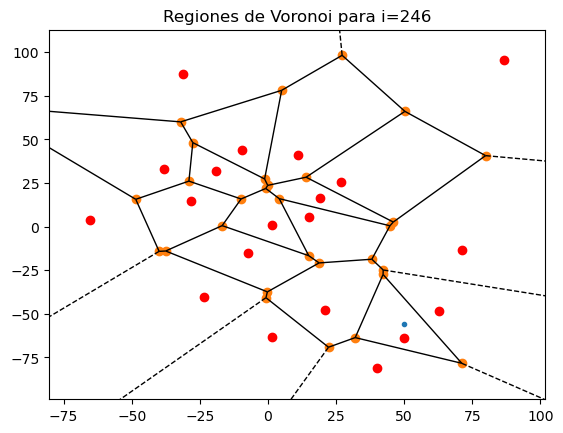

0.0052592616727801834 245


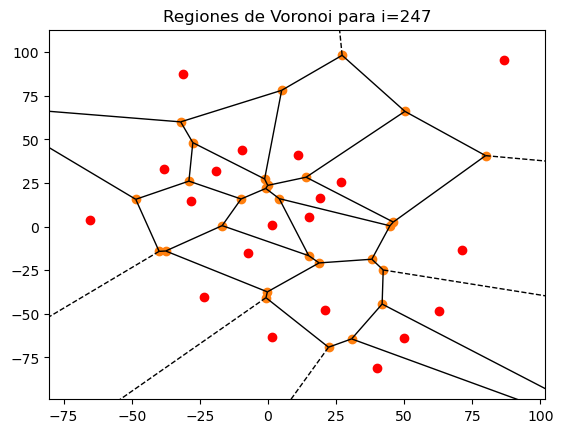

0.9999900172811754 246
4386.6989338209605 114


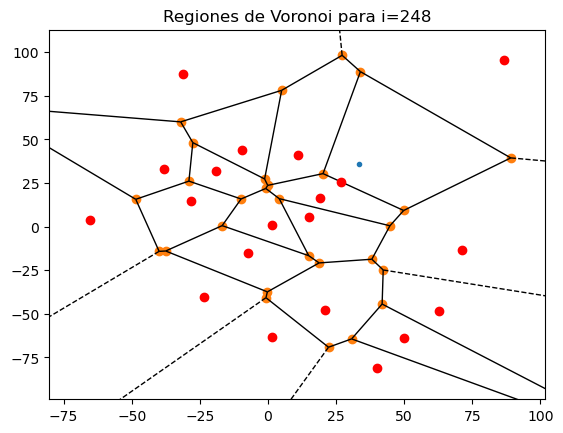

0.012538457125836398 247


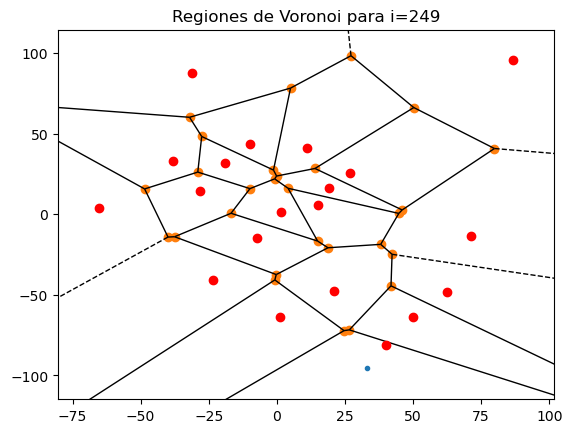

0.001222103192178641 248


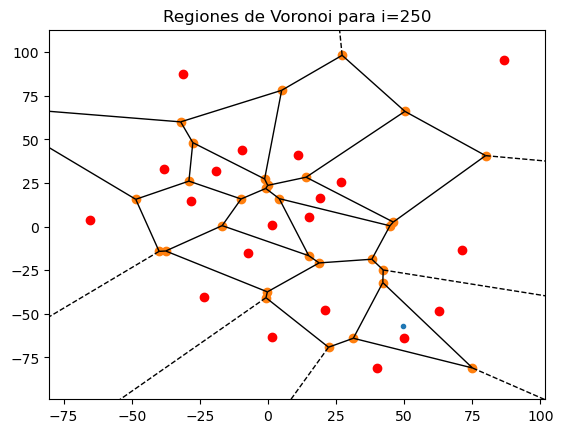

0.005249688987159681 249


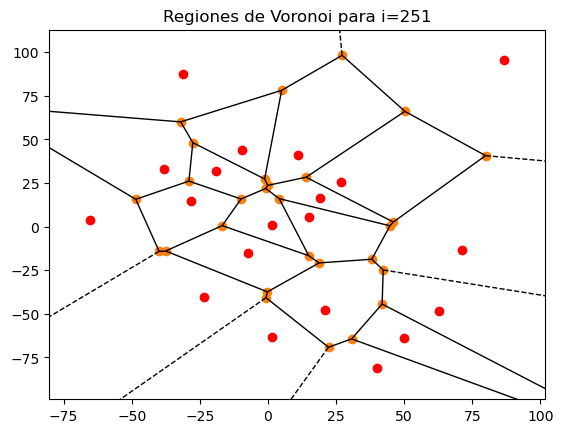

1 250
4386.6989338209605 115


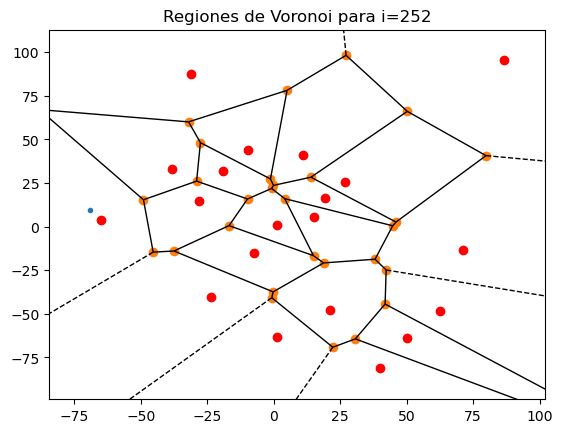

0.0014549041831228436 251


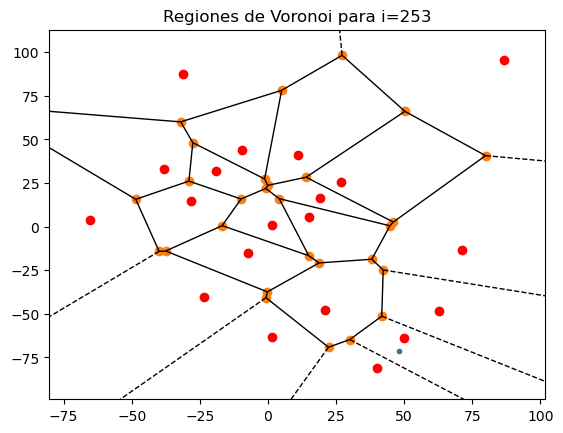

1 252
4388.5655178082725 116


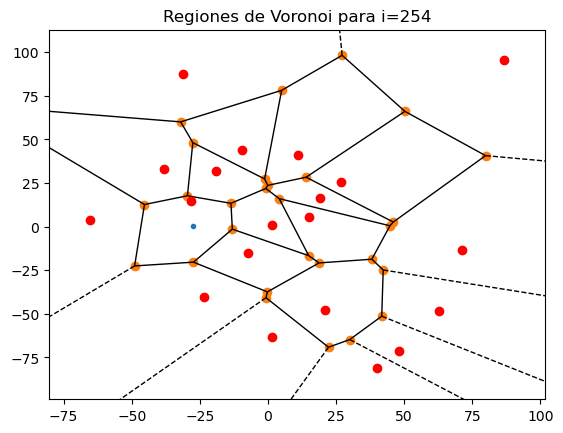

0.026164157327926815 253


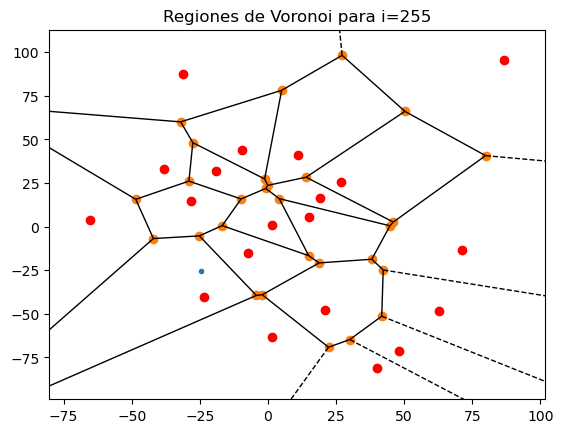

0.003163104547871133 254


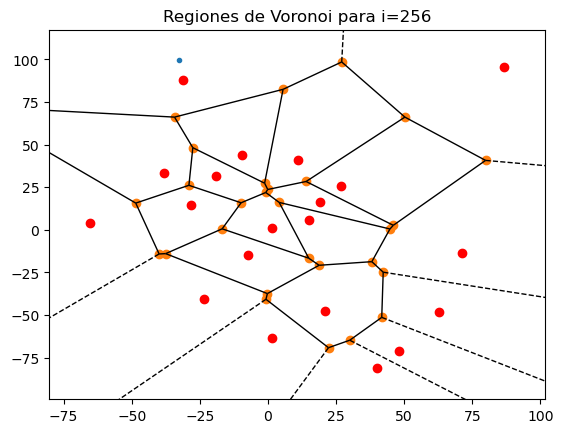

1 255
4395.456523529341 117


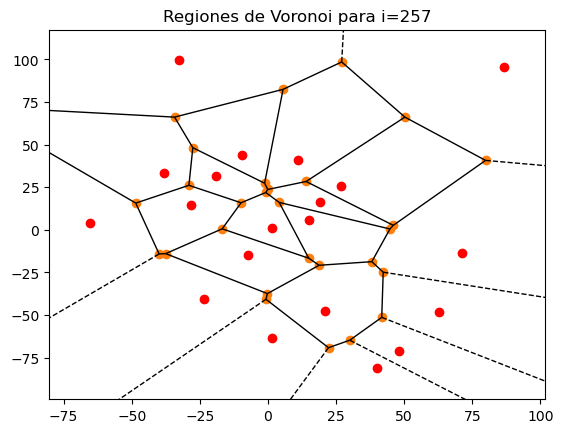

1 256
4395.458742882395 118


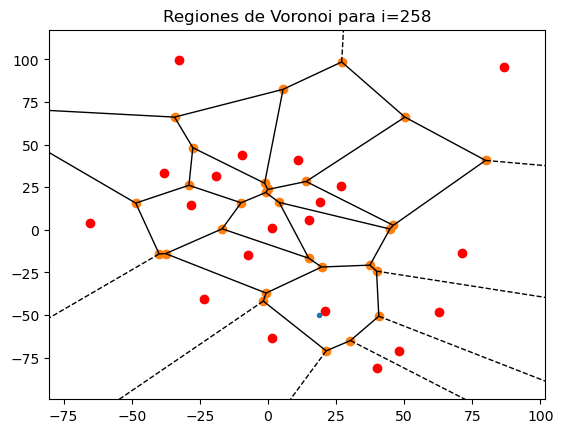

0.37614358280807975 257


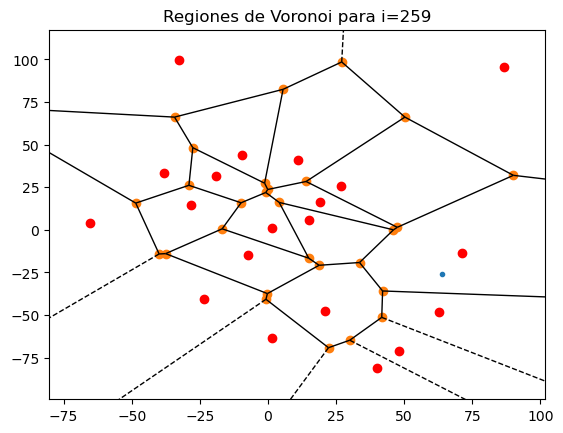

0.0037975112479064917 258


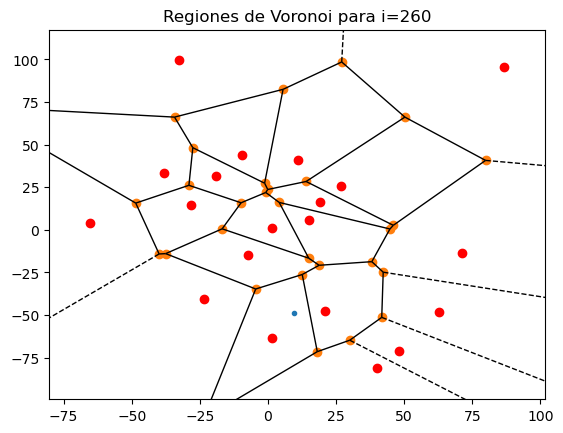

0.010187583956579638 259


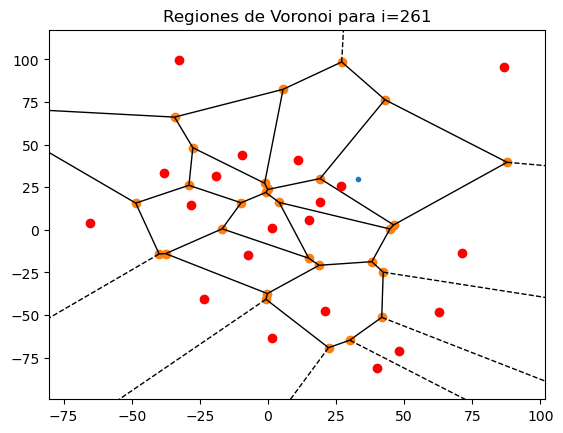

0.0019804876203400276 260


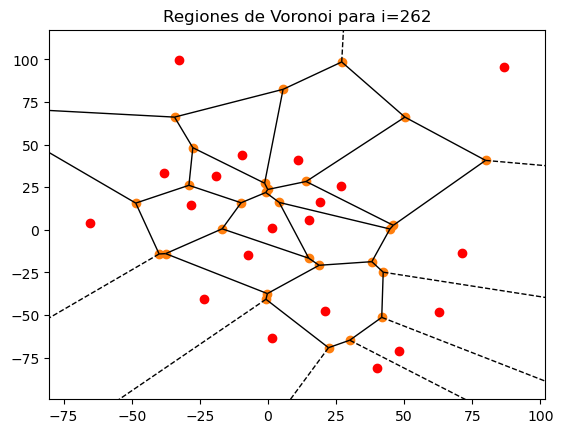

1 261
4395.458742882395 119


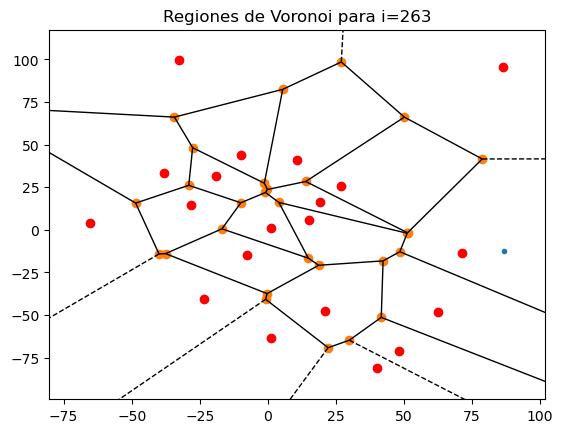

0.0013403291836732634 262


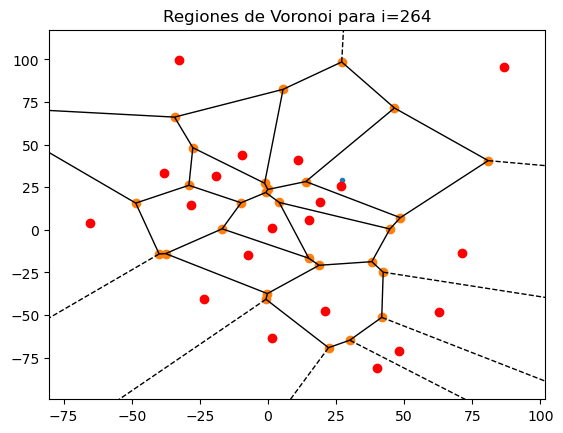

0.0020639704214281836 263


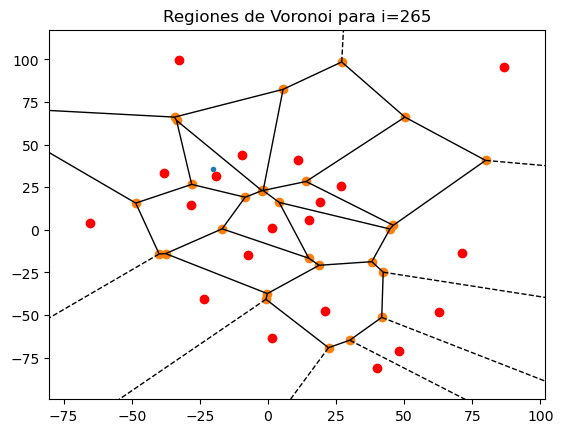

0.09072150053661636 264


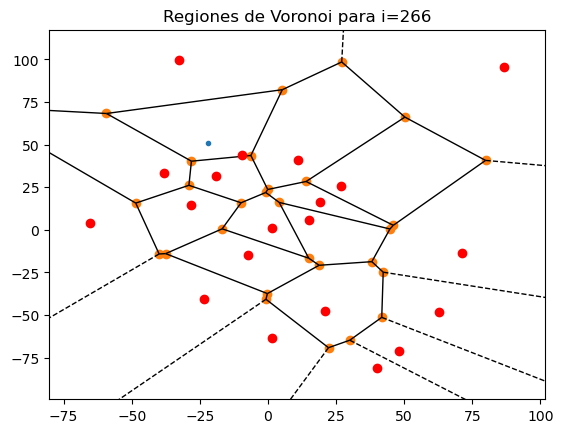

0.9988913478780599 265
4390.585708220198 120


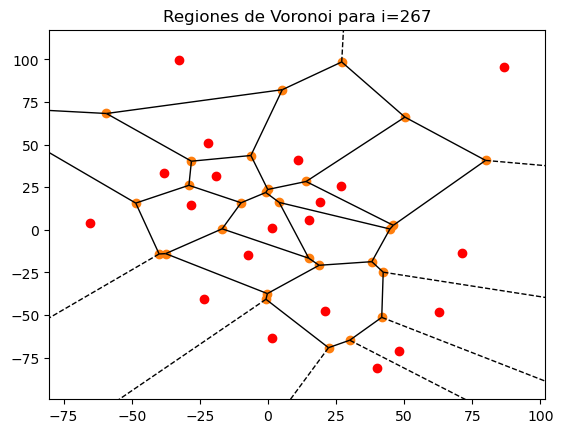

1 266
4393.070893840454 121


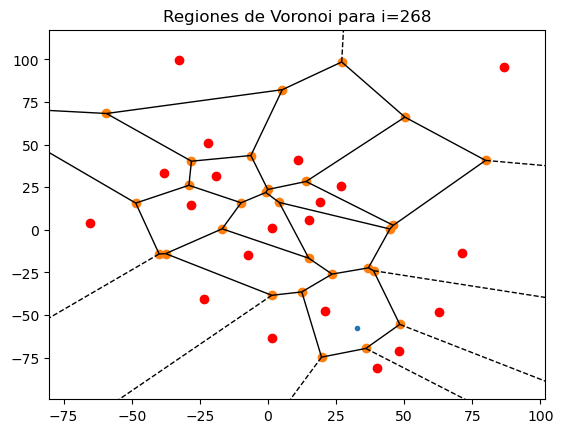

0.007876923246249126 267


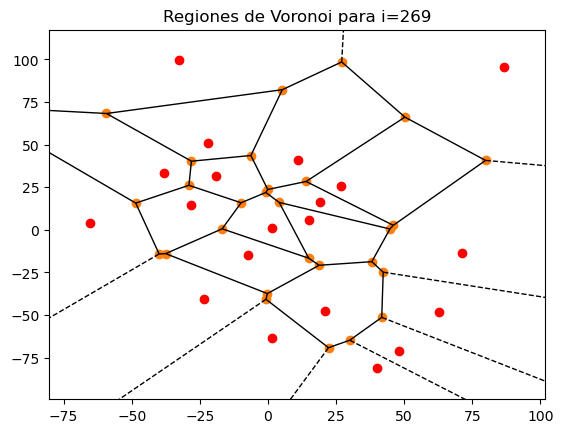

1 268
4393.070893840454 122


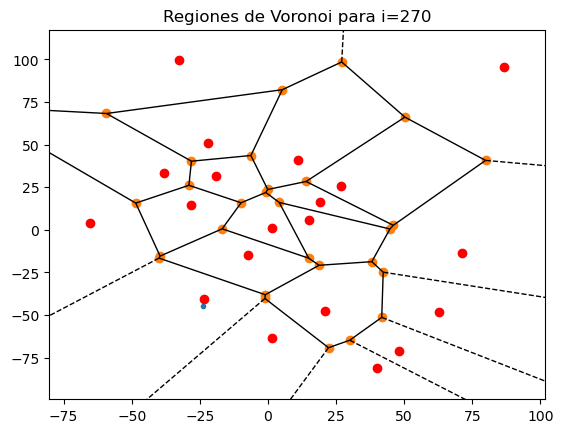

0.007937371513052804 269


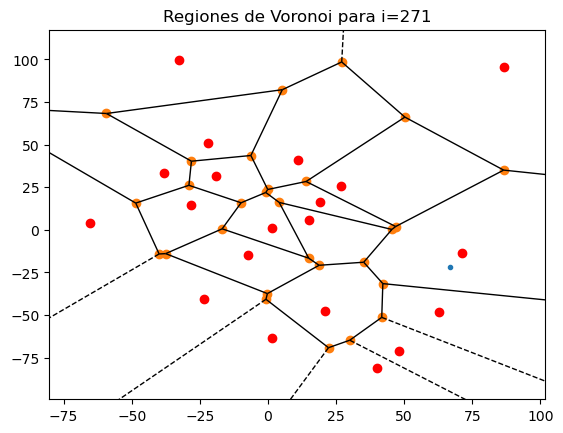

0.0062596938609097656 270


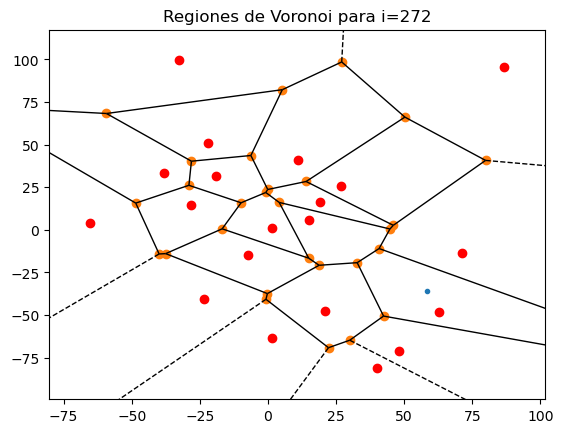

0.006236744084191413 271


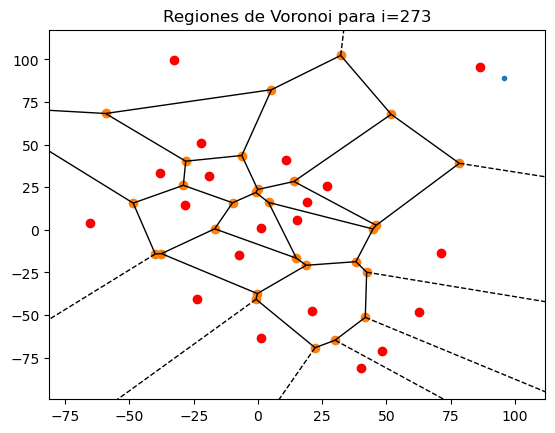

0.09216848445845685 272


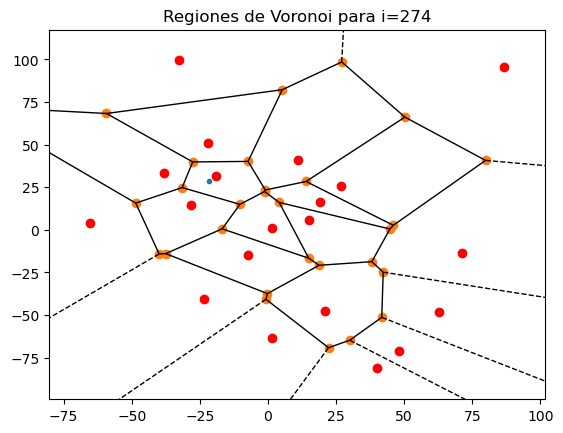

0.9980499139124852 273
4384.50402740891 123


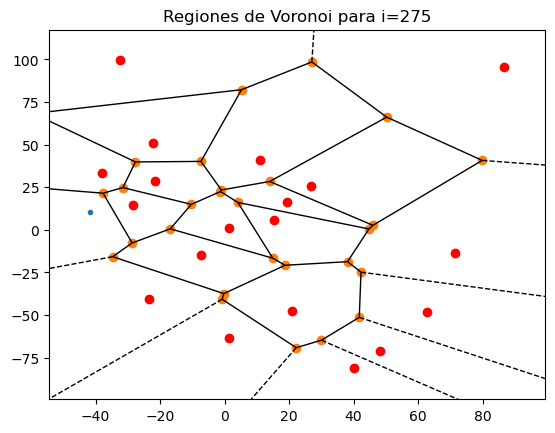

0.001163510598320509 274


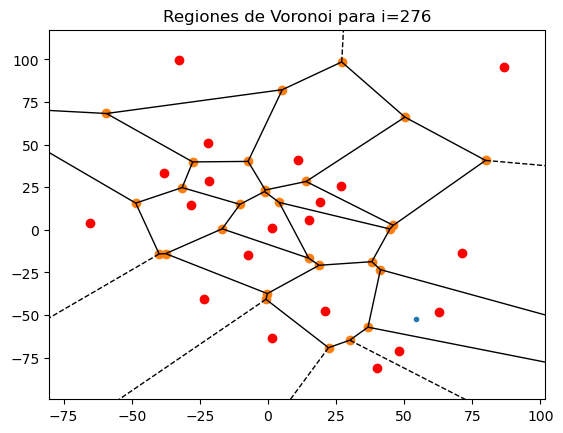

0.004666523246337364 275


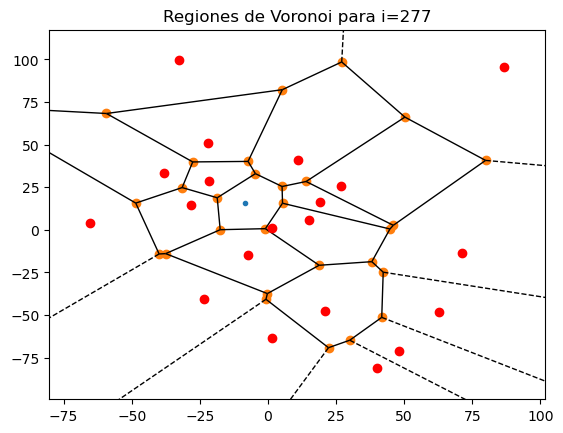

0.006877509012318889 276


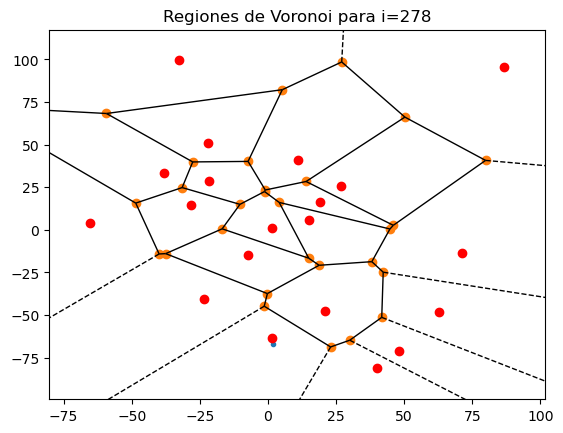

0.003246266344562674 277


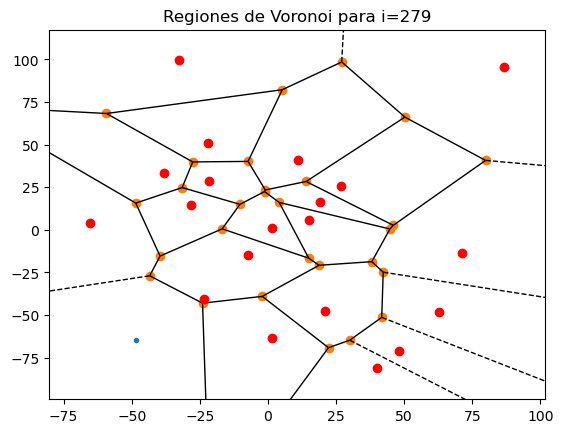

0.0008793024933979764 278


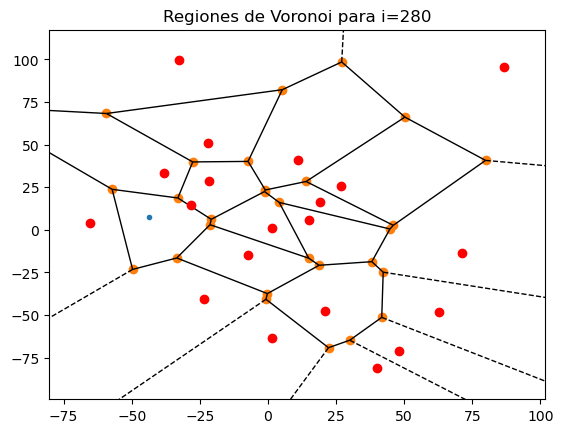

0.025618142439603697 279


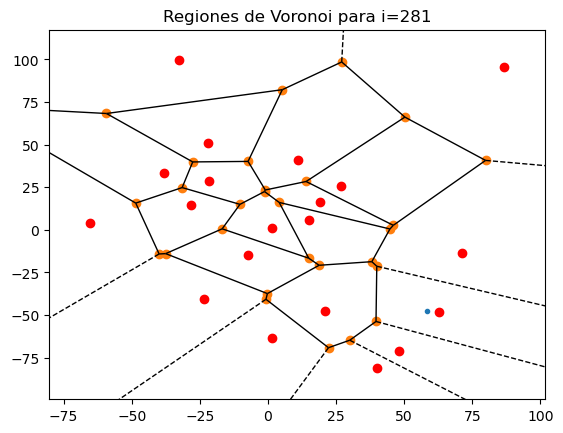

0.08869802212161777 280


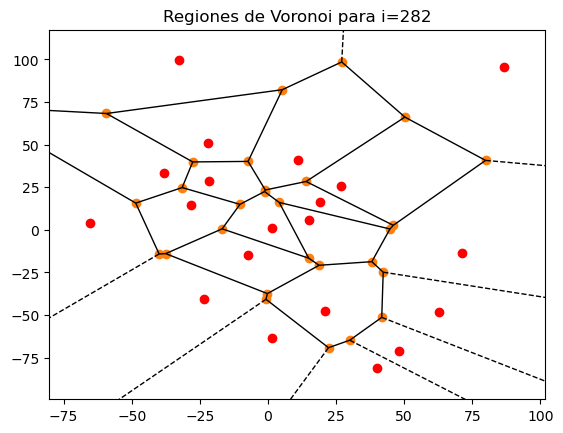

1 281
4384.610513290989 124


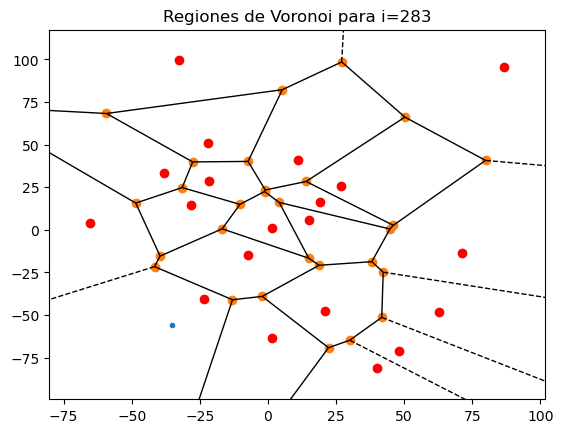

0.07101783854005722 282


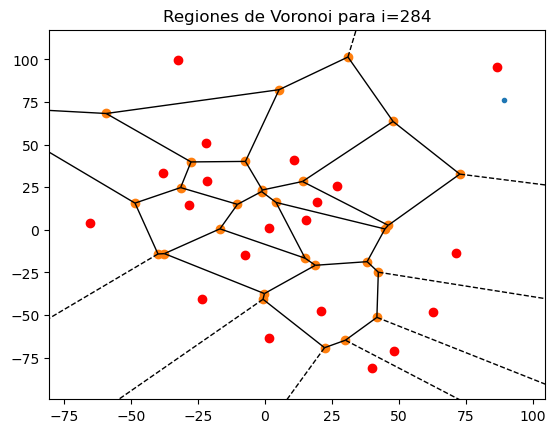

0.0007241564659381854 283


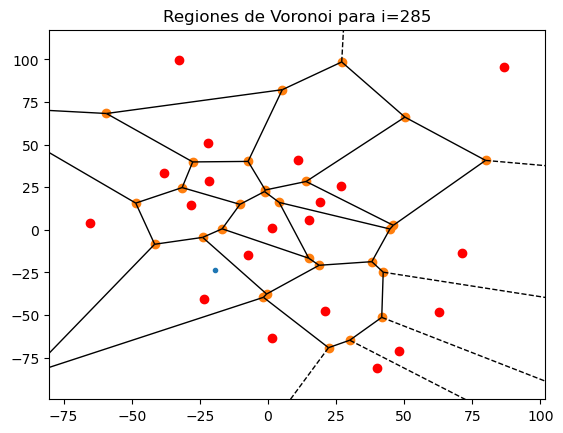

0.0010151938303605912 284


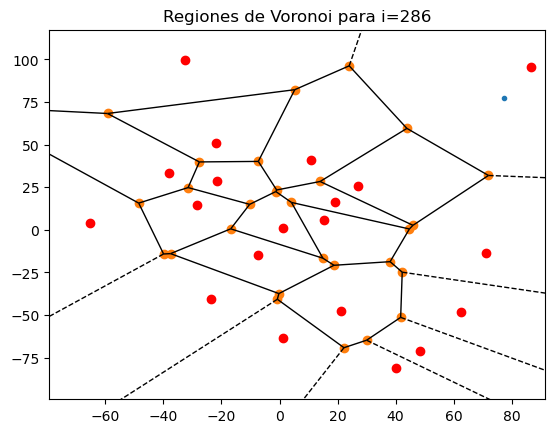

0.0004782057752595768 285


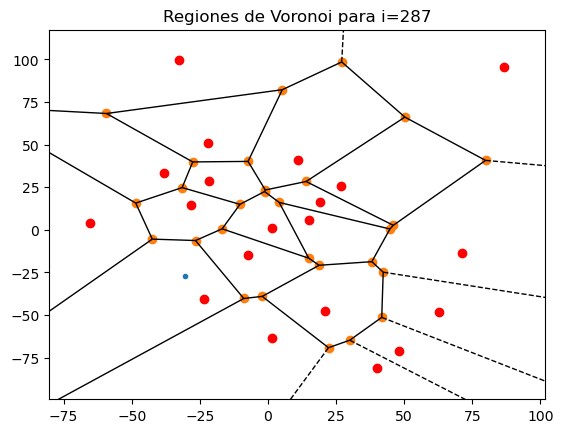

0.0009762806767162341 286


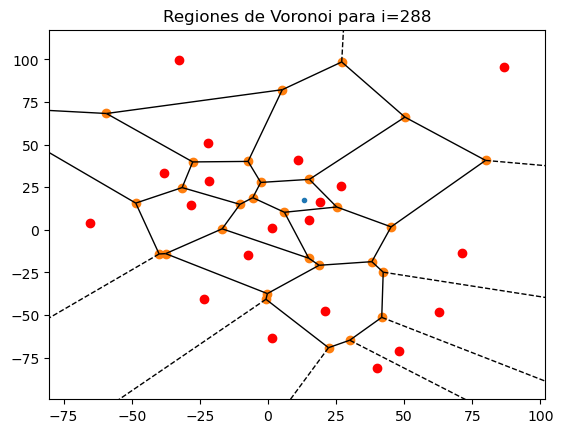

0.00347987166382212 287


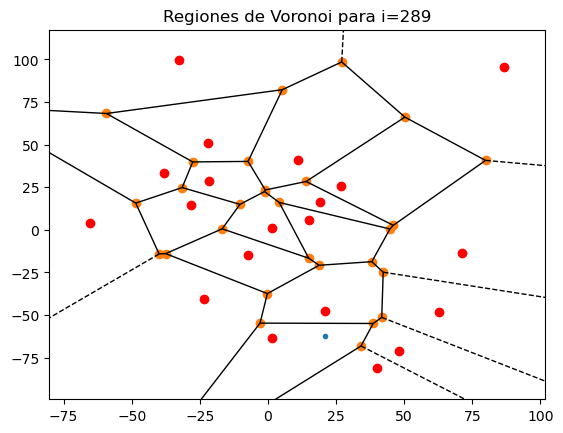

0.0014089382336567812 288


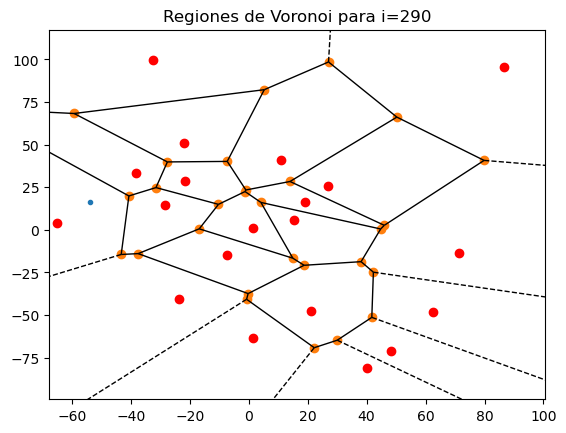

0.001051818588595542 289


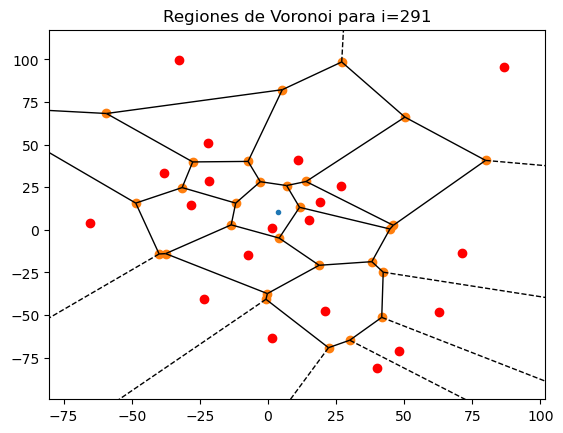

0.9997117044419577 290
4383.346449556261 125


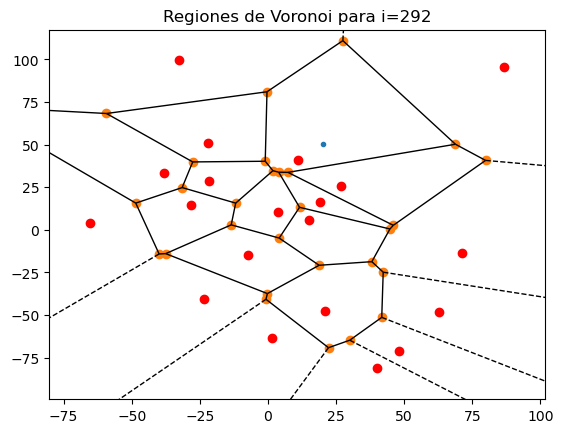

1 291
4415.446512874759 126


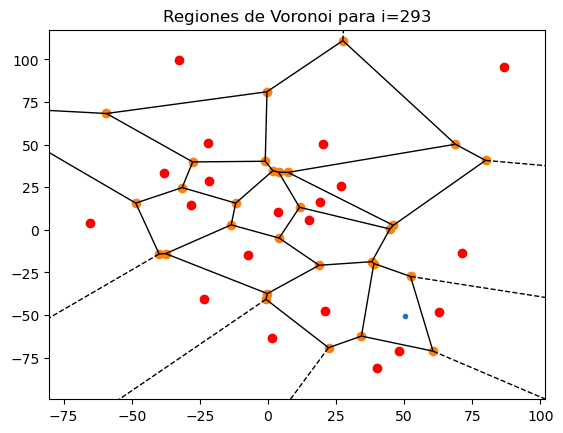

0.009569430456506135 292


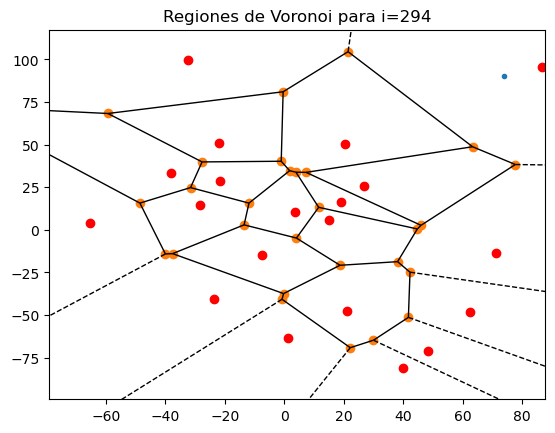

0.0007598471540817751 293


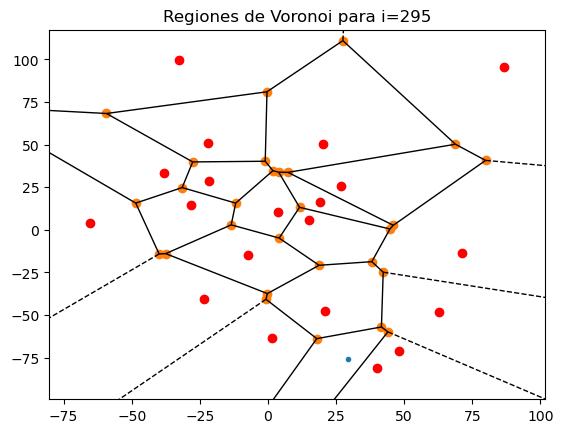

0.02206089865144981 294


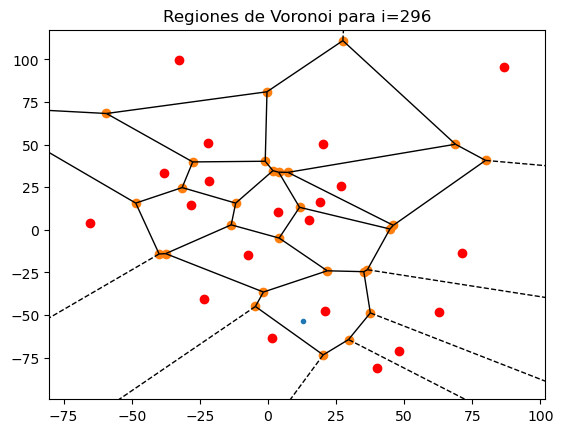

0.008425432660585345 295


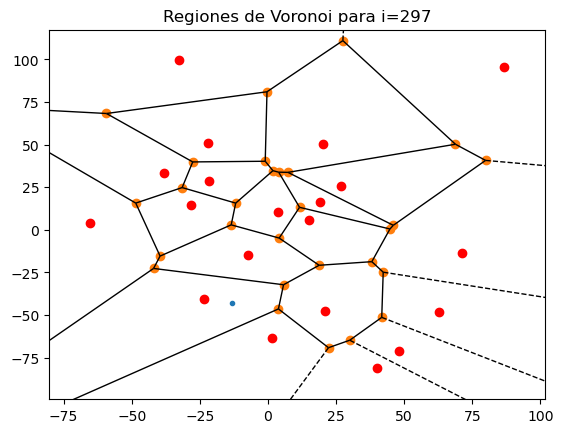

0.004675279139277507 296


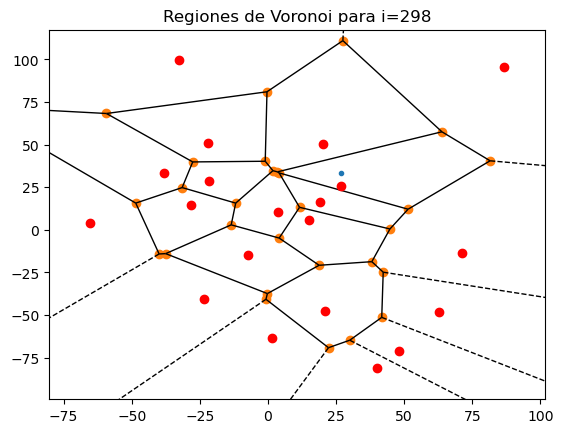

0.005254189491657053 297


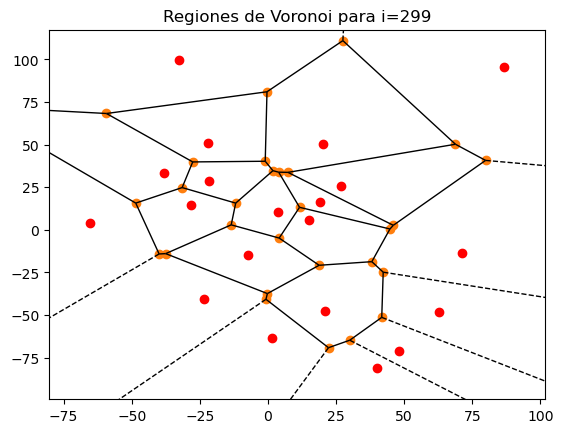

0.99828363749547 298
4407.868006039303 127


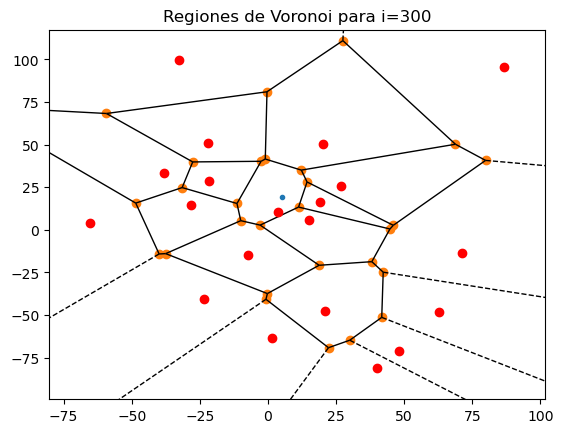

0.06056498329288136 299


In [42]:
def random_perturbation(point,idx,todoslospoints, scale=10,xlim=100,ylim=100,epsilon=10,delta=80): #La función de perturbación
    
    perturbation = point + np.random.normal(0, scale, point.shape) #El punto perturbado.
    puntossinpoint = todoslospoints.copy()
    puntossinpoint = np.delete(puntossinpoint,idx,axis = 0)
    dist = np.min([np.linalg.norm(perturbation-point2) for point2 in puntossinpoint]) #Para verificar que no está 
    #demasiado cerca de otra estación.
    
    if np.abs(perturbation[0])>xlim or np.abs(perturbation[1])>ylim: #Si es que se escapa del cuadrado inicial
      return point
    elif dist < epsilon: #Si dos estaciones quedan muy cerca.
      return point
    else:
      return perturbation

def plot_voronoi(vor): #Para graficar las regiones de voronoi
    voronoi_plot_2d(vor)
    plt.plot(points[:, 0], points[:, 1], 'ro')  #Pintamos los puntos de origen
    plt.title(f"Regiones de Voronoi para i={i+1}")
    plt.show()
    

points = inicializar_estaciones(N) #Distribución inicial de regiones.
vor = Voronoi(points)
inicial = vor #Se deja una copia de la distribución inicial para luego graficar y comparar.
num_iterations = 300 #Número de iteraciones.

j=0 #Un contador.
objs = [] #Para realizar programación dinámica, contendrá los valores de la función objetivo.
for i in range(num_iterations): #No ocuparemos directamente una matriz que represente la cadena de Markov, sin embargo
    #en cada paso se iría generando la fila i de dicha matriz y el procedimiento sigue funcionando.
    if i == 0: #El caso base
      obj = objetivo(vor,ciud_tot,puntos_de_interes) #Calculamos la función objetivo de la dist. inicial y lo agregamos
      objs.append(obj) #a la lista.

    idx = np.random.randint(len(points)) #seleccionamos un punto aleatorio.
    selected_point = points[idx]
    proposal_point = random_perturbation(selected_point,idx,points) #lo perturbamos
    proposal_points = np.copy(points) #La distribución nueva.
    proposal_points[idx] = proposal_point
    vor_proposal = Voronoi(proposal_points) #Determinamos las regiones de voronoi nuevas.
    obj = objs[-1] #Extraemos el último elemento agregado a la lista con las funciones objetivo.
    obj_proposal = objetivo(vor_proposal,ciud_tot,puntos_de_interes) #Calculamos el valor objetivo de la nueva distribución
    acceptance_prob = min(1, obj_proposal / obj) #el mínimo entre 1 y la fn objetivo de la nueva dist. partido la anterior.
    plot_voronoi(vor_proposal) #Se grafica antes de ver si se acepta la distribución para ver más que nada cuando
    #lo está rechazando.
    print(acceptance_prob,i) #Se printea la aceptación y el índice.

    if np.random.rand() < acceptance_prob: #Metropolis-Hastings.
        
        objs.append(obj_proposal) #Se agrega a la lista si cumple la condición
        print(obj_proposal,j) #Se printea la fn objetivo nueva y el índice.
        points = proposal_points #Se actualiza la distribución a la nueva distribución encontrada.
        vor = vor_proposal #Se actualiza la distribución a la nueva distribución encontrada.
        j+=1



Se grafican la distribución inicial y final para ver el cambio.

inicial es el primer gráfico, final, el segundo
Las funciones objetivos de ambos son:  14.910553746983783 4407.868006039303 respectivamente


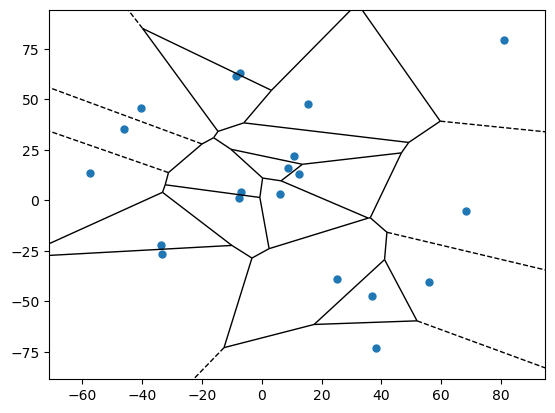

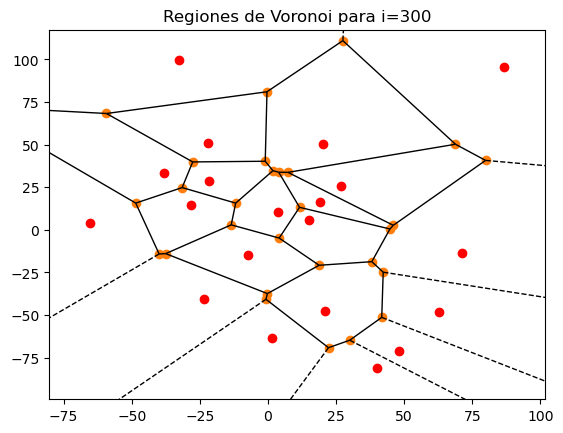

In [43]:
print("inicial es el primer gráfico, final, el segundo")
print("Las funciones objetivos de ambos son: ",objs[0],objs[-1],"respectivamente")
fig = voronoi_plot_2d(inicial,show_vertices=False,point_size=10)
plot_voronoi(vor)


Tras esto se grafican ambos considerando la distribución de casas y puntos de interés de la ciudad.

inicial


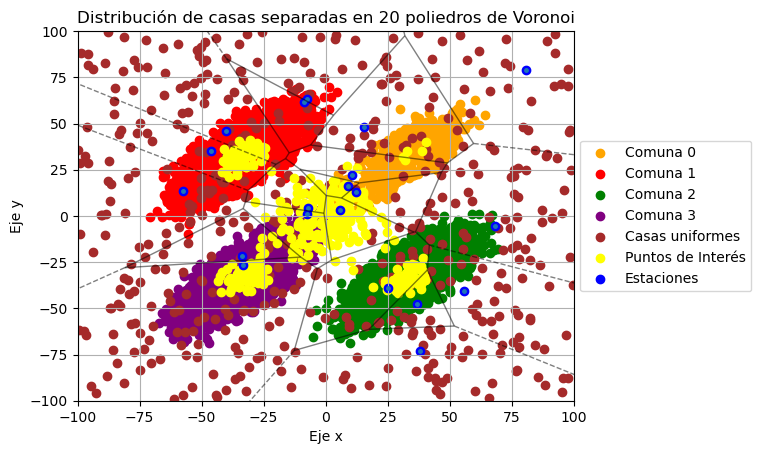

In [44]:
print("inicial")
graficar_todo(inicial,ciud_tot,puntos_de_interes)

final


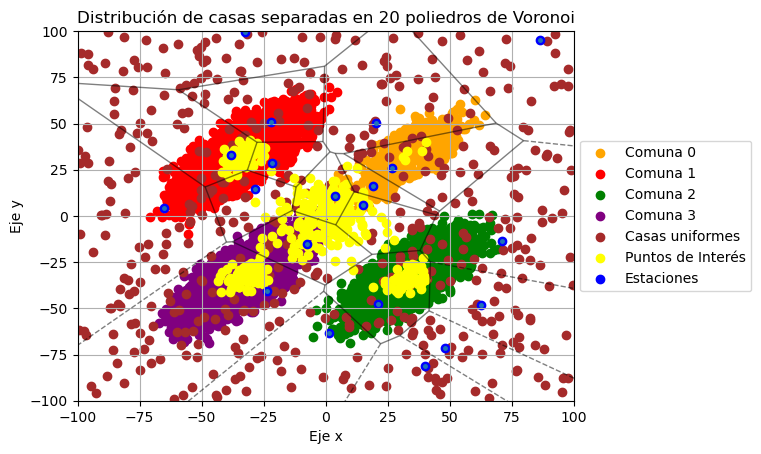

In [45]:
print("final")
graficar_todo(vor,ciud_tot,puntos_de_interes)

Finalmente, para obtener la ruta óptima, se utilizan las funciones del laboratorio 3.

In [46]:

def distancia_ciudades(ciudades): #Calcula la distancia entre ciudades.
    D = np.zeros((N,N),dtype=float)
    for i in range(N):
        for j in range(N):
            D[i,j] = np.linalg.norm(ciudades[i]-ciudades[j])
    return D



In [47]:
from matplotlib.patches import FancyArrowPatch

def arrow(x,y,ax,n): #Una herramienta para visualizar mejor la ruta generada.
    d = len(x)//(n+1)
    ind = np.arange(d,len(x),d)
    for i in ind:
        ar = FancyArrowPatch ((x[i-1],y[i-1]),(x[i],y[i]),
                              arrowstyle='->', mutation_scale=20)
        ax.add_patch(ar)


def recorre(ciudades,sigma): #Dada una permutación de las estaciones indica el camino respectivo a dicha permutación
    N = len(ciudades)
    M = len(sigma)
    assert N == M+1
    X,Y = np.matrix.transpose(ciudades)
    W = np.zeros(N+1)
    Z = np.zeros(N+1)
    W[0] = X[0]
    Z[0] = Y[0]
    for i in range(1,N):
        W[i] = X[sigma[i-1]]
        Z[i] = Y[sigma[i-1]]
    W[N] = W[0]
    Z[N] = Z[0]
    fig, ax = plt.subplots(figsize=(10,7))
    #ciudad inicial
    ax.plot(W[0],Z[0],"X",markersize=15,linestyle = '-', label = "estación " + str(1))
    for i in range(1,N):
        ax.plot(W[i],Z[i],"o",linestyle = '-', label = "estación " + str(i+1))
    #completar el ciclo

    ax.grid()
    ax.set_xlim(-100,100)
    ax.set_ylim(-100,100)
    ax.title.set_text("Trayectoria seleccionada para " + str(N) +" estaciones")
    ax.legend(bbox_to_anchor=(1.1,1.001))
    arrow(W,Z,ax, N-1)


[[ 71.26471645 -13.58852705]
 [ 48.25690725 -71.39867265]
 [ 40.08878465 -81.36470246]
 [ 15.20838356   5.81189393]
 [ 26.90631758  25.845499  ]
 [-21.70313079  28.85119055]
 [ 21.04020056 -47.5627109 ]
 [ 86.53139093  95.32574659]
 [-28.28121233  14.68095074]
 [ -7.45383175 -14.98876862]
 [-22.03170613  51.00414058]
 [-32.49863368  99.37232608]
 [ 20.33270622  50.3342474 ]
 [ 62.59332095 -48.40570364]
 [  3.78242199  10.54661785]
 [ 19.22220016  16.28646572]
 [  1.32917245 -63.48583785]
 [-65.16804533   4.08587515]
 [-38.12263845  33.0798119 ]
 [-23.57114326 -40.63758747]]


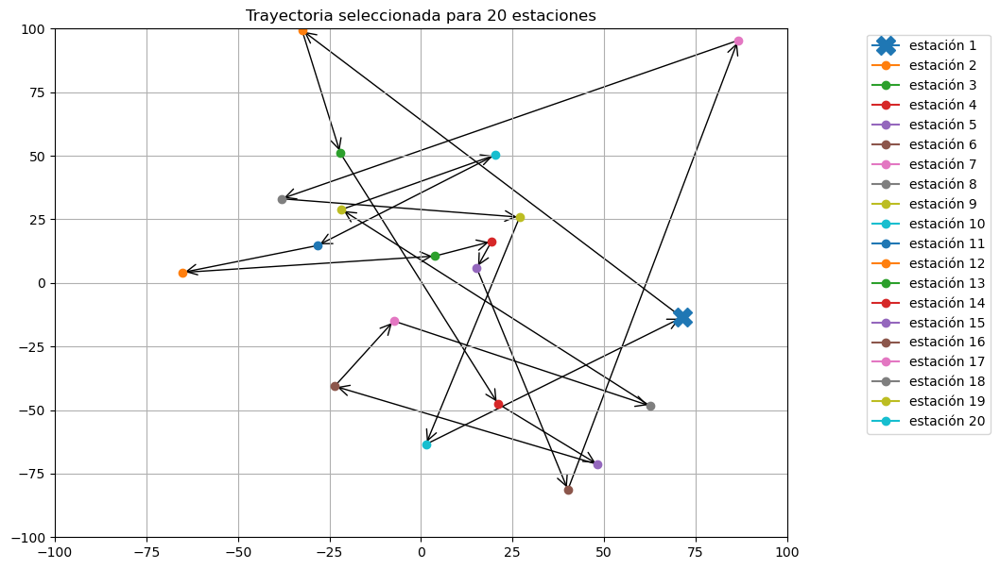

In [48]:
estaciones = vor.points
print(estaciones)
largo = len(estaciones)
sigma = np.random.permutation([i for i in range(1,largo)])
recorre(estaciones,sigma) #Para probar como se ve una ruta dada por alguna permutación.

Tras esto, se ocupa Simulated Annealing para obtener la ruta óptima.

In [49]:

N_markov = 600 #pasos de la cadena de markov
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

sigma_inicial = np.random.default_rng(seed=semilla).permutation([i for i in range(1,N)])
#osc_K(w) <= N*raiz(2), cota
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

def distancia_rec(ciudades,sigma):
    n = len(sigma)
    ciudades_ordenadas_sigma = np.zeros((n,2))
    for j in range(n):
        ciudades_ordenadas_sigma[j] = ciudades[int(sigma[j])]

    distancia =  sum(np.linalg.norm( ciudades_ordenadas_sigma[i] - ciudades_ordenadas_sigma[i+1]) for i in range(0,n-1))
    return distancia


def escoge(n,ciudades,tau,sigma, beta_n):
    osc_tau_sigma = (distancia_rec(ciudades,tau) - distancia_rec(ciudades,sigma))
    Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)
    if Cte_final == 1:
        return tau
    elif Cte_final<1:
        return sigma

def genera_beta_n_enunciado(n):
    return [np.log(i+np.e)/C for i in range(n)]

def generar_tau(sigma):
    n = len(sigma)
    a = np.random.randint(n)
    b = np.random.randint(n)
    tau = sigma.copy()
    (tau[a],tau[b]) = (tau[b],tau[a])
    return tau

def simular_cadena(N_limite, ciudades, estado_inic,beta_n):
    n = len(estado_inic)
    Cadenota = np.zeros((N_limite,n),dtype=int)
    Cadenota[0] = estado_inic
    for i in range(1,N_limite):
        beta_actual = beta_n[i]
        tau = generar_tau(Cadenota[i-1])
        Cadenota[i] = escoge(i, ciudades, tau, Cadenota[i-1],beta_actual)
    return Cadenota



matriz = simular_cadena(N_markov,estaciones,sigma_inicial,beta_n_test)


Graficamos la ruta óptima obtenida para las estaciones:

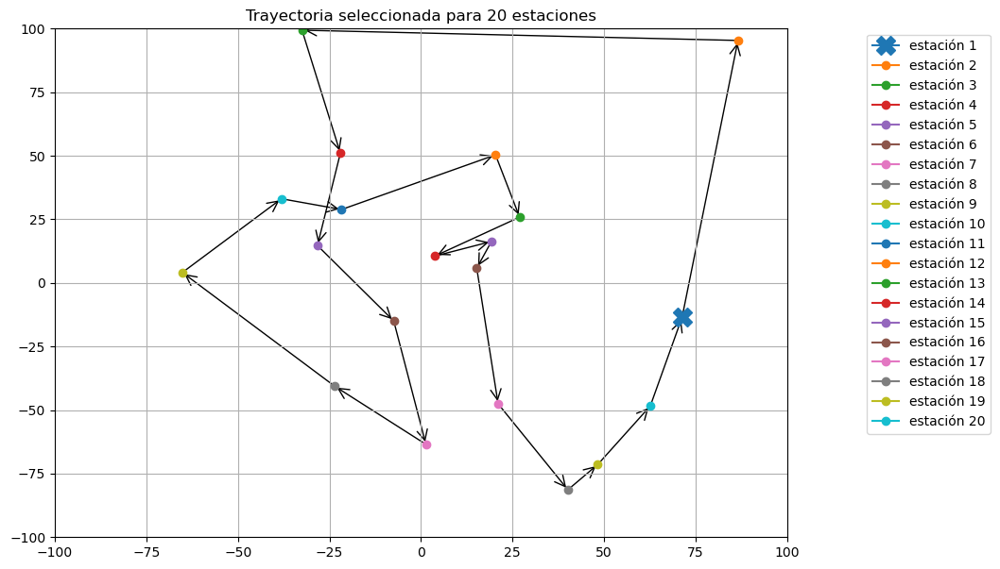

In [50]:
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Y ahora verificamos como evoluciona la cadena con un beta lineal (el ya utilizado), cuadrático y exponencial.

C:\Users\marti\AppData\Local\Temp\ipykernel_21200\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


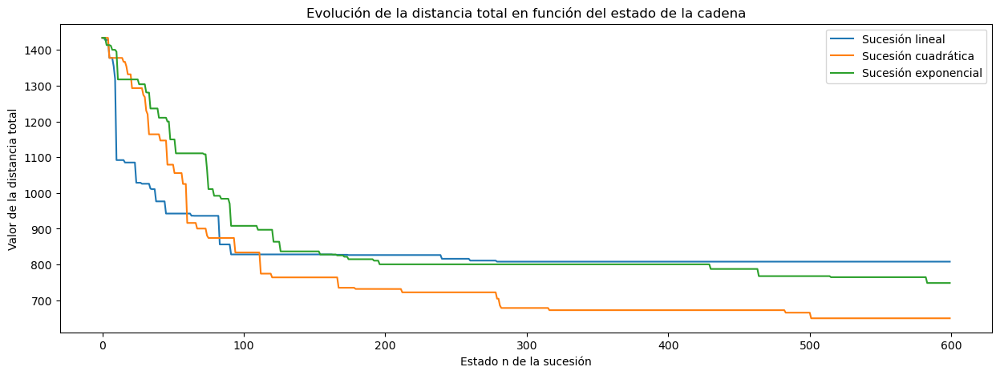

In [51]:
indices = range(N_markov)
#beta_n distintos, desde 1 hasta N (0:N-1)
betas_lineal = [i for i in indices]
betas_quadra = [i**2 for i in indices]
betas_expnen = [np.exp(i) for i in indices]


#genero las cadenas y me kedo con la última para cada beta
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_lineal)
#guardo la distancia
w_lineal = [distancia_rec(estaciones,perm) for perm in Cadena_lineal]
plt.figure(figsize=(15, 5))
plt.plot(indices,w_lineal, label="Sucesión lineal")



Cadena_quadra = simular_cadena(N_markov,estaciones,sigma_inicial,betas_quadra)
w_quadra = [distancia_rec(estaciones,perm) for perm in Cadena_quadra]
plt.plot(indices,w_quadra,label="Sucesión cuadrática")


Cadena_expnen = simular_cadena(N_markov,estaciones,sigma_inicial,betas_expnen)
w_expnen = [distancia_rec(estaciones,perm) for perm in Cadena_expnen]
plt.plot(indices,w_expnen,label="Sucesión exponencial")


plt.title("Evolución de la distancia total en función del estado de la cadena")
plt.ylabel("Valor de la distancia total")
plt.xlabel("Estado n de la sucesión")
plt.legend()
plt.show()

Escogemos el beta cuadrado

C:\Users\marti\AppData\Local\Temp\ipykernel_21200\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


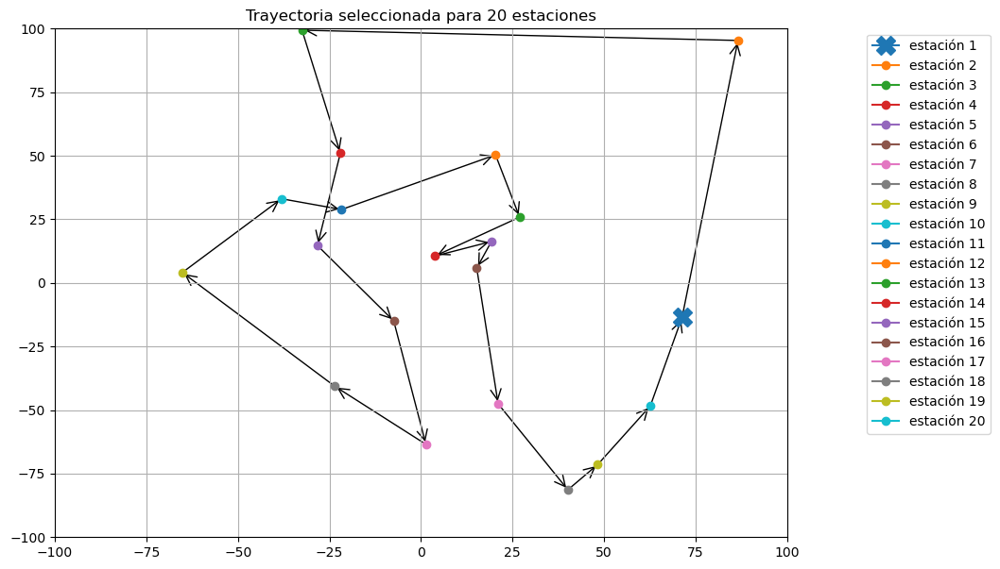

In [52]:
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_quadra)
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Obteniéndose así la ruta óptima de las estaciones encontradas, mediante un beta cuadrático.